# ICESat-2 and GEDI Analysis: Grand Mesa
David Shean  
November 22, 2021

### To do:
* acqdate - make a string from start?
* SNOTEL vs. ICESat-2 timestamps, local vs. UTC

In [2]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as cx
from matplotlib_scalebar.scalebar import ScaleBar
from astropy.time import Time
from imview.lib import pltlib

In [3]:
import matplotlib.dates as mdates

In [4]:
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

In [5]:
import rasterio as rio
from rasterio import features

In [382]:
import rioxarray

In [6]:
from rasterio.plot import show

In [7]:
import hvplot.pandas
#from holoviews.element.tiles import EsriImagery, StamenTerrain
from geoviews import opts, tile_sources as gvts

In [8]:
plt.rcParams['figure.facecolor']='w'
plt.rcParams['axes.facecolor']='w'
plt.rcParams['savefig.facecolor']='w'

In [9]:
#%matplotlib widget

In [10]:
import scipy.stats

In [11]:
def nmad(df):
    return scipy.stats.median_abs_deviation(df, nan_policy='omit', scale='normal')

def p16(df):
    return np.nanpercentile(df, 16)

def p84(df):
    return np.nanpercentile(df, 84)

def spread(df):
    return p84(df) - p16(df)

In [12]:
#Add DOY and DOWY column
def add_dowy(df, col=None):
    print("Adding Day of Water Year (DOWY)")
    if col is None:
        df['doy'] = df.index.dayofyear
        df['decyear'] = Time(df.index).decimalyear
    else:
        df['doy'] = pd.to_datetime(df[col]).dt.dayofyear
        df['decyear'] = Time(pd.to_datetime(df[col])).decimalyear
    
    #df['dowy'] = (df['doy'].index - pd.DateOffset(months=9)).dayofyear
    # Sept 30 is doy 273
    df['dowy'] = df['doy'] - 273
    df.loc[df['dowy'] <= 0, 'dowy'] += 365

In [13]:
#map_tiles = EsriImagery()
#map_tiles = StamenTerrain()
map_tiles = gvts.StamenTerrain

In [14]:
kw = {'width':500, 'height':400, 'hover':False, 'data_aspect':1, 'alpha':1.0}
kw['colorbar'] = True
kw['cmap'] = 'inferno'
#kw['s'] = 1
#kw['aggregator'] = 'mean'
#kw['rasterize'] = False
#Using datashade drops colorbar
kw['datashade'] = True
#kw['dynamic'] = True
#kw['backend'] = 'matplotlib'

In [15]:
bbox = [38.8, -108.4, 39.2, -107.7]

In [16]:
crs = 'EPSG:3857'

# Load GEDI data
See GEDI_L2A_GM notebook

In [17]:
#gedi_fn = '/nobackupp8/deshean/gedi/gm/gm_gedi_l2a_20210101.pkl'
#gedi_fn = '/nobackup/deshean/gedi/gm_20210817/gm_gedi_l2a_20210817.pkl'
gedi_fn = '/nobackup/deshean/gedi/gedi_gm_20211122/gm_gedi_l2a_20211122.pkl'
gedi_gdf = pd.read_pickle(gedi_fn)
#These are needed for plotting with hvplot due to bug with non lat/lon geometry
gedi_df = pd.DataFrame(gedi_gdf.drop(columns='geometry'))
gedi_col = 'elev_lowestmode'
gedi_title = 'GEDI L2A'
gedi_gdf.shape

(319043, 20)

In [18]:
gedi_gdf.columns

Index(['shot_number', 'delta_time', 'elev_lowestmode', 'elev_highestreturn',
       'digital_elevation_model', 'quality_flag', 'degrade_flag',
       'sensitivity', 'lat_lowestmode', 'lon_lowestmode', 'beam', 'fn',
       'decyear', 'x', 'y', 'doy', 'dowy', 'dh', 'dh_dem', 'geometry'],
      dtype='object')

In [19]:
gedi_gdf['acqdate'] = gedi_gdf.index.date
gedi_gdf['platform'] = 'GEDI'

In [20]:
gedi_gdf['acqdate'].unique()

array([datetime.date(2019, 4, 24), datetime.date(2019, 5, 1),
       datetime.date(2019, 5, 8), datetime.date(2019, 5, 15),
       datetime.date(2019, 6, 13), datetime.date(2019, 6, 16),
       datetime.date(2019, 7, 8), datetime.date(2019, 7, 12),
       datetime.date(2019, 8, 18), datetime.date(2019, 8, 21),
       datetime.date(2019, 9, 5), datetime.date(2019, 9, 9),
       datetime.date(2019, 9, 13), datetime.date(2019, 9, 24),
       datetime.date(2019, 9, 28), datetime.date(2019, 10, 1),
       datetime.date(2019, 10, 5), datetime.date(2019, 10, 20),
       datetime.date(2019, 10, 28), datetime.date(2019, 11, 12),
       datetime.date(2019, 11, 16), datetime.date(2019, 11, 20),
       datetime.date(2019, 11, 24), datetime.date(2020, 1, 16),
       datetime.date(2020, 1, 20), datetime.date(2020, 1, 31),
       datetime.date(2020, 2, 12), datetime.date(2020, 2, 20),
       datetime.date(2020, 2, 24), datetime.date(2020, 2, 28),
       datetime.date(2020, 3, 3), datetime.date(2020, 

In [21]:
gedi_gdf['beam'].value_counts()

BEAM1011    44840
BEAM0110    44225
BEAM0101    44197
BEAM1000    44053
BEAM0011    38739
BEAM0010    36994
BEAM0001    33577
BEAM0000    32418
Name: beam, dtype: int64

In [22]:
gedi_fullpower_beamlist = ['BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']

In [23]:
gedi_fullpower_idx = gedi_gdf['beam'].isin(gedi_fullpower_beamlist)

In [24]:
gedi_gdf[gedi_fullpower_idx].shape

(177315, 22)

# Load ICESat-2 ATL08 data

In [25]:
#atl08_fn = '/nobackup/deshean/icesat2/gm_atl08_20210101.pkl'
#atl08_fn = '/nobackupp18/deshean/icesat2/gm_20210817/gm_atl08_df_20210817.pkl'
atl08_fn = '/nobackup/deshean/icesat2/gm_20211122/gm_atl08_df_20211122.pkl'
atl08_gdf = pd.read_pickle(atl08_fn)
atl08_df = pd.DataFrame(atl08_gdf.drop(columns='geometry'))
atl08_col = 'h_te_best_fit'
atl08_title = 'ICESat-2 ATL08'
atl08_gdf.shape

(91906, 36)

In [26]:
atl08_gdf['acqdate'] = atl08_gdf.index.date
atl08_gdf['platform'] = 'ICESat-2'

In [27]:
atl08_gdf['acqdate'].unique()

array([datetime.date(2018, 10, 17), datetime.date(2018, 11, 14),
       datetime.date(2018, 11, 15), datetime.date(2018, 12, 13),
       datetime.date(2018, 12, 14), datetime.date(2019, 1, 11),
       datetime.date(2019, 2, 13), datetime.date(2019, 3, 14),
       datetime.date(2019, 3, 15), datetime.date(2019, 4, 12),
       datetime.date(2019, 5, 15), datetime.date(2019, 5, 16),
       datetime.date(2019, 6, 12), datetime.date(2019, 6, 14),
       datetime.date(2019, 7, 11), datetime.date(2019, 7, 17),
       datetime.date(2019, 8, 9), datetime.date(2019, 9, 11),
       datetime.date(2019, 9, 13), datetime.date(2019, 10, 10),
       datetime.date(2019, 11, 12), datetime.date(2019, 11, 14),
       datetime.date(2019, 12, 11), datetime.date(2020, 1, 9),
       datetime.date(2020, 1, 15), datetime.date(2020, 2, 11),
       datetime.date(2020, 2, 12), datetime.date(2020, 3, 11),
       datetime.date(2020, 3, 12), datetime.date(2020, 4, 9),
       datetime.date(2020, 4, 10), datetime.date(

In [28]:
atl08_gdf.columns

Index(['segment_id_beg', 'segment_id_end', 'delta_time', 'latitude',
       'longitude', 'brightness_flag', 'layer_flag', 'msw_flag', 'night_flag',
       'terrain_flg', 'urban_flag', 'segment_landcover', 'segment_snowcover',
       'segment_watermask', 'h_te_best_fit', 'h_te_uncertainty',
       'terrain_slope', 'n_te_photons', 'h_canopy', 'h_canopy_uncertainty',
       'canopy_flag', 'n_ca_photons', 'rgt', 'cycle', 'groundtrack_id',
       'atlas_spot_number', 'atlas_beam_type', 'sc_orientation',
       'atmosphere_profile', 'atlas_pce', 'decyear', 'x', 'y', 'doy', 'dowy',
       'geometry', 'acqdate', 'platform'],
      dtype='object')

In [29]:
atl08_gdf['atlas_beam_type'].value_counts()

strong    49996
weak      41910
Name: atlas_beam_type, dtype: int64

In [30]:
atl08_fullpower_idx = atl08_gdf['atlas_beam_type'] == 'strong'

In [31]:
atl08_gdf[atl08_fullpower_idx].describe()

,segment_id_beg,segment_id_end,delta_time,latitude,longitude,brightness_flag,layer_flag,msw_flag,night_flag,terrain_flg,...,n_te_photons,h_canopy,h_canopy_uncertainty,canopy_flag,n_ca_photons,decyear,x,y,doy,dowy
count,49996.000000,49996.000000,4.999600e+04,49996.000000,49996.000000,49996.000000,49996.000000,49996.000000,49996.000000,49996.000000,...,49996.000000,41077.000000,37843.000000,49996.0,49996.000000,49996.000000,4.999600e+04,4.999600e+04,49996.000000,49996.000000
mean,491481.468217,491485.457797,7.175007e+07,39.000504,-108.046555,0.081687,0.468737,0.471758,0.428114,0.748840,...,222.299764,12.282995,26.923100,1.0,107.560305,2020.274042,-1.202769e+07,4.721758e+06,185.361649,171.517781
std,284367.025513,284367.027387,2.480301e+07,0.115603,0.189179,0.273889,0.499027,0.601746,0.494810,0.433685,...,233.036678,8.811694,31.420439,0.0,93.759954,0.785454,2.105932e+04,1.655943e+04,104.257932,98.691000
min,215194.000000,215198.000000,2.505068e+07,38.800003,-108.399994,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,1.075439,1.810640,1.0,0.000000,2018.794353,-1.206703e+07,4.693064e+06,6.000000,9.000000
25%,216335.000000,216339.000000,5.359217e+07,38.901298,-108.198122,0.000000,0.000000,0.000000,0.000000,0.000000,...,59.000000,5.780640,10.189281,1.0,41.000000,2019.699398,-1.204456e+07,4.707543e+06,99.000000,74.000000
50%,217430.000000,217434.000000,7.213141e+07,38.998758,-108.036774,0.000000,0.000000,0.000000,0.000000,1.000000,...,151.000000,9.252197,17.184658,1.0,90.000000,2020.286488,-1.202660e+07,4.721494e+06,165.000000,166.000000
75%,785393.000000,785397.000000,9.282611e+07,39.101155,-107.886639,0.000000,1.000000,1.000000,1.000000,1.000000,...,300.000000,17.766846,31.482765,1.0,149.000000,2020.940920,-1.200989e+07,4.736172e+06,283.000000,255.000000
max,786608.000000,786612.000000,1.113654e+08,39.199986,-107.700005,1.000000,1.000000,4.000000,1.000000,1.000000,...,2276.000000,147.564941,634.060486,1.0,856.000000,2021.528634,-1.198911e+07,4.750358e+06,348.000000,348.000000


# Load SlideRule
Run 11/29/21 for GM polygon, 40 m, ground, other defaults

In [32]:
atl06sr_fn = 'ATL06-SR_20211129100942_004.pkl'
atl06sr_gdf_ll = pd.read_pickle(atl06sr_fn)
#atl06sr_df_ll = pd.DataFrame(atl06sr_gdf_ll.drop(columns='geometry'))
atl06sr_col = 'h_mean'
atl06sr_title = 'ICESat-2 ATL06-SR 40m (ground)'
atl06sr_gdf_ll.shape

(334079, 16)

In [33]:
print("Resetting index and sorting")
atl06sr_gdf_ll.index.names = ['utc']
#Some of the SlideRule output may still not be sorted monotonically
atl06sr_gdf_ll.sort_index(inplace=True)

Resetting index and sorting


In [34]:
atl06sr_gdf_ll['acqdate'] = atl06sr_gdf_ll.index.date
#atl08_gdf['platform'] = 'ICESat-2'

In [35]:
atl06sr_gdf_ll.columns

Index(['geometry', 'cycle', 'delta_time', 'dh_fit_dx', 'dh_fit_dy', 'distance',
       'gt', 'h_mean', 'h_sigma', 'n_fit_photons', 'pflags', 'rgt',
       'rms_misfit', 'segment_id', 'spot', 'w_surface_window_final',
       'acqdate'],
      dtype='object')

In [36]:
#Clip to extent
atl06sr_gdf_ll = atl06sr_gdf_ll.cx[bbox[1]:bbox[3], bbox[0]:bbox[2]]

In [37]:
from pyproj import Transformer
def add_xy(df, crs='EPSG:3857'):
    #Add x and y coords in web mercator (for now)
    transformer = Transformer.from_crs("EPSG:4326", crs)
    print("Reprojecting to %s" % crs)
    df['x'], df['y'] = transformer.transform(df['lat'].values, df['lon'].values)

In [38]:
#atl06sr_gdf_ll.iloc[0:2].geometry.y.values

In [39]:
#Test ITRF2014
#atl06sr_gdf_ll.iloc[0:2].to_crs('EPSG:7912').geometry.y.values

In [40]:
#These are already in geometry column
#add_xy(atl06sr_gdf)
atl06sr_gdf = atl06sr_gdf_ll.to_crs('EPSG:3857')

In [41]:
atl06sr_gdf['x'] = atl06sr_gdf.geometry.x.values
atl06sr_gdf['y'] = atl06sr_gdf.geometry.x.values

In [42]:
add_dowy(atl06sr_gdf)

Adding Day of Water Year (DOWY)


In [43]:
atl06sr_gdf.head()

,geometry,cycle,delta_time,dh_fit_dx,dh_fit_dy,distance,gt,h_mean,h_sigma,n_fit_photons,...,rms_misfit,segment_id,spot,w_surface_window_final,acqdate,x,y,doy,decyear,dowy
utc,,,,,,,,,,,,,,,,,,,,,
2018-10-17 22:31:16.108217480,POINT (-12061421.323 4693498.360),1.0,2.505068e+07,0.001287,0.0,4.317599e+06,20.0,1776.780654,0.041342,35.0,...,0.178174,215294.0,1.0,3.0,2018-10-17,-1.206142e+07,-1.206142e+07,290,2018.794352,17
2018-10-17 22:31:16.111020452,POINT (-12061423.732 4693524.041),1.0,2.505068e+07,-0.012635,0.0,4.317619e+06,20.0,1776.689206,0.019998,70.0,...,0.166587,215295.0,1.0,3.0,2018-10-17,-1.206142e+07,-1.206142e+07,290,2018.794352,17
2018-10-17 22:31:16.113823968,POINT (-12061426.153 4693549.721),1.0,2.505068e+07,-0.007252,0.0,4.317639e+06,20.0,1776.517833,0.017965,92.0,...,0.171873,215296.0,1.0,3.0,2018-10-17,-1.206143e+07,-1.206143e+07,290,2018.794352,17
2018-10-17 22:31:16.116627848,POINT (-12061428.603 4693575.398),1.0,2.505068e+07,-0.008090,0.0,4.317659e+06,20.0,1776.393682,0.014747,106.0,...,0.151766,215297.0,1.0,3.0,2018-10-17,-1.206143e+07,-1.206143e+07,290,2018.794352,17
2018-10-17 22:31:16.119432980,POINT (-12061431.081 4693601.072),1.0,2.505068e+07,-0.019153,0.0,4.317679e+06,20.0,1776.108684,0.017070,97.0,...,0.162546,215298.0,1.0,3.0,2018-10-17,-1.206143e+07,-1.206143e+07,290,2018.794352,17


# Load Pleaides HR footprints
Downloaded from https://www.intelligence-airbusds.com/en/4871-geostore-ordering  
Had to deleted geometry column to load with geopandas

In [44]:
def add_centroid(df):
    df["cx"] = df.centroid.x
    df["cy"] = df.centroid.y

In [45]:
#phr_fn = 'zip:///home1/deshean/src/icesat2_notebooks/conus/export-20210102-23444294.zip!Export.shp'
phr_fn = '/home1/deshean/src/icesat2_notebooks/conus/pleaides/Export.shp'
phr_gdf_ll = gpd.read_file(phr_fn) #, GEOM_POSSIBLE_NAMES="geometry", KEEP_GEOM_COLUMNS="NO")
phr_gdf_ll['acqdate'] = pd.to_datetime(phr_gdf_ll['date']).dt.tz_convert(None)
add_dowy(phr_gdf_ll, col='acqdate')
phr_gdf = phr_gdf_ll.to_crs(atl08_gdf.crs)
phr_gdf.shape

Adding Day of Water Year (DOWY)


(5, 43)

# Load SkySat-C collect footprints
Prepared by Shashank Bhushan from CSDAP acquisitions

In [46]:
#ssc_fn = '/home1/deshean/src/icesat2_notebooks/conus/skysat_collects_till_sep17_19_CC25_merge.gpkg'
ssc_fn = '/home1/deshean/src/icesat2_notebooks/conus/skysat_collects_till_sep17_19_CC25_merge_triplet_nadir.gpkg'
ssc_gdf_ll = gpd.read_file(ssc_fn)
#Remove timezone, assume UTC
ssc_gdf_ll['acqdate'] = pd.to_datetime(ssc_gdf_ll['acquired'])#.dt.tz_convert(None)
add_dowy(ssc_gdf_ll, col='acqdate')
ssc_gdf = ssc_gdf_ll.to_crs(atl08_gdf.crs)
ssc_gdf.shape

Adding Day of Water Year (DOWY)


(149, 32)

<AxesSubplot:>

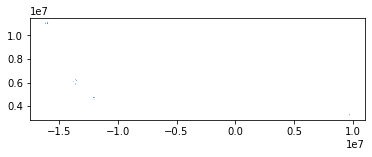

In [47]:
ssc_gdf.plot()

# Load DigitalGlobe/Maxar archive footprints
* Originally using gdb prepared by Claire Porter at PGC on 2020-10-30 with Cloudcover < 25%
* Now using geojson exported from DigitalGlobe Discover tool

In [48]:
#dg_fn = '/nobackupp8/deshean/4364_2020oct30/dg_archive_2020oct30_dg_imagery_index_stereo_CONUS.gpkg'
#dg_fn = '/home1/deshean/src/icesat2_notebooks/conus/CatalogProducts.geojson'
dg_fn = '/home1/deshean/src/icesat2_notebooks/conus/CatalogProducts_GM_stereo_20211126.geojson'

In [49]:
dg_gdf_ll = gpd.read_file(dg_fn)

In [50]:
dg_gdf_ll.shape

(58, 16)

In [51]:
#Cloudcover filter
cc = 50
#col = 'cloudcover'
col = 'cloud_pct'
dg_gdf_ll = dg_gdf_ll[dg_gdf_ll[col] <= cc]

In [52]:
dg_gdf_ll.columns

Index(['id', 'image_id', 'acq_date', 'vehicle', 'sensor', 'bands', 'cloud_pct',
       'off_nadir', 'sun_elev', 'trgt_azmth', 'gsd_max', 'gsd_min',
       'scandirect', 'hasstereo', 'browse_url', 'geometry'],
      dtype='object')

In [53]:
col = 'acqdate'
#col = 'acq_date'
dg_gdf_ll.rename(columns={'acq_date':'acqdate'}, inplace=True)
dg_gdf_ll[col] = pd.to_datetime(dg_gdf_ll[col])
add_dowy(dg_gdf_ll, col=col)

Adding Day of Water Year (DOWY)


In [54]:
dg_gdf = dg_gdf_ll.to_crs(atl08_gdf.crs)
dg_gdf.shape

(57, 19)

<AxesSubplot:>

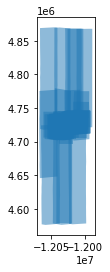

In [55]:
dg_gdf.plot(alpha=0.5)

In [56]:
#dg_gdf.area/1E6

## Grand Mesa polygon (for cropping)
Quickly drawn by hand

In [57]:
#Smaller region for faster processing
gm_poly = '/home1/deshean/src/icesat2_notebooks/conus/grandmesa_poly.geojson'
#Larger region, includes all of ASO
gm_poly = '/home1/deshean/src/sliderule-python/examples/grandmesa.geojson'

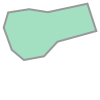

In [58]:
gm_ll = gpd.read_file(gm_poly)
gm_ll.iloc[0].geometry

In [59]:
gm = gm_ll.to_crs(gedi_gdf.crs)
gm

,geometry
0,"POLYGON ((-12057201.350 4741397.423, -12060482..."


## ASO data
* Note: none of these are tiled or compressed!

In [60]:
aso_dir = '/nobackupp8/deshean/data/ASO'
aso_dir = '/nobackup/deshean/aso'
aso_dir = '/nobackup/deshean/p8_recovered/deshean/data/ASO'
aso_fn_list = !ls $aso_dir/ASO*SD*[0-9].tif $aso_dir/ASO*DTM*[0-9].tif
aso_fn_list

['/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_PCDTM_USCOGM_20160926_20160926.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170208.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170216.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170220.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170221.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170225.tif']

## Prepare polygon masks around valid data

Load a reduced resolution overview for processing  
Assumes overviews have already been generated with `gdaladdo -r gauss`

In [61]:
aso_feat_list = []
ovr_scale = 8
dt_fieldnum = 4
for fn in aso_fn_list:
    src = rio.open(fn)
    a = src.read(1, masked=True, out_shape=(src.count, int(src.height / ovr_scale), int(src.width / ovr_scale)))
    ovr_transform = src.transform * src.transform.scale(src.width / a.shape[-1], src.height / a.shape[-2])
    mask = np.ma.getmaskarray(a).astype(np.uint8) - 1
    shapes = features.shapes(mask, mask=mask, transform=ovr_transform)
    geom_list = list(shapes)
    dt = os.path.splitext(os.path.split(fn)[-1])[0].split('_')[dt_fieldnum]
    aso_feat_list.extend([{'properties':{'fn':fn, 'date':dt}, 'geometry':i[0]} for i in geom_list])

In [62]:
aso_gdf = gpd.GeoDataFrame.from_features(aso_feat_list, crs=src.crs)
aso_gdf = aso_gdf.to_crs(crs)

<AxesSubplot:>

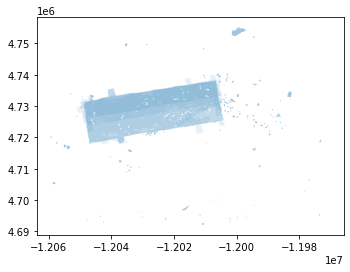

In [63]:
aso_gdf.plot(alpha=0.1)

In [64]:
#remove tiny polygons
area_thresh = 1e8
aso_gdf = aso_gdf.loc[aso_gdf.area > area_thresh]

<AxesSubplot:>

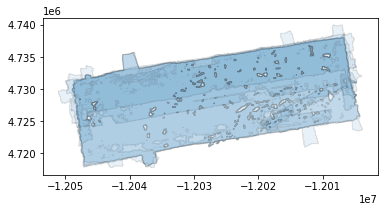

In [65]:
aso_gdf.plot(alpha=0.1, edgecolor='k', legend=True)

In [66]:
#Shoud simplify and sieve
#aso.geometry.simplify(tolerance=100)

In [67]:
aso_gdf['date'] = pd.to_datetime(aso_gdf['date'])

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [68]:
add_dowy(aso_gdf, col='date')

Adding Day of Water Year (DOWY)


/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [69]:
aso_gdf['platform'] = 'ASO'
aso_gdf['acqdate'] = aso_gdf['date']

In [70]:
aso_gdf.set_index('date', inplace=True)

In [71]:
aso_gdf

,geometry,fn,doy,decyear,dowy,platform,acqdate
date,,,,,,,
2016-09-26,"POLYGON ((-12015160.592 4739071.493, -12014975...",/nobackup/deshean/p8_recovered/deshean/data/AS...,270,2016.734973,362,ASO,2016-09-26
2017-02-08,"POLYGON ((-12006926.162 4738034.310, -12006771...",/nobackup/deshean/p8_recovered/deshean/data/AS...,39,2017.104110,131,ASO,2017-02-08
2017-02-16,"POLYGON ((-12006924.216 4737972.309, -12006800...",/nobackup/deshean/p8_recovered/deshean/data/AS...,47,2017.126027,139,ASO,2017-02-16
2017-02-20,"POLYGON ((-12007497.441 4738512.728, -12007312...",/nobackup/deshean/p8_recovered/deshean/data/AS...,51,2017.136986,143,ASO,2017-02-20
2017-02-21,"POLYGON ((-12008378.907 4740005.456, -12008286...",/nobackup/deshean/p8_recovered/deshean/data/AS...,52,2017.139726,144,ASO,2017-02-21
2017-02-25,"POLYGON ((-12006670.686 4738756.138, -12006578...",/nobackup/deshean/p8_recovered/deshean/data/AS...,56,2017.150685,148,ASO,2017-02-25


In [72]:
aso_gdf.to_crs('EPSG:32613').area/1E6

date
2016-09-26    352.482525
2017-02-08    326.226773
2017-02-16    334.510197
2017-02-20    207.808897
2017-02-21    147.586504
2017-02-25    312.943786
dtype: float64

In [73]:
aso_gdf.area/1E6

date
2016-09-26    584.663827
2017-02-08    541.139845
2017-02-16    554.862737
2017-02-20    344.875828
2017-02-21    244.993699
2017-02-25    519.089148
dtype: float64

<AxesSubplot:>

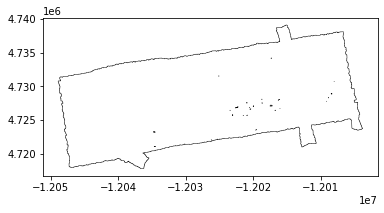

In [74]:
aso_gdf.iloc[0:1].plot(facecolor='None', edgecolor='k', lw=0.5)

In [75]:
#This is Web Mercator
aso_snowoff_extent = aso_gdf.iloc[0:1].total_bounds
aso_snowoff_extent

array([-12048889.42875172,   4717791.41674089, -12003774.31569637,
         4739077.50517919])

## Additional spatial filter

In [76]:
def latlon_filter(df, bbox, xcol='longitude', ycol='latitude'):
    #idx = (df[ycol] >= bbox[1]) & (df[ycol] <= bbox[3]) & (df[xcol] >= bbox[0]) & (df[xcol] <= bbox[2])
    #return df.loc[idx]
    #cx expects xmin:xmax, ymin:ymax
    return df.cx[bbox[1]:bbox[3], bbox[0]:bbox[2]]

In [77]:
#bbox = [-68, -21.1, -66.9, -19.4]
#bbox = [-108.4, 38.8, -107.7, 39.2]

In [78]:
dg_gdf.shape

(57, 19)

In [79]:
#print(dg_gdf_ll.shape)
#dg_gdf = latlon_filter(dg_gdf_ll, bbox).to_crs(atl08_gdf.crs)
#print(dg_gdf.shape)

In [80]:
#col = 'catalogid'
col = 'image_id'
id_list = list(dg_gdf[col].values)
print(*id_list)

10300100C3D79000 10500100264BFE00 10500100264BFD00 10300100C3AE8800 10400100683C7400 10300100BE816B00 10200100B3680A00 1040010069AEC900 10400100683C7400 1040010068B9E400 10300100B0977C00 10300100AD821D00 102001009A610100 10200100933F1600 103001009B221100 104001005361D300 10400100513D2400 104001005112ED00 103001008F451B00 103001008F341200 103001008D0E6500 1040010048434C00 103001008964A200 103001008638ED00 103001008A695F00 1030010083CDBC00 1030010083694600 1030010082C64D00 1020010079B48800 1020010076A33A00 1030010082251300 10200100759E8000 1030010080162200 1030010081C47300 1020010072477200 103001007E1D2200 103001007CC9ED00 103001007D1E6F00 103001007B72C900 1030010079C6C800 103001007B7C1F00 103001007A5E3900 103001007A0DBD00 104001002991D700 104001002A11DB00 104001002AD19E00 1040010029504500 1040010029817600 1040010028192C00 1040010026C28A00 10400100287A5300 1040010027735900 10400100224EBF00 10400100220E3600 10400100223B3500 1040010022702400 10200100407B3000


In [81]:
print(id_list)

['10300100C3D79000', '10500100264BFE00', '10500100264BFD00', '10300100C3AE8800', '10400100683C7400', '10300100BE816B00', '10200100B3680A00', '1040010069AEC900', '10400100683C7400', '1040010068B9E400', '10300100B0977C00', '10300100AD821D00', '102001009A610100', '10200100933F1600', '103001009B221100', '104001005361D300', '10400100513D2400', '104001005112ED00', '103001008F451B00', '103001008F341200', '103001008D0E6500', '1040010048434C00', '103001008964A200', '103001008638ED00', '103001008A695F00', '1030010083CDBC00', '1030010083694600', '1030010082C64D00', '1020010079B48800', '1020010076A33A00', '1030010082251300', '10200100759E8000', '1030010080162200', '1030010081C47300', '1020010072477200', '103001007E1D2200', '103001007CC9ED00', '103001007D1E6F00', '103001007B72C900', '1030010079C6C800', '103001007B7C1F00', '103001007A5E3900', '103001007A0DBD00', '104001002991D700', '104001002A11DB00', '104001002AD19E00', '1040010029504500', '1040010029817600', '1040010028192C00', '1040010026C28A00',

In [82]:
print(ssc_gdf_ll.shape)
ssc_gdf = latlon_filter(ssc_gdf_ll, bbox).to_crs(atl08_gdf.crs)
print(ssc_gdf.shape)

(149, 32)
(46, 32)


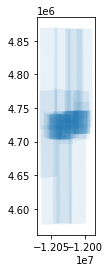

In [83]:
dg_gdf.plot(alpha=0.1);

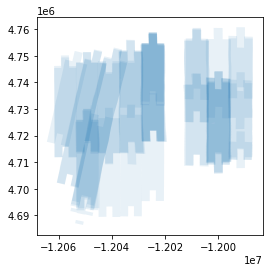

In [84]:
ssc_gdf.plot(alpha=0.1);

# Quick holoviews plot for interactive viewing

In [85]:
#map_tiles * gedi_df[::10].hvplot.scatter(x='x', y='y', c=gedi_col, title='%s: %s' % (gedi_title, gedi_col), **kw)

In [86]:
#map_tiles * atl08_df[::10].hvplot.scatter(x='x', y='y', c=atl08_col, title='%s: %s' % (atl08_title, atl08_col), **kw)
#gedi_gdf_poly_ll.hvplot(geo=True, **kw)
#map_tiles * gedi_gdf_poly_ll.hvplot(geo=True, c=gedi_col, title='%s: %s' % (gedi_title, gedi_col), **kw)

In [87]:
#Should figure out how to scale marker sizes for approximate footprint dimensions, or create buffered polygon around each point with appropriate diameter

In [88]:
basemap = cx.providers.NASAGIBS.ModisTerraTrueColorCR
basemap.update({'time':"2019-03-15"})

In [89]:
basemap = cx.providers.Stamen.Terrain

In [302]:
#clouds of GM in this mosaic
#basemap = cx.providers.Esri.WorldImagery

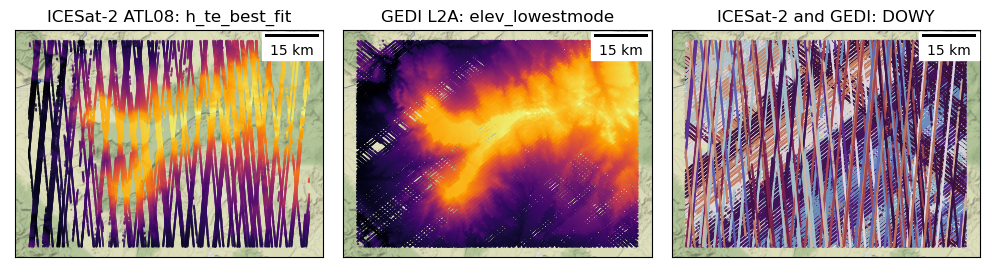

In [77]:
f, axa = plt.subplots(1,3, sharex=True, sharey=True, figsize=(10,3), dpi=100)
s=0.05
#legend_kwds={"label":atl08_col}
atl08_gdf.plot(ax=axa[0], column=atl08_col, cmap='inferno', s=s)
axa[0].set_title('{}: {}'.format(atl08_title, atl08_col))
gedi_gdf.plot(ax=axa[1], column=gedi_col, cmap='inferno', s=s)
axa[1].set_title('{}: {}'.format(gedi_title, gedi_col))
gedi_gdf.plot(ax=axa[2], column='dowy', cmap='twilight', s=s)
axa[2].set_title('ICESat-2 and GEDI: DOWY')
atl08_gdf.plot(ax=axa[2], column='dowy', cmap='twilight', s=s)
for ax in axa:
    pltlib.hide_ticks(ax)
    ax.add_artist(ScaleBar(1))
    cx.add_basemap(ax, attribution=False, crs=gedi_gdf.crs.to_string(), source=basemap)
plt.tight_layout()

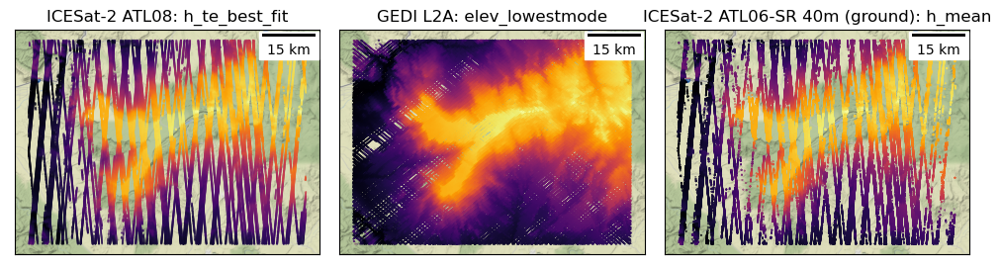

In [126]:
f, axa = plt.subplots(1,3, sharex=True, sharey=True, figsize=(10,3), dpi=100)
s=0.05
#legend_kwds={"label":atl08_col}
atl08_gdf.plot(ax=axa[0], column=atl08_col, cmap='inferno', s=s)
axa[0].set_title('{}: {}'.format(atl08_title, atl08_col))
gedi_gdf.plot(ax=axa[1], column=gedi_col, cmap='inferno', s=s)
axa[1].set_title('{}: {}'.format(gedi_title, gedi_col))
atl06sr_gdf.plot(ax=axa[2], column=atl06sr_col, cmap='inferno', s=s)
axa[2].set_title('{}: {}'.format(atl06sr_title, atl06sr_col))
for ax in axa:
    pltlib.hide_ticks(ax)
    ax.add_artist(ScaleBar(1))
    cx.add_basemap(ax, attribution=False, crs=gedi_gdf.crs.to_string(), source=basemap)
plt.tight_layout()

In [90]:
xlim = tuple(gedi_gdf.total_bounds[[0,2]])
ylim = tuple(gedi_gdf.total_bounds[[1,3]])

# DG browse images

In [91]:
dg_browse_dir = '/home1/deshean/src/icesat2_notebooks/conus/dg_browse'

In [92]:
fn_list = !ls $dg_browse_dir/*tif
fn_list

['/home1/deshean/src/icesat2_notebooks/conus/dg_browse/20190326_104001004918EB00.tif',
 '/home1/deshean/src/icesat2_notebooks/conus/dg_browse/20190328_103001008D0E6500.tif',
 '/home1/deshean/src/icesat2_notebooks/conus/dg_browse/20190328_103001008F341200.tif',
 '/home1/deshean/src/icesat2_notebooks/conus/dg_browse/20190328_103001008F451B00.tif']

In [93]:
!gdalbuildvrt -resolution highest -vrtnodata 0 $dg_browse_dir/GM_20190328_dg_browse.vrt $dg_browse_dir/*tif
!gdalwarp -overwrite -of VRT -t_srs $crs $dg_browse_dir/GM_20190328_dg_browse.vrt $dg_browse_dir/GM_20190328_dg_browse_3857.vrt

0...10...20...30...40...50...60...70...80...90...100 - done.
Creating output file that is 3529P x 2552L.
Processing /home1/deshean/src/icesat2_notebooks/conus/dg_browse/GM_20190328_dg_browse.vrt [1/1] : 0Using internal nodata values (e.g. 0) for image /home1/deshean/src/icesat2_notebooks/conus/dg_browse/GM_20190328_dg_browse.vrt.
Copying nodata values from source /home1/deshean/src/icesat2_notebooks/conus/dg_browse/GM_20190328_dg_browse.vrt to destination /home1/deshean/src/icesat2_notebooks/conus/dg_browse/GM_20190328_dg_browse_3857.vrt.
...10...20...30...40...50...60...70...80...90...100 - done.


(15.023949721980324, 15.023949721980324)
(14.896808882218952, 14.896808882218952)
(14.937684580583573, 14.937684580583573)
(14.90935716371811, 14.90935716371811)


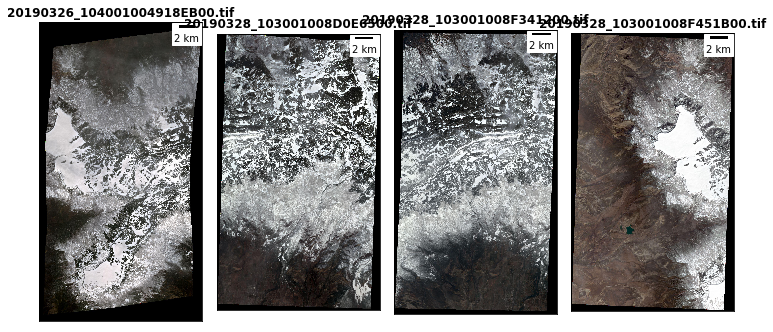

In [94]:
f, axa = plt.subplots(1, len(fn_list), figsize=(10,10), dpi=72)
#f, axa = plt.subplots(1, len(fn_list), sharex=True, sharey=True, figsize=(10,10), dpi=72)
for i, fn in enumerate(fn_list):
    src = rio.open(fn)
    print(src.res)
    dg_kw = {}
    dg_kw['alpha'] = 1.0
    dg_kw['interpolation'] = 'none'
    if src.count == 1:
        dg_kw['cmap'] = 'gray'
    show(src, ax=axa[i], title=os.path.split(fn)[-1], **dg_kw)
    axa[i].add_artist(ScaleBar(1))
    pltlib.hide_ticks(axa[i])
plt.tight_layout()

(14.90935716371811, 14.90935716371811)


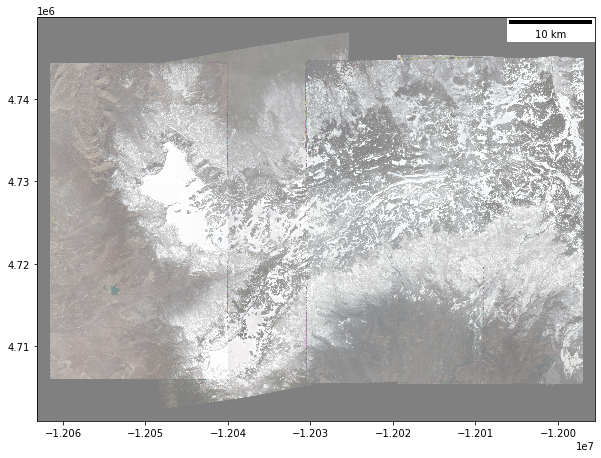

In [95]:
f, ax = plt.subplots(figsize=(10,10), dpi=72)
fn = dg_browse_dir + '/GM_20190328_dg_browse_3857.vrt'
dg_src = rio.open(fn)
print(src.res)
dg_kw = {}
dg_kw['alpha'] = 0.5
dg_kw['interpolation'] = 'none'
if dg_src.count == 1:
    dg_kw['cmap'] = 'gray'
show(dg_src, ax=ax, **dg_kw)
ax.add_artist(ScaleBar(1))
#plt.tight_layout()

# Temporal filters
Can do range within single year or multiple dates

In [96]:
print(atl08_gdf.index.min(), atl08_gdf.index.max())
print(gedi_gdf.index.min(), gedi_gdf.index.max())

2018-10-17 22:31:52.843000 2021-07-12 22:49:58.307000
2019-04-24 22:04:10.320000 2021-07-31 23:17:25.831000


In [97]:
year = 2019
dt_min = '{}-01-01'.format(year)
#dt_max = '{}-05-31'.format(year)
#dt_min = '{}-07-01'.format(year)
#dt_max = '{}-09-30'.format(year)
#dt_min = '{}-11-01'.format(year)
dt_max = '{}-12-31'.format(year)

In [98]:
dt_min = '2016-06-01'
#dt_min = '2018-10-03' #First light ICESat-2
dt_max = '2021-08-01'

In [128]:
print(gedi_gdf.shape)
print(atl08_gdf.shape)
print(atl06sr_gdf.shape)

(319043, 22)
(91906, 38)
(245144, 22)


In [129]:
#gedi = gedi_gdf.loc[dt_min:dt_max]
gedi = gedi_gdf
print(gedi.shape)
#atl08 = atl08_gdf.loc[dt_min:dt_max]
atl08 = atl08_gdf
print(atl08.shape)
#atl06sr = atl06sr_gdf.loc[dt_min:dt_max]
atl06sr = atl06sr_gdf
print(atl06sr.shape)

(319043, 22)
(91906, 38)
(245144, 22)


In [130]:
aso_idx = (aso_gdf['acqdate'] >= pd.to_datetime(dt_min)) & (aso_gdf['acqdate'] <= pd.to_datetime(dt_max))
aso = aso_gdf.loc[aso_idx]
print(aso.shape)

(6, 7)


In [131]:
dg_idx = (dg_gdf['acqdate'] >= pd.to_datetime(dt_min)) & (dg_gdf['acqdate'] <= pd.to_datetime(dt_max))
dg = dg_gdf.loc[dg_idx]
print(dg.shape)
ssc_idx = (ssc_gdf['acqdate'] >= pd.to_datetime(dt_min)) & (ssc_gdf['acqdate'] <= pd.to_datetime(dt_max))
ssc = ssc_gdf.loc[ssc_idx]
print(ssc.shape)
phr_idx = (phr_gdf['acqdate'] >= pd.to_datetime(dt_min)) & (phr_gdf['acqdate'] <= pd.to_datetime(dt_max))
phr = phr_gdf.loc[phr_idx]
print(phr.shape)

(52, 19)
(46, 32)
(5, 43)


In [132]:
#c = 'decyear'
#c = 'acqdate'
#c = 'doy'
c = 'dowy'
#clim = (min(atl08[c].min(), gedi[c].min(), dg[c].min()), max(atl08[c].max(), gedi[c].max(), dg[c].max()))
clim = (1,366)

f, ax = plt.subplots(figsize=(10,6))
shared_kw = {'cmap':'twilight', 'column':c, 'vmin':clim[0], 'vmax':clim[1], 'markersize':1, 'lw':0.5}
ax.ticklabel_format(useOffset=False, style='plain')
gedi.plot(ax=ax, label=gedi_title, legend=True, legend_kwds={"label":c}, zorder=5, **shared_kw) #edgecolor='g', 
atl08.plot(ax=ax, label=atl08_title, marker='^', zorder=6, **shared_kw) #edgecolor='b', 
#aso.plot(ax=ax, label='ASO', alpha=alpha, edgecolor='k', zorder=4, **shared_kw)
#ax.autoscale(enable=False)
alpha=0.1
#dg.plot(ax=ax, label='DG stereo', alpha=alpha, edgecolor='k', zorder=3, **shared_kw)
#phr.plot(ax=ax, label='PHR stereo', alpha=alpha, edgecolor='k', zorder=2, **shared_kw)
#ssc.plot(ax=ax, label='SkySat-C stereo', alpha=alpha, edgecolor='k', zorder=1, **shared_kw)
#cx.add_basemap(ax, crs=gedi_gdf_poly.crs.to_string(), source=cx.providers.Stamen.Terrain)
#cx.add_basemap(ax, attribution=False, crs=gedi_gdf.crs.to_string(), source=basemap)
show(dg_src, ax=ax, **kw)
ax.add_artist(ScaleBar(1))
ax.set_xlim(*xlim)
ax.set_ylim(*ylim)
l = ax.legend(loc='lower right')
l.set_zorder(99)
ax.set_title('{} to {}'.format(dt_min, dt_max))
pltlib.hide_ticks(ax)
#plt.tight_layout()

In [133]:
#%matplotlib widget

In [ ]:
f, ax = plt.subplots(figsize=(10,6))
c='decyear'
shared_kw = {'cmap':'inferno', 'column':c, 'markersize':1, 'lw':0.5}
#shared_kw = {'cmap':'twilight', 'column':c, 'vmin':clim[0], 'vmax':clim[1], 'markersize':1, 'lw':0.5}
ax.ticklabel_format(useOffset=False, style='plain')
#gedi.plot(ax=ax, label=gedi_title, legend=True, legend_kwds={"label":c}, zorder=5, **shared_kw) #edgecolor='g', 
atl08.plot(ax=ax, label=atl08_title, marker='^', zorder=6, legend=True, legend_kwds={"label":c}, **shared_kw) #edgecolor='b', 
alpha=0.2
#aso.plot(ax=ax, label='ASO', alpha=alpha, edgecolor='k', zorder=4, **shared_kw)
#ax.autoscale(enable=False)
#dg.plot(ax=ax, label='DG stereo', legend=True, legend_kwds={"label":c}, alpha=alpha, edgecolor='k', zorder=3, **shared_kw)
#phr.plot(ax=ax, label='PHR stereo', alpha=alpha, edgecolor='k', zorder=2, **shared_kw)
ssc.plot(ax=ax, label='SkySat-C stereo', alpha=alpha, edgecolor='k', zorder=1, **shared_kw)
#cx.add_basemap(ax, crs=gedi_gdf_poly.crs.to_string(), source=cx.providers.Stamen.Terrain)
cx.add_basemap(ax, attribution=False, crs=gedi_gdf.crs.to_string(), source=basemap)
ax.add_artist(ScaleBar(1))
ax.set_xlim(*xlim)
ax.set_ylim(*ylim)
l = ax.legend(loc='lower right')
l.set_zorder(99)
ax.set_title('{} to {}'.format(dt_min, dt_max))
pltlib.hide_ticks(ax)
#plt.tight_layout()

## Get SNOTEL for same date range and add to time series

In [134]:
#Install directly from github repo main branch
#%pip install -q git+https://github.com/ulmo-dev/ulmo.git
#!conda install -y ulmo

In [135]:
#Despite warning, shouldn't need to restart kernel if all goes well with pip install
import ulmo

In [136]:
#This is the latest CUAHSI API endpoint
#http://his.cuahsi.org/wofws.html
wsdlurl = 'https://hydroportal.cuahsi.org/Snotel/cuahsi_1_1.asmx?WSDL'

In [137]:
sitecode_list = ['SNOTEL:682_CO_SNTL', 'SNOTEL:622_CO_SNTL']

In [138]:
#Daily SWE
#variablecode = 'SNOTEL:WTEQ_D'
#Daily snow depth
variablecode = 'SNOTEL:SNWD_D'

In [139]:
#Get current datetime
from datetime import datetime
today = datetime.today().strftime('%Y-%m-%d')

def snotel_fetch(sitecode, variablecode='SNOTEL:SNWD_D', start_date='1950-10-01', end_date=today):
    #print(sitecode, variablecode, start_date, end_date)
    values_df = None
    try:
        #Request data from the server
        site_values = ulmo.cuahsi.wof.get_values(wsdlurl, sitecode, variablecode, start=start_date, end=end_date)
        #Convert to a Pandas DataFrame   
        values_df = pd.DataFrame.from_dict(site_values['values'])
        #Parse the datetime values to Pandas Timestamp objects
        values_df['datetime'] = pd.to_datetime(values_df['datetime'], utc=True)
        #Set the DataFrame index to the Timestamps
        values_df = values_df.set_index('datetime')
        #Convert values to float and replace -9999 nodata values with NaN
        values_df['value'] = pd.to_numeric(values_df['value']).replace(-9999, np.nan)
        #Remove any records flagged with lower quality
        values_df = values_df[values_df['quality_control_level_code'] == '1']
    except:
        print("Unable to fetch %s" % variablecode)

    return values_df

In [140]:
#site_values = ulmo.cuahsi.wof.get_values(wsdlurl, sitecode, variablecode)

In [141]:
#Define an empty dictionary to store returns for each site
value_dict = {}
for i, sitecode in enumerate(sitecode_list):
    print('%i of %i sites: %s' % (i+1, len(sitecode_list), sitecode))
    out = snotel_fetch(sitecode, variablecode, dt_min, dt_max)
    #out = snotel_fetch(sitecode, variablecode)
    if out is not None:
        value_dict[sitecode] = out['value']
#Convert the dictionary to a DataFrame, automatically handles different datetime ranges (nice!)
snotel_df = pd.DataFrame.from_dict(value_dict)

1 of 2 sites: SNOTEL:682_CO_SNTL
2 of 2 sites: SNOTEL:622_CO_SNTL


In [142]:
snotel_df

,SNOTEL:682_CO_SNTL,SNOTEL:622_CO_SNTL
datetime,,
2016-06-01 00:00:00+00:00,37,15
2016-06-02 00:00:00+00:00,35,12
2016-06-03 00:00:00+00:00,32,9
2016-06-04 00:00:00+00:00,30,5
2016-06-05 00:00:00+00:00,26,3
...,...,...
2021-07-28 00:00:00+00:00,0,0
2021-07-29 00:00:00+00:00,0,0
2021-07-30 00:00:00+00:00,0,0


In [143]:
#csv downloaded from NRCS website
#snotel_fn = '/home1/deshean/src/icesat2_notebooks/conus/gm_snotel_20210121.txt'
#snotel_df = pd.read_csv(snotel_fn, comment='#')
#snotel_df['Date'] = pd.to_datetime(snotel_df['Date'])
#snotel_df.set_index('Date', inplace=True)

In [144]:
#snotel = snotel_df.loc[dt_min:dt_max]
#Limit to snow depth, drop SWE
#snotel = snotel.iloc[:,[1,3]]

In [145]:
#Get Mesa Lakes site
#snotel_crop = snotel['Mesa Lakes (622) Snow Depth (in) Start of Day Values']

In [ ]:
snotel_df = snotel_df * 2.54/100

In [147]:
add_dowy(snotel_df)

Adding Day of Water Year (DOWY)


In [148]:
#Mesa Lakes ()
#d = {'site':'Mesa Lakes', 'site_id':622, 'Elevation':10000, 'Latitude':39.06, 'Longitude':-108.06}
d = {'site':'Mesa Lakes', 'site_id':622, 'Elevation':10000, 'Latitude':39.0573807, 'Longitude':-108.05756}
#d2 = {'site':'Park reservoir', 'site_id':682, 'Elevation':9960, 'Latitude':39.05, 'Longitude':-107.87}
d2 = {'site':'Park reservoir', 'site_id':682, 'Elevation':9960, 'Latitude':39.0443687, 'Longitude':-107.87944}

In [149]:
out_fn = 'SNOTEL_GM_20211122.pkl'
snotel_df.to_pickle(out_fn)

In [150]:
snotel_site_df = pd.DataFrame((d,d2))
snotel_site_gdf = gpd.GeoDataFrame(snotel_site_df, crs='EPSG:4326', \
                                   geometry=gpd.points_from_xy(snotel_site_df['Longitude'], snotel_site_df['Latitude'])).to_crs(crs)

In [151]:
snotel_site_gdf

,site,site_id,Elevation,Latitude,Longitude,geometry
0,Mesa Lakes,622,10000,39.057381,-108.05756,POINT (-12028912.556 4729894.202)
1,Park reservoir,682,9960,39.044369,-107.87944,POINT (-12009084.328 4728029.002)


<AxesSubplot:>

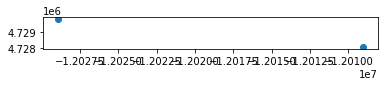

In [152]:
snotel_site_gdf.plot()

In [153]:
snotel_site_gdf['site_id'].values

array([622, 682])

In [154]:
#Trying to label
#ax = snotel_site_gdf.plot(column='site', marker='s', markersize=15, edgecolor='k', categorical=True, legend=True)
#ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points")
#for x, y, label in zip(cities.geometry.x, cities.geometry.y, cities.name):
#    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points")
#ax.legend()

### Determine average snow-free dates

<AxesSubplot:xlabel='datetime'>

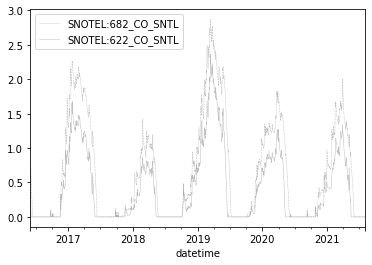

In [155]:
#Need index here to remove doy
snotel_df[sitecode_list].plot(alpha=0.5, color='gray', lw=0.5, style=['--','-'])

In [156]:
idx = (snotel_df[sitecode_list] < 0.1).all(axis=1)
idx

datetime
2016-06-01 00:00:00+00:00    False
2016-06-02 00:00:00+00:00    False
2016-06-03 00:00:00+00:00    False
2016-06-04 00:00:00+00:00    False
2016-06-05 00:00:00+00:00    False
                             ...  
2021-07-28 00:00:00+00:00     True
2021-07-29 00:00:00+00:00     True
2021-07-30 00:00:00+00:00     True
2021-07-31 00:00:00+00:00     True
2021-08-01 00:00:00+00:00     True
Length: 1888, dtype: bool

<AxesSubplot:>

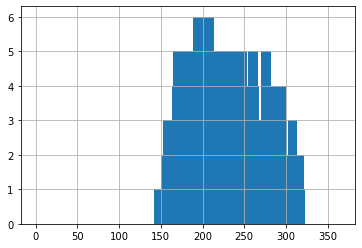

In [157]:
snotel_df[idx]['doy'].hist(bins=365, range=(0,365))

In [158]:
snowfree_doy_range = (170,300)

In [159]:
snotel_df.drop(['doy','dowy','decyear'], axis=1, inplace=True)

# Crop to GM polygon

<AxesSubplot:>

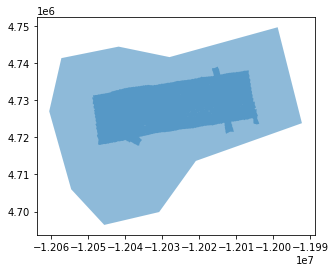

In [160]:
f, ax = plt.subplots()
aso_gdf.iloc[0:1].plot(ax=ax, alpha=0.5)
gm.iloc[0:1].plot(ax=ax, alpha=0.5)

In [161]:
#df_list = [ssc, phr, dg, aso, gedi, atl08]
df_list = [ssc, phr, dg, aso, gedi, atl08, atl06sr]
#df_list = [aso, gedi, atl08]

df_list_crop = []
for i in df_list:
    idx = i.intersects(gm.iloc[0].geometry)
    df_list_crop.append(i.loc[idx])

In [162]:
#gedi_crop, atl08_crop = df_list_crop[-2:]
gedi_crop, atl08_crop, atl06sr_crop = df_list_crop[-3:]

In [163]:
atl06sr_crop.shape

(125148, 22)

# Plot time series for all obs

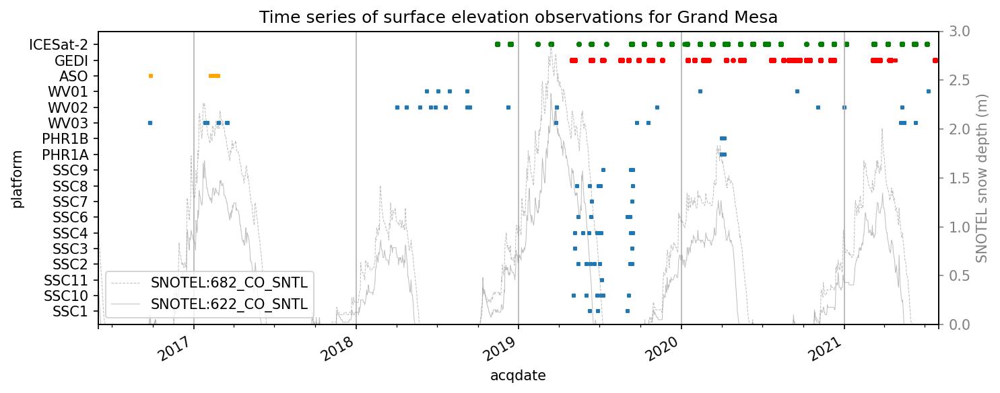

In [170]:
f, ax = plt.subplots(figsize=(10,4), dpi=150)
mykw = {'s':5, 'marker':'s', 'kind':'scatter'}

pd.DataFrame(df_list_crop[0].drop(columns='geometry')).plot(ax=ax, x='acqdate', y='satellite_id', **mykw)
pd.DataFrame(df_list_crop[1].drop(columns='geometry')).plot(ax=ax, x='acqdate', y='vehicle', **mykw)
pd.DataFrame(df_list_crop[2].drop(columns='geometry')).plot(ax=ax, x='acqdate', y='vehicle', **mykw)
pd.DataFrame(df_list_crop[3].drop(columns='geometry')).plot(ax=ax, x='acqdate', y='platform', color='orange', **mykw)
pd.DataFrame(df_list_crop[4].drop(columns='geometry')).plot(ax=ax, x='acqdate', y='platform', color='r', **mykw)
pd.DataFrame(df_list_crop[5].drop(columns='geometry')).plot(ax=ax, x='acqdate', y='platform', color='g', **mykw)

ax1 = ax.twinx()
snotel_df.plot(ax=ax1, alpha=0.5, color='gray', lw=0.5, style=['--','-'])
ax1.set_ylabel('SNOTEL snow depth (m)', color='gray')
ax1.tick_params(axis='y', colors='gray')
ax1.set_ylim(0,3)
plt.legend(loc='lower left')

#ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.format_xdata = mdates.DateFormatter('%Y-%m-%d')
f.autofmt_xdate()
ax.grid(axis='x', which='major')
ax.set_title('Time series of surface elevation observations for Grand Mesa')
plt.tight_layout()

# Create polygons for approximate shot diameter

In [382]:
(atl08_gdf['segment_id_end'] - atl08_gdf['segment_id_beg']).describe()

count    91906.000000
mean         3.988194
std          0.135291
min          0.000000
25%          4.000000
50%          4.000000
75%          4.000000
max          5.000000
dtype: float64

In [383]:
gedi_r = 13 #radius in meters
gedi_crop_poly_geom = gedi_crop.geometry.buffer(gedi_r)
gedi_crop_poly = gpd.GeoDataFrame(gedi_crop.copy(), geometry=gedi_crop_poly_geom)
#gedi_gdf_poly_ll = gedi_gdf_poly.to_crs('EPSG:4326')
gedi_crop_poly.shape

(171006, 22)

In [384]:
atl08_r = 7 #radius in meters
atl08_crop_poly_geom = atl08_crop.geometry.buffer(atl08_r)
atl08_crop_poly = gpd.GeoDataFrame(atl08_crop.copy(), geometry=atl08_crop_poly_geom)
#gedi_gdf_poly_ll = gedi_gdf_poly.to_crs('EPSG:4326')
atl08_crop_poly.shape

(48991, 38)

<AxesSubplot:>

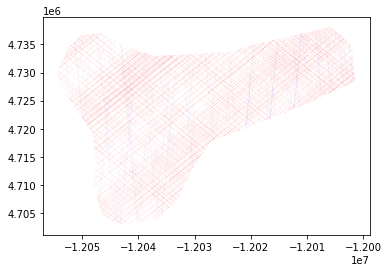

In [175]:
f, ax = plt.subplots()
gedi_crop_poly.plot(ax=ax, color='r')
atl08_crop_poly.plot(ax=ax, color='b')

# Altimetry crossovers

In [124]:
def xover_proc(df):
    #Convert back to point geometry
    df['geometry'] = df.centroid.geometry
    df['dt_diff'] = df.index - df['index_right']   
    #Remove any self intersections
    idx = (df.index != df['index_right'])
    return df.loc[idx]

In [125]:
def xover_plot(df, col, clim=(-10,10), title=None):
    f, axa = plt.subplots(1,2, figsize=(10,3), dpi=100)
    #markersize=300/atl08_crop['aso_snowoff_sample_dt_diff']
    idx = df[col] != np.nan
    plot_kw = {'markersize':15, 'edgecolor':'k', 'lw':0.25}
    #plot_kw = {'markersize':10}
    df.loc[idx].plot(ax=axa[0], column=col, cmap='RdBu', vmin=clim[0], vmax=clim[1], legend=True, **plot_kw)
    df.loc[idx,col].hist(ax=axa[1], bins=128, range=clim)
    axa[1].set_xlim(*clim)
    axa[1].set_xlabel('Difference (m)')
    axa[1].set_ylabel('Count')
    cx.add_basemap(axa[0], attribution=False, crs=df.crs.to_string(), source=basemap)
    axa[0].add_artist(ScaleBar(1, location='lower right'))
    if title:
        axa[0].set_title(title)
    pltlib.hide_ticks(axa[0])
    plt.tight_layout()

## ATl08 crossovers

In [178]:
atl08_xover = gpd.sjoin(atl08_crop_poly.loc[:,['h_te_best_fit', 'h_canopy', 'geometry']], atl08_crop_poly.loc[:,['h_te_best_fit', 'h_canopy', 'geometry']])

In [179]:
#Compute difference in elevation and time
atl08_xover['h_te_diff'] = atl08_xover['h_te_best_fit_left'] - atl08_xover['h_te_best_fit_right']
atl08_xover['h_canopy_diff'] = atl08_xover['h_canopy_left'] - atl08_xover['h_canopy_right']

In [180]:
atl08_xover = xover_proc(atl08_xover)

In [181]:
atl08_xover.head()

,h_te_best_fit_left,h_canopy_left,geometry,index_right,h_te_best_fit_right,h_canopy_right,h_te_diff,h_canopy_diff,dt_diff
utc,,,,,,,,,
2018-12-13 08:02:05.545,2714.593018,5.202393,POINT (-12030622.618 4715722.229),2018-11-15 21:08:11.925,2714.283203,18.260742,0.309814,-13.05835,27 days 10:53:53.620000
2018-11-15 21:08:11.925,2714.283203,18.260742,POINT (-12030615.824 4715715.676),2018-12-13 08:02:05.545,2714.593018,5.202393,-0.309814,13.05835,-28 days +13:06:06.380000
2020-06-10 06:00:52.409,3184.250488,NaN,POINT (-12031123.705 4720991.299),2018-11-15 21:08:12.503,3184.339600,9.989258,-0.089111,NaN,572 days 08:52:39.906000
2018-11-15 21:08:12.503,3184.339600,9.989258,POINT (-12031123.705 4720991.299),2020-06-10 06:00:52.409,3184.250488,NaN,0.089111,NaN,-573 days +15:07:20.094000
2020-06-10 06:00:52.382,3049.499756,12.318848,POINT (-12035194.402 4721486.883),2018-11-15 21:08:12.951,3052.040283,NaN,-2.540527,NaN,572 days 08:52:39.431000


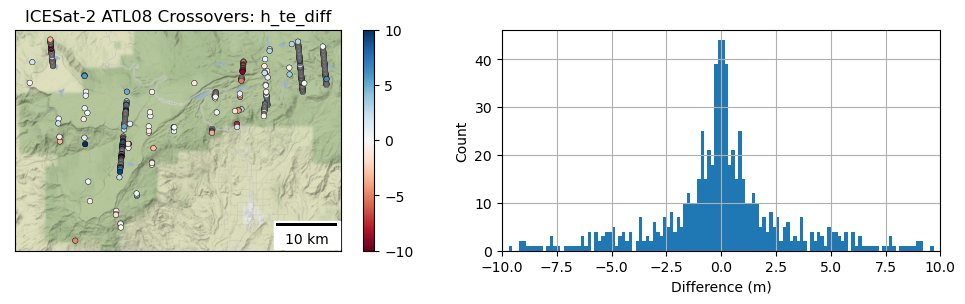

In [182]:
col = 'h_te_diff'
xover_plot(atl08_xover, col, title='ICESat-2 ATL08 Crossovers: {}'.format(col))

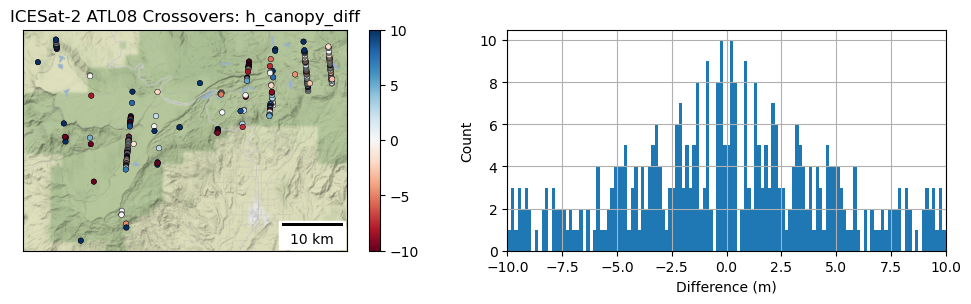

In [183]:
col = 'h_canopy_diff'
xover_plot(atl08_xover, col, title='ICESat-2 ATL08 Crossovers: {}'.format(col))

# GEDI crossovers

In [184]:
gedi_xover = gpd.sjoin(gedi_crop_poly.loc[:,['elev_lowestmode','elev_highestreturn', 'geometry']], gedi_crop_poly.loc[:,['elev_lowestmode','elev_highestreturn', 'geometry']])

In [185]:
#Compute difference in elevation and time
gedi_xover['h_te_diff'] = gedi_xover['elev_lowestmode_left'] - gedi_xover['elev_lowestmode_right']
gedi_xover['h_canopy_diff'] = gedi_xover['elev_highestreturn_left'] - gedi_xover['elev_highestreturn_right']

In [186]:
gedi_xover = xover_proc(gedi_xover)

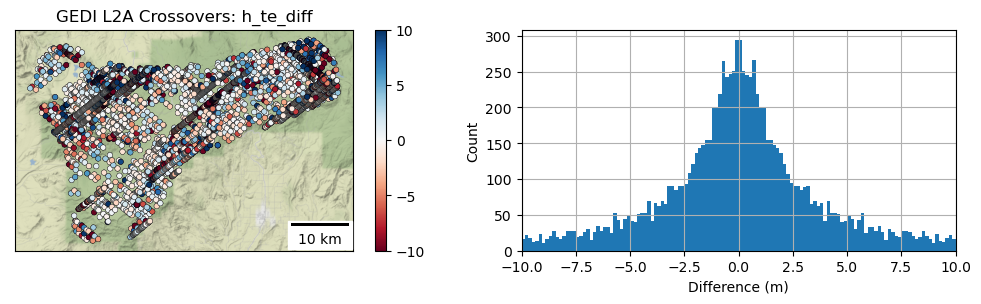

In [187]:
col = 'h_te_diff'
xover_plot(gedi_xover, col, title='GEDI L2A Crossovers: {}'.format(col))

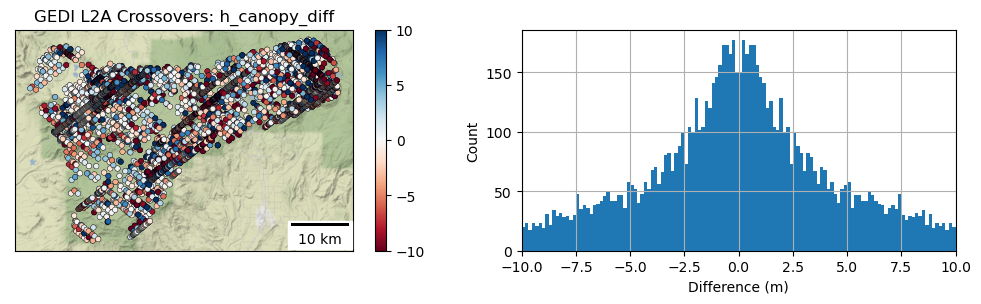

In [188]:
col = 'h_canopy_diff'
xover_plot(gedi_xover, col, title='GEDI L2A Crossovers: {}'.format(col))

# ATL08 and GEDI crossovers

In [189]:
#This doesn't work for all points in each gdf
#gedi_crop_poly.intersects(atl08_crop_poly.geometry).any()

In [190]:
atl08_gedi_xover = gpd.sjoin(atl08_crop_poly.loc[:,['h_te_best_fit', 'h_canopy', 'geometry']], gedi_crop_poly.loc[:,['elev_lowestmode','elev_highestreturn', 'geometry']])

In [191]:
#Compute difference in elevation and time
atl08_gedi_xover['h_te_diff'] = atl08_gedi_xover['h_te_best_fit'] - atl08_gedi_xover['elev_lowestmode']
atl08_gedi_xover['h_canopy_diff'] = atl08_gedi_xover['h_te_best_fit'] + atl08_gedi_xover['h_canopy'] - atl08_gedi_xover['elev_highestreturn']

In [192]:
atl08_gedi_xover = xover_proc(atl08_gedi_xover)

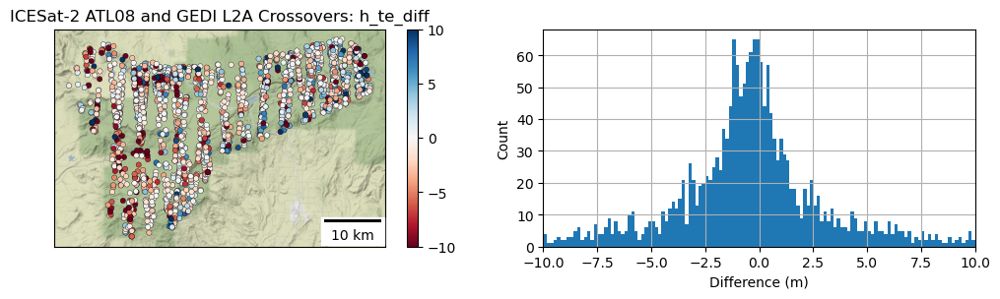

In [193]:
col = 'h_te_diff'
xover_plot(atl08_gedi_xover, col, title='ICESat-2 ATL08 and GEDI L2A Crossovers: {}'.format(col))

# Merge all crossovers

In [194]:
df_list = [atl08_xover, gedi_xover, atl08_gedi_xover]
xover_merge = pd.concat(df_list)
xover_merge.shape

(13925, 17)

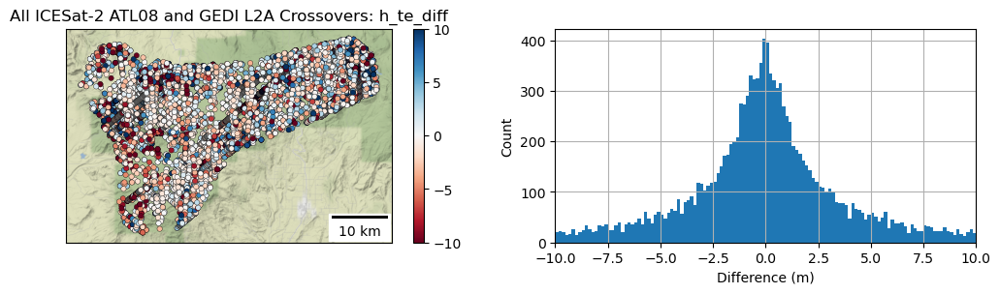

In [195]:
col = 'h_te_diff'
xover_plot(xover_merge, col, title='All ICESat-2 ATL08 and GEDI L2A Crossovers: {}'.format(col))

Text(0.5, 1.0, 'All Possible ATL08 and GEDI Crossovers')

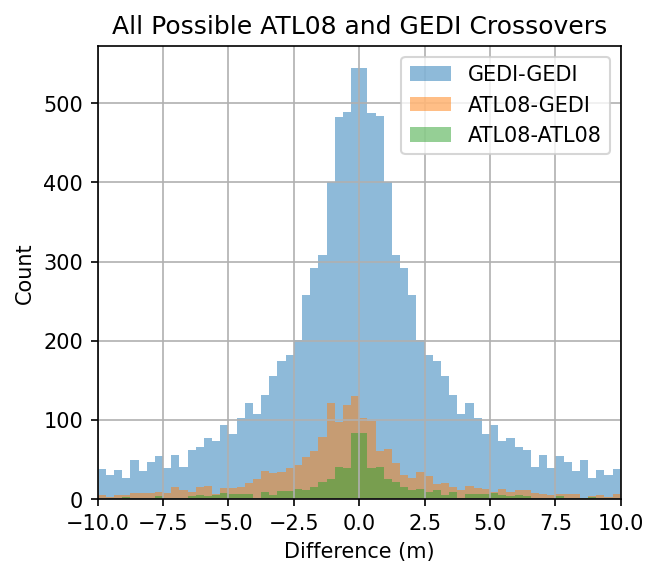

In [196]:
f, ax = plt.subplots(figsize=(4.5,4), dpi=150)
clim = (-10, 10)
bins = 64
kw = {'bins':bins, 'range':clim, 'alpha':0.5}
idx = gedi_xover[col] != np.nan
gedi_xover.loc[idx,col].hist(ax=ax, label='GEDI-GEDI', **kw)
idx = atl08_gedi_xover[col] != np.nan
atl08_gedi_xover.loc[idx,col].hist(ax=ax, label='ATL08-GEDI', **kw)
idx = atl08_xover[col] != np.nan
atl08_xover.loc[idx,col].hist(ax=ax, label='ATL08-ATL08', **kw)
ax.set_xlim(*clim)
ax.set_xlabel('Difference (m)')
ax.set_ylabel('Count')
ax.legend()
ax.set_title("All Possible ATL08 and GEDI Crossovers")

## Temporal filter on intersections

In [197]:
ndays = 30
dt_thresh = pd.Timedelta(days=ndays)

In [198]:
xover_merge = xover_merge.loc[xover_merge['dt_diff'].abs() < dt_thresh]
xover_merge.shape

(2237, 17)

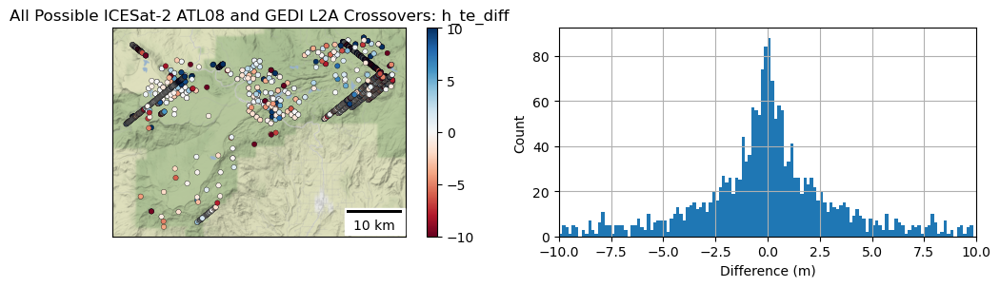

In [199]:
col = 'h_te_diff'
xover_plot(xover_merge, col, title='All Possible ICESat-2 ATL08 and GEDI L2A Crossovers: {}'.format(col))

# Difference with Reference DEM (ASO snow-off)

In [130]:
#Sort order of tracks and diff values

In [164]:
aso_fn_list

['/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_PCDTM_USCOGM_20160926_20160926.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170208.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170216.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170220.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170221.tif',
 '/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_SD_USCOGM_20170225.tif']

In [165]:
aso_idx = 0

In [166]:
aso.iloc[aso_idx]

geometry    POLYGON ((-12015160.592123369 4739071.49255754...
fn          /nobackup/deshean/p8_recovered/deshean/data/AS...
doy                                                       270
decyear                                           2016.734973
dowy                                                      362
platform                                                  ASO
acqdate                                   2016-09-26 00:00:00
Name: 2016-09-26 00:00:00, dtype: object

In [167]:
dem_fn = aso_fn_list[aso_idx]

In [168]:
aso_snowoff_src = rio.open(dem_fn)

In [169]:
#This is UTM 13N
#aso_snowoff_extent = rio.plot.plotting_extent(aso_snowoff_src)
#aso_snowoff_extent

In [170]:
aso_snowoff_src.crs

CRS.from_epsg(32613)

In [171]:
src.nodata

0.0

In [172]:
#aso_snowoff = aso_snowoff_src.read(1, masked=True)

In [173]:
#f, ax = plt.subplots()
#ax.imshow(aso_snowoff)

In [279]:
def sample_raster(df, src, diff_col=None):
    #df_proj = df.to_crs(src.crs)
    coord = [(pt.x, pt.y) for pt in df.to_crs(src.crs).geometry]
    s = np.fromiter(src.sample(coord), dtype=src.dtypes[0])
    #s[s == src.nodata] = np.nan
    sm = np.ma.masked_equal(s, src.nodata)
    sample_colname = os.path.splitext(os.path.split(src.name)[-1])[0]
    df[sample_colname] = sm
    if diff_col is not None:
        out_colname = '{} {} diff'.format(diff_col, sample_colname)
        df[out_colname] = df[diff_col] - df[sample_colname]
    else:
        out_colname = sample_colname
    return out_colname

## Sample snow-off DEM

In [177]:
atl08_diff_col = sample_raster(atl08_crop, aso_snowoff_src, diff_col=atl08_col)

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [178]:
atl08_crop[atl08_diff_col].max()

67.86133

In [179]:
gedi_diff_col = sample_raster(gedi_crop, aso_snowoff_src, diff_col=gedi_col)

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [180]:
atl06sr_diff_col = sample_raster(atl06sr_crop, aso_snowoff_src, diff_col=atl06sr_col)

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


## Sample DEM metrics

In [182]:
dem_fn = aso_fn_list[aso_idx]

In [183]:
dem_fn

'/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_PCDTM_USCOGM_20160926_20160926.tif'

In [185]:
#for dem_fn in [aso_fn_list[aso_idx], os.path.splitext(aso_fn_list[aso_idx])+'_8x.tif']:
for dem_fn in [os.path.splitext(aso_fn_list[aso_idx])[0]+'_8x.tif']:
    for v in ['slope', 'tri', 'roughness']:
        #gdaldem_fn = os.path.splitext(aso_fn_list[aso_idx])[0]+f'_{v}.tif'
        gdaldem_fn = os.path.splitext(dem_fn)[0]+f'_{v}.tif'
        print(gdaldem_fn)
        !gdaldem {v} {dem_fn} {gdaldem_fn} -co COMPRESS=LZW -co TILED=YES 
        gdaldem_src = rio.open(gdaldem_fn)
        sample_raster(atl08_crop, gdaldem_src)
        sample_raster(gedi_crop, gdaldem_src)
        sample_raster(atl06sr_crop, gdaldem_src)

/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_slope.tif
0...10...20...30...40...50...60...70...80...90...100 - done.


/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_tri.tif


/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


0...10...20...30...40...50...60...70...80...90...100 - done.


/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


/nobackup/deshean/p8_recovered/deshean/data/ASO/ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_roughness.tif


/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


0...10...20...30...40...50...60...70...80...90...100 - done.


/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWith

In [200]:
atl06sr_crop.columns

Index(['geometry', 'cycle', 'delta_time', 'dh_fit_dx', 'dh_fit_dy', 'distance',
       'gt', 'h_mean', 'h_sigma', 'n_fit_photons', 'pflags', 'rgt',
       'rms_misfit', 'segment_id', 'spot', 'w_surface_window_final', 'acqdate',
       'x', 'y', 'doy', 'decyear', 'dowy',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926',
       'h_mean ASO_3M_PCDTM_USCOGM_20160926_20160926 diff',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_slope',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_tri',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_roughness'],
      dtype='object')

In [194]:
gdaldem_fn = os.path.splitext(dem_fn)[0]+f'_slope.tif'
gdaldem_src = rio.open(gdaldem_fn)
gdaldem = gdaldem_src.read(1, masked=True)

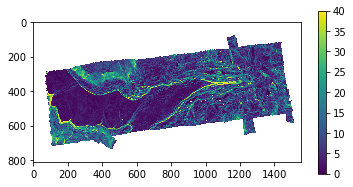

In [199]:
f, ax = plt.subplots(figsize=(6,3))
m = ax.imshow(gdaldem, vmin=0, vmax=40)
f.colorbar(m)

In [201]:
import rioxarray

In [202]:
ds = rioxarray.open_rasterio(gdaldem_fn, masked=True)

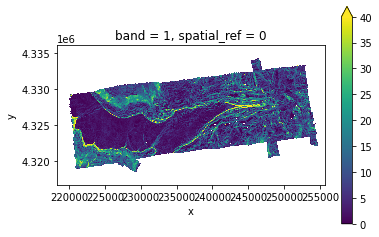

In [204]:
ax = ds.squeeze().plot.imshow(vmin=0, vmax=40)
ax.axes.set_aspect('equal')

In [205]:
atl08_slope_col = 'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_slope'

<AxesSubplot:>

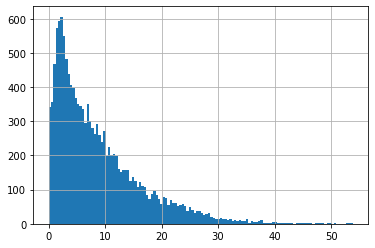

In [232]:
atl08_crop[atl08_slope_col].hist(bins=128)

<AxesSubplot:>

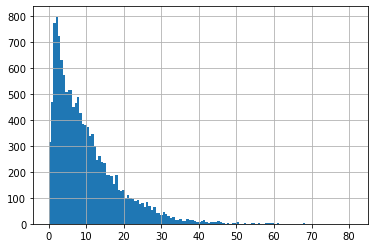

In [234]:
atl08_crop['ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_tri'].hist(bins=128)

(0.0, 40.0)

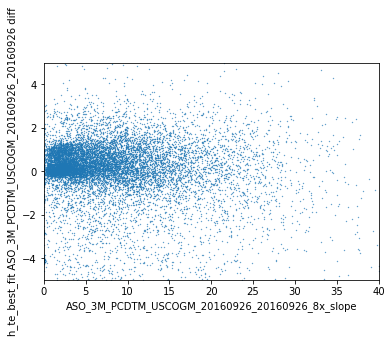

In [228]:
col1 = atl08_slope_col
col2 = atl08_diff_col
ax = atl08_crop.plot(kind='scatter', x=col1, y=col2, s=0.1)
ax.set_ylim(-5, 5)
ax.set_xlim(0, 40)

(0.0, 40.0)

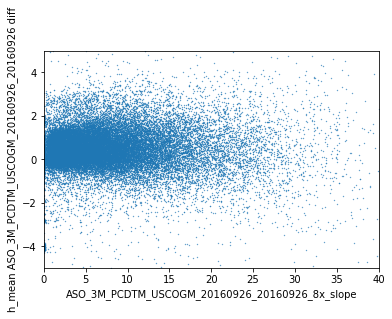

In [229]:
col1 = atl08_slope_col
col2 = atl06sr_diff_col
ax = atl06sr_crop.plot(kind='scatter', x=col1, y=col2, s=0.1)
ax.set_ylim(-5, 5)
ax.set_xlim(0, 40)

(0.0, 10.0)

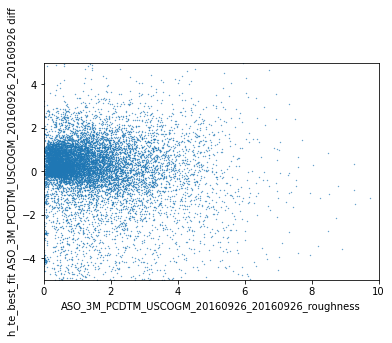

In [162]:
col1 = 'ASO_3M_PCDTM_USCOGM_20160926_20160926_roughness'
col2 = atl08_diff_col
ax = atl08_crop.plot(kind='scatter', x=col1, y=col2, s=0.1)
ax.set_ylim(-5, 5)
ax.set_xlim(0, 10)

In [163]:
atl08_crop.columns

Index(['segment_id_beg', 'segment_id_end', 'delta_time', 'latitude',
       'longitude', 'brightness_flag', 'layer_flag', 'msw_flag', 'night_flag',
       'terrain_flg', 'urban_flag', 'segment_landcover', 'segment_snowcover',
       'segment_watermask', 'h_te_best_fit', 'h_te_uncertainty',
       'terrain_slope', 'n_te_photons', 'h_canopy', 'h_canopy_uncertainty',
       'canopy_flag', 'n_ca_photons', 'rgt', 'cycle', 'groundtrack_id',
       'atlas_spot_number', 'atlas_beam_type', 'sc_orientation',
       'atmosphere_profile', 'atlas_pce', 'decyear', 'x', 'y', 'doy', 'dowy',
       'geometry', 'acqdate', 'platform',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926',
       'h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_slope',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_tri',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_roughness'],
      dtype='object')

(0.0, 400.0)

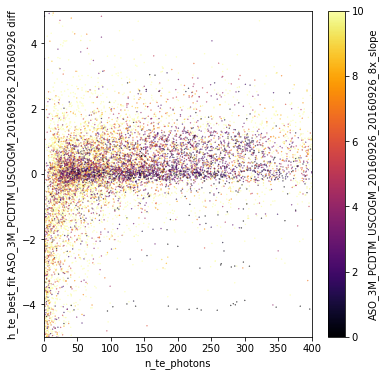

In [208]:
f, ax = plt.subplots(figsize=(6,6))
col1 = 'n_te_photons'
col2 = atl08_diff_col
ax = atl08_crop.plot(ax=ax, kind='scatter', x=col1, y=col2, s=0.1, \
                                   c=atl08_slope_col, cmap='inferno', vmin=0, vmax=10)
ax.set_ylim(-5, 5)
ax.set_xlim(0, 400)

(0.0, 400.0)

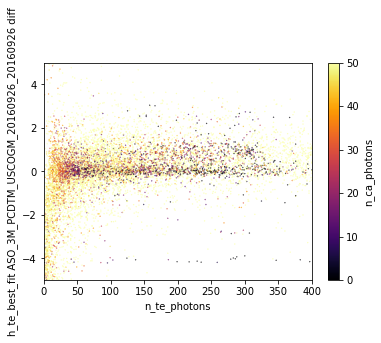

In [230]:
f, ax = plt.subplots()
col1 = 'n_te_photons'
col2 = atl08_diff_col
ax = atl08_crop.plot(ax=ax, kind='scatter', x=col1, y=col2, s=0.1, \
                                   c='n_ca_photons', cmap='inferno', vmin=0, vmax=50)
ax.set_ylim(-5, 5)
ax.set_xlim(0, 400)

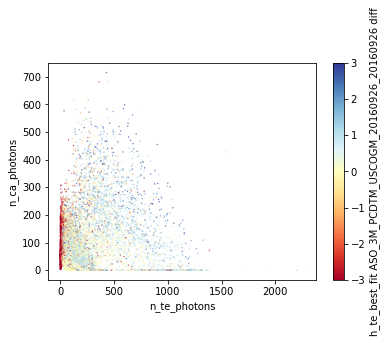

In [212]:
f, ax = plt.subplots()
col1 = 'n_te_photons'
col2 = 'n_ca_photons'
c = atl08_diff_col

ax = atl08_crop.plot(ax=ax, kind='scatter', x=col1, y=col2, s=0.1, \
                                   c=c, cmap='RdYlBu', vmin=-3, vmax=3)
#ax.set_ylim(0, 100)
#ax.set_xlim(0, 100)

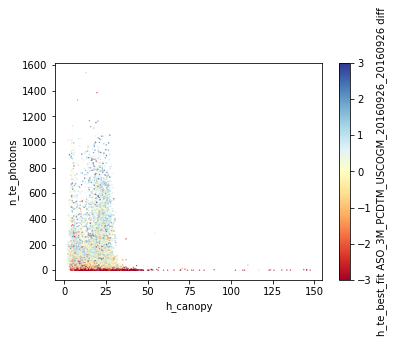

In [272]:
f, ax = plt.subplots()
col1 = 'h_canopy'
col2 = 'n_te_photons'
c = atl08_diff_col

ax = atl08_crop.plot(ax=ax, kind='scatter', x=col1, y=col2, s=0.1, \
                                   c=c, cmap='RdYlBu', vmin=-3, vmax=3)
#ax.set_ylim(0, 100)
#ax.set_xlim(0, 100)

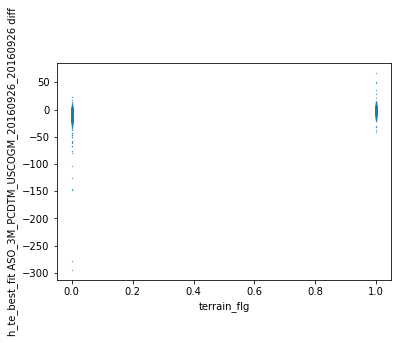

In [834]:
col1 = 'terrain_flg'
col2 = atl08_diff_col
ax = atl08_crop.plot(kind='scatter', x=col1, y=col2, s=0.1)

In [222]:
atl06sr_crop.columns

Index(['geometry', 'cycle', 'delta_time', 'dh_fit_dx', 'dh_fit_dy', 'distance',
       'gt', 'h_mean', 'h_sigma', 'n_fit_photons', 'pflags', 'rgt',
       'rms_misfit', 'segment_id', 'spot', 'w_surface_window_final', 'acqdate',
       'x', 'y', 'doy', 'decyear', 'dowy',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926',
       'h_mean ASO_3M_PCDTM_USCOGM_20160926_20160926 diff',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_slope',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_tri',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_roughness'],
      dtype='object')

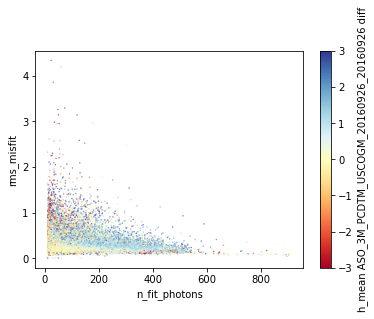

In [225]:
f, ax = plt.subplots()
col1 = 'n_fit_photons'
col2 = 'rms_misfit'
c = atl06sr_diff_col

ax = atl06sr_crop.plot(ax=ax, kind='scatter', x=col1, y=col2, s=0.1, \
                                   c=c, cmap='RdYlBu', vmin=-3, vmax=3)
#ax.set_ylim(0, 100)
#ax.set_xlim(0, 100)

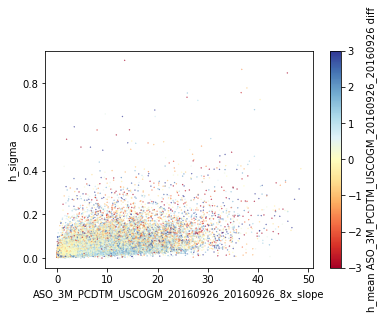

In [227]:
f, ax = plt.subplots()
col1 = 'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_slope'
col2 = 'h_sigma'
c = atl06sr_diff_col

ax = atl06sr_crop.plot(ax=ax, kind='scatter', x=col1, y=col2, s=0.1, \
                                   c=c, cmap='RdYlBu', vmin=-3, vmax=3)
#ax.set_ylim(0, 100)
#ax.set_xlim(0, 100)

count    12413.000000
mean        -0.841981
std          6.103768
min       -295.152832
25%         -0.513184
50%          0.135498
75%          0.790527
max         67.861328
Name: h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64

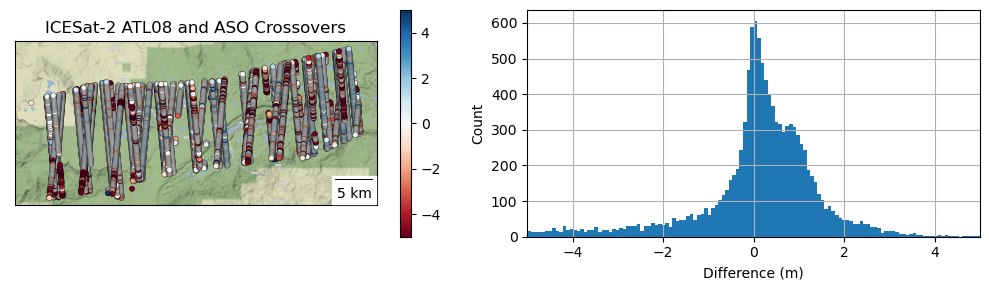

In [406]:
#col = 'h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff'
xover_plot(atl08_crop, atl08_diff_col, clim=(-5, 5), title='ICESat-2 ATL08 and ASO Crossovers')
atl08_crop[atl08_diff_col].describe()

In [214]:
extent=aso_snowoff_extent
pad=1000
extent=[extent[0]-pad, extent[2]+pad, extent[1]-pad, extent[3]+pad]
extent

[-12049889.428751722,
 -12002774.315696366,
 4716791.416740892,
 4740077.505179193]

In [215]:
def xover_plot2(df, col, asc=True, clim=(-10,10), cmap='RdYlBu', title=None, dpi=150):
    f, ax = plt.subplots(figsize=(10,3), dpi=dpi)
    #markersize=300/atl08_crop['aso_snowoff_sample_dt_diff']
    idx = df[col].notna()
    plot_kw = {'markersize':10, 'edgecolor':'k', 'lw':0.05}
    #plot_kw = {'markersize':10}
    col_label = col
    if ' diff' in col:
        col_label = 'Elev. Difference (m)'
    if clim is None:
        clim = np.nanpercentile(df.loc[idx, col], q=(2,98))
    df.loc[idx].sort_values(by=col, ascending=asc).plot(ax=ax, column=col, cmap=cmap, vmin=clim[0], vmax=clim[1], \
                                                        legend=True, legend_kwds={"label":col_label}, **plot_kw)
    snotel_site_gdf.plot(ax=ax, marker='s', markersize=15, edgecolor='k', color='g')
    #cx.add_basemap(ax, attribution=False, crs=df.crs.to_string(), source=basemap)
    ax.autoscale(False)
    show(dg_src, ax=ax, extent=extent, **dg_kw)
    ax.set_xlim(extent[0], extent[1])
    ax.set_ylim(extent[2], extent[3])
    ax.add_artist(ScaleBar(1, location='lower right'))
    if title:
        ax.set_title(title, fontsize=10)
    pltlib.hide_ticks(ax)
    #plt.tight_layout()
    
    #Prepare stats for histogram
    df_count = df.loc[idx,col].shape[0]
    #df_mode = df.loc[idx,col].mode().values
    df_med = df.loc[idx,col].median()
    df_nmad = nmad(df.loc[idx,col])
    df_spread = spread(df.loc[idx,col])
    #print(df_mode, df_med, df_nmad, df_spread)
    #df_str = f'mode: {df_mode:0.2f}\nmed: {df_med:0.2f}\nnmad: {df_nmad:0.2f}\nspread: {df_spread:0.2f}'
    #df_str = f'n: {df_count:.1E}\nmed: {df_med:0.2f}\nnmad: {df_nmad:0.2f}\nspread: {df_spread:0.2f}'
    df_str = f'n: {df_count}\nmed: {df_med:0.2f}\nnmad: {df_nmad:0.2f}\nspread: {df_spread:0.2f}'
    
    f2, ax2 = plt.subplots(figsize=(3,3), dpi=dpi)
    df.loc[idx,col].hist(ax=ax2, bins=128, range=clim)
    ax2.axvline(df_med, color='k', ls=':', lw=0.5)
    ax2.text(0.05, 0.95, df_str, va='top', color='k', transform=ax2.transAxes, fontsize=8, \
            bbox={'facecolor': 'w', 'alpha': 0.7, 'pad': 5})
    ax2.set_xlim(*clim)
    ax2.set_xlabel(col_label)
    ax2.set_ylabel('Count')
    plt.tight_layout()

In [799]:
atl08_crop.columns

Index(['segment_id_beg', 'segment_id_end', 'delta_time', 'latitude',
       'longitude', 'brightness_flag', 'layer_flag', 'msw_flag', 'night_flag',
       'terrain_flg', 'urban_flag', 'segment_landcover', 'segment_snowcover',
       'segment_watermask', 'h_te_best_fit', 'h_te_uncertainty',
       'terrain_slope', 'n_te_photons', 'h_canopy', 'h_canopy_uncertainty',
       'canopy_flag', 'n_ca_photons', 'rgt', 'cycle', 'groundtrack_id',
       'atlas_spot_number', 'atlas_beam_type', 'sc_orientation',
       'atmosphere_profile', 'atlas_pce', 'decyear', 'x', 'y', 'doy', 'dowy',
       'geometry', 'acqdate', 'platform',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926',
       'h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_slope',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_tri',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926_roughness',
       'ASO_3M_PCDTM_USCOGM_20160926_20160926 dt_diff',
       'ASO_3M_PCDTM_USCOGM_20160926_2016

In [800]:
atl08_diff_col

'h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff'

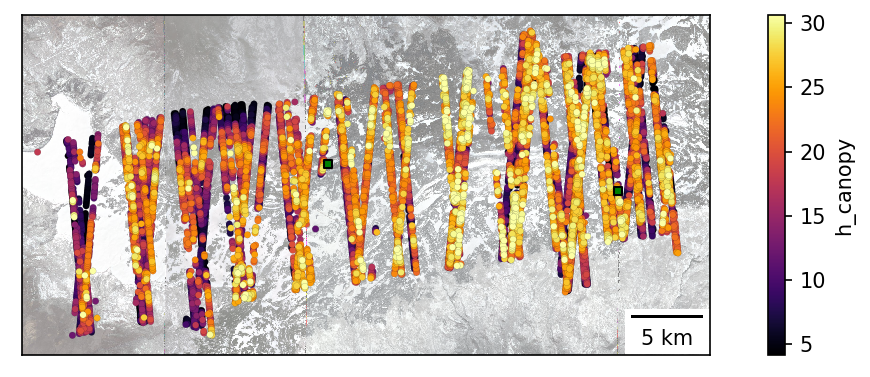

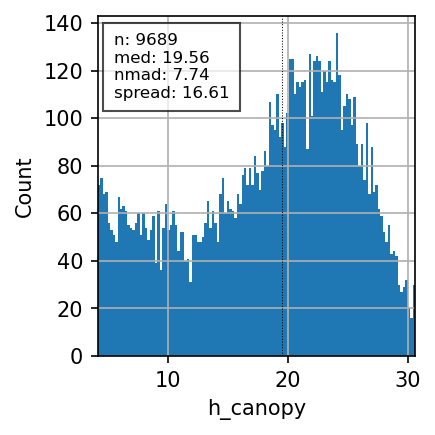

In [221]:
xover_plot2(atl08_crop[atl08_crop['n_te_photons'] > 10].dropna(), 'h_canopy', clim=None, cmap='inferno')

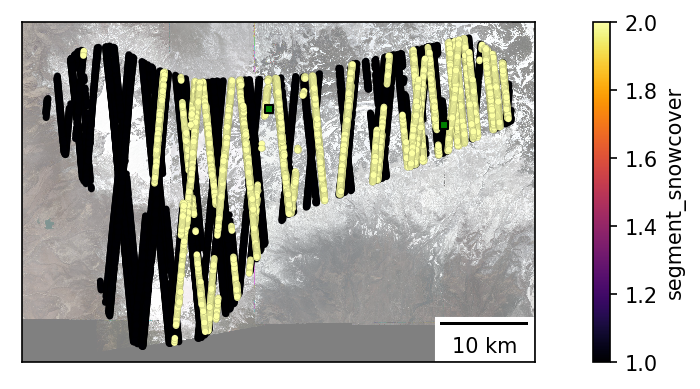

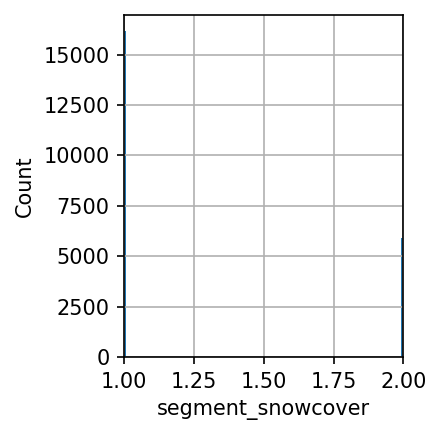

In [832]:
xover_plot2(atl08_crop, 'segment_snowcover', clim=None, cmap='inferno')

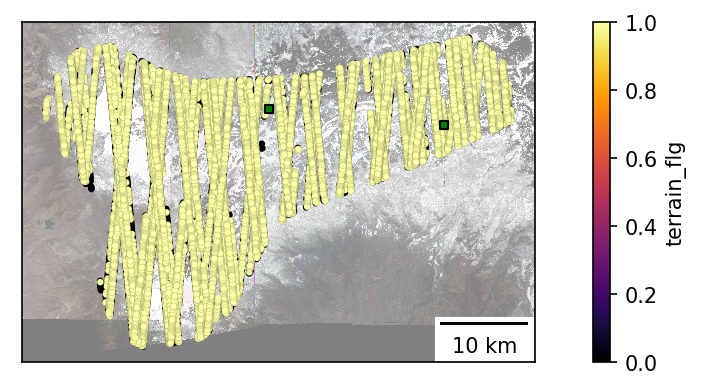

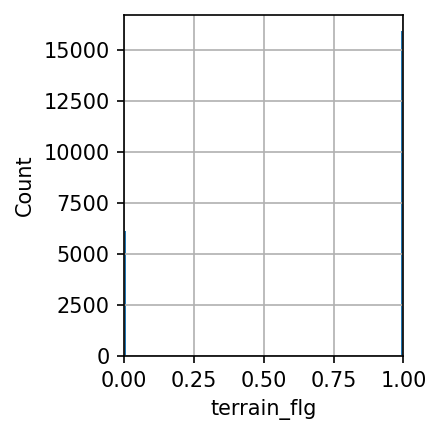

In [831]:
xover_plot2(atl08_crop, 'terrain_flg', clim=None, cmap='inferno')

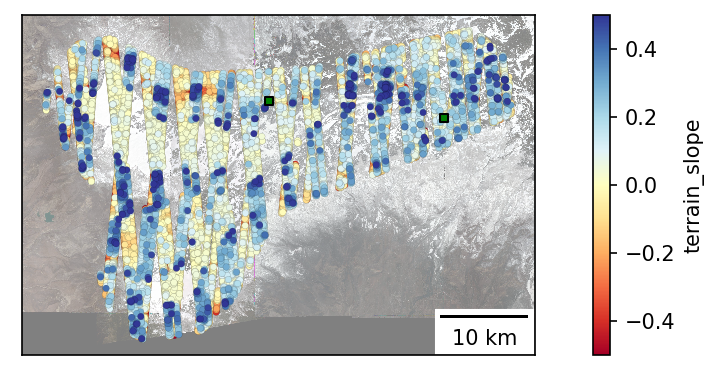

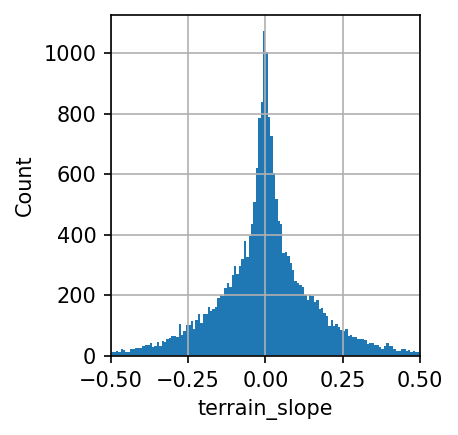

In [838]:
xover_plot2(atl08_crop, 'terrain_slope', clim=(-0.5, 0.5), cmap='RdYlBu')

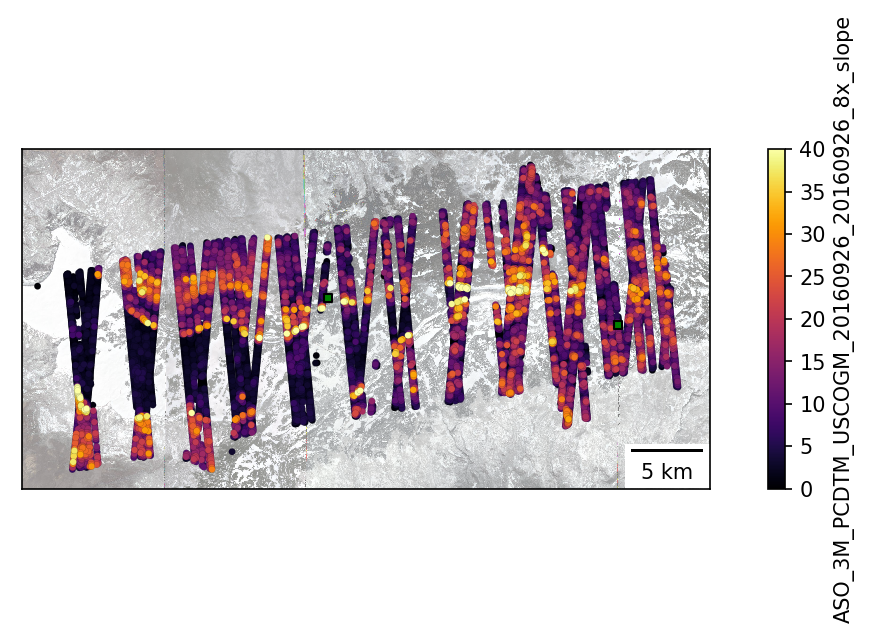

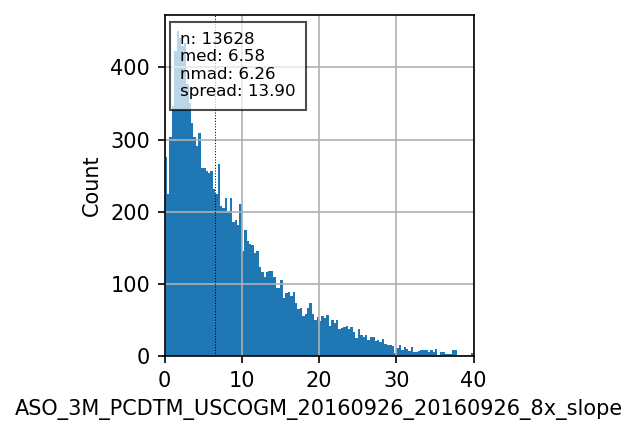

In [235]:
xover_plot2(atl08_crop, atl08_slope_col, clim=(0,40), cmap='inferno')

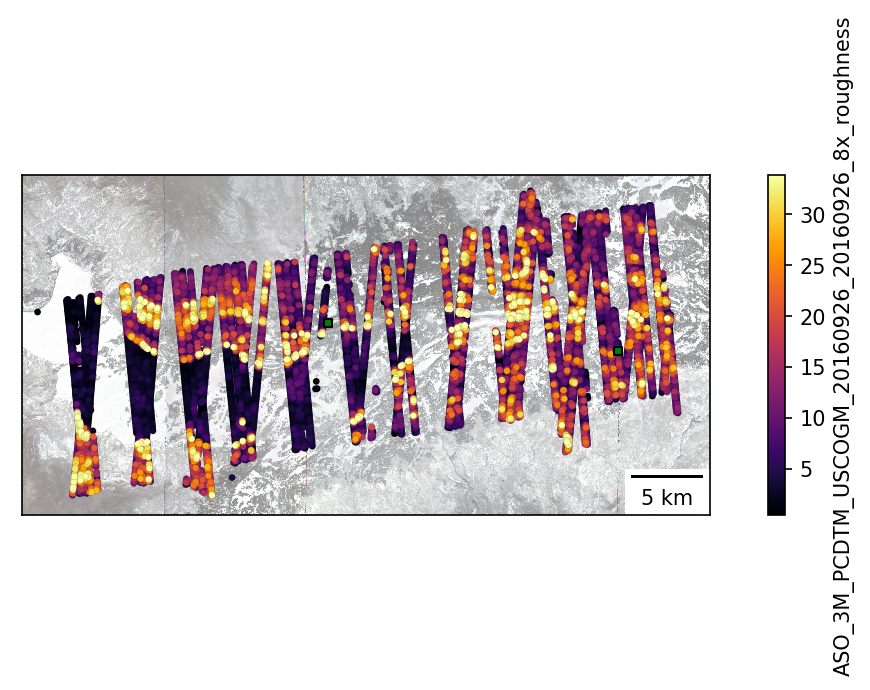

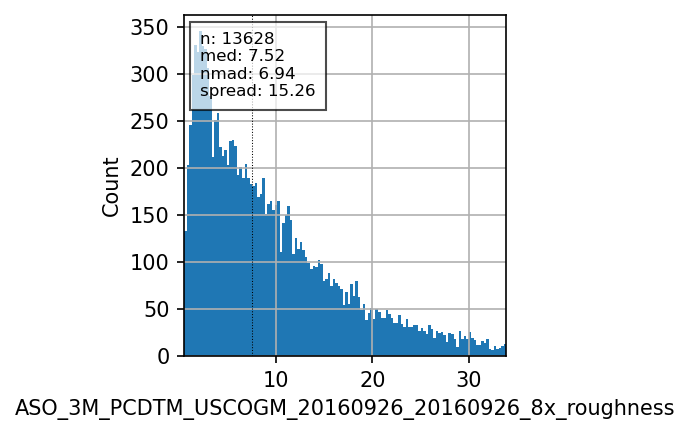

In [236]:
xover_plot2(atl08_crop, 'ASO_3M_PCDTM_USCOGM_20160926_20160926_8x_roughness', clim=None, cmap='inferno')

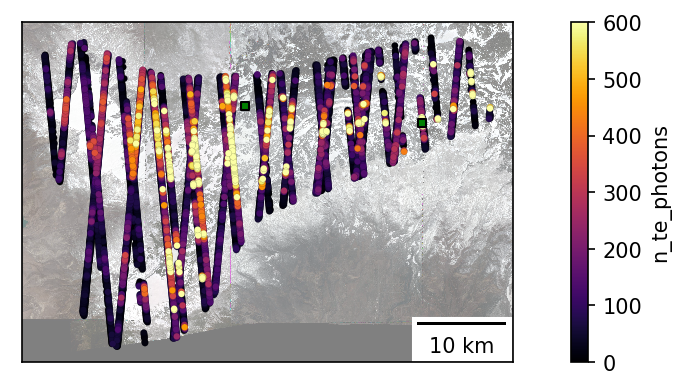

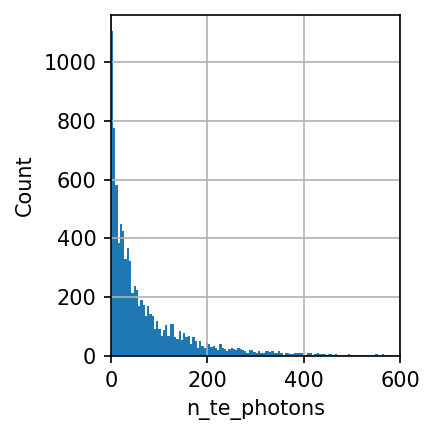

In [815]:
xover_plot2(atl08_crop[atl08_crop_snowfree_idx], 'n_te_photons', clim=(0,600), cmap='inferno')

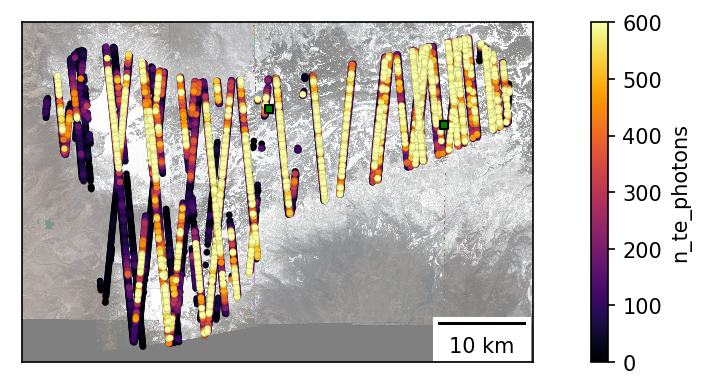

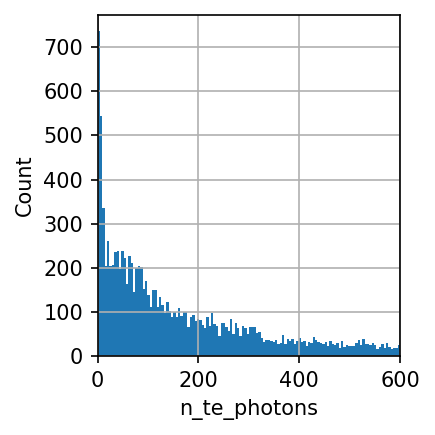

In [816]:
xover_plot2(atl08_crop[~atl08_crop_snowfree_idx], 'n_te_photons', clim=(0,600), cmap='inferno')

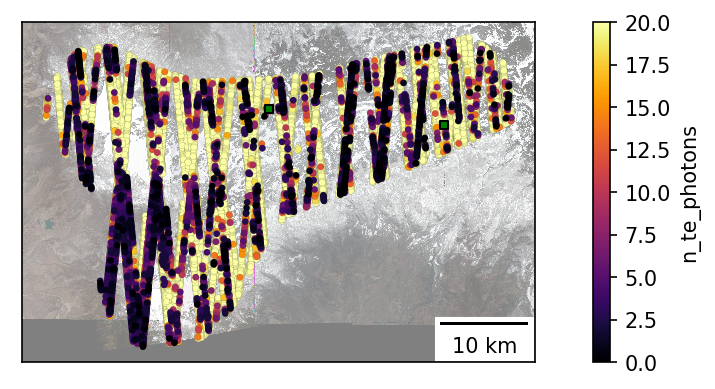

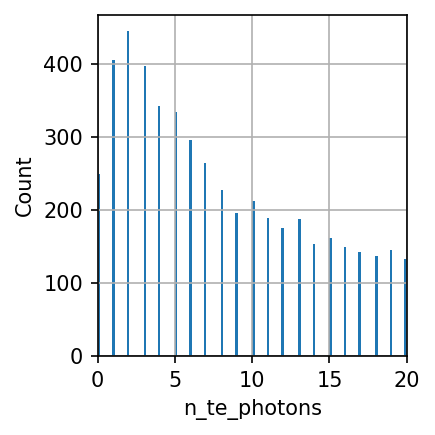

In [842]:
xover_plot2(atl08_crop, 'n_te_photons', asc=False, clim=(0,20), cmap='inferno')

In [263]:
n_te_photons_thresh = 10

In [264]:
atl08_nphoton_idx = atl08_crop['n_te_photons'] > n_te_photons_thresh

In [265]:
slope_thresh = 10

In [228]:
terrain_slope_thresh = 0.4

In [229]:
atl08_terrain_slope_idx = atl08_crop['terrain_slope'].abs() < terrain_slope_thresh

## Create figures

count    13650.000000
mean        -0.884645
std          6.511588
min       -295.152832
25%         -0.526123
50%          0.133057
75%          0.777588
max         67.861328
Name: h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64

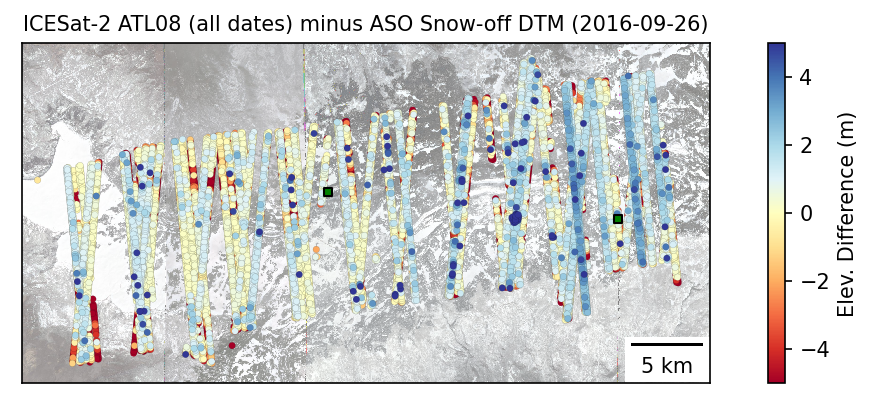

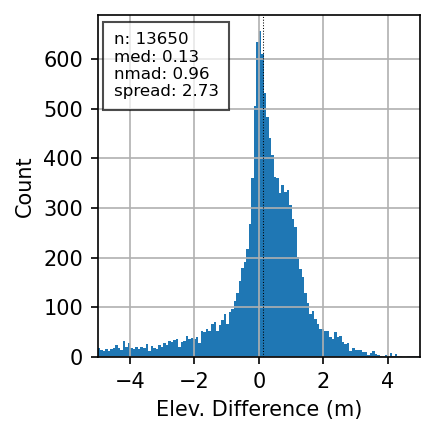

In [571]:
xover_plot2(atl08_crop, atl08_diff_col, clim=(-5, 5), title='ICESat-2 ATL08 (all dates) minus ASO Snow-off DTM (2016-09-26)')
atl08_crop[atl08_diff_col].describe()

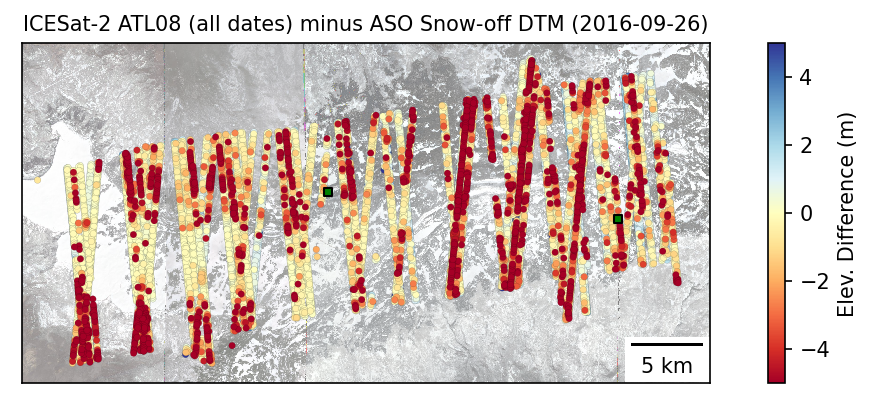

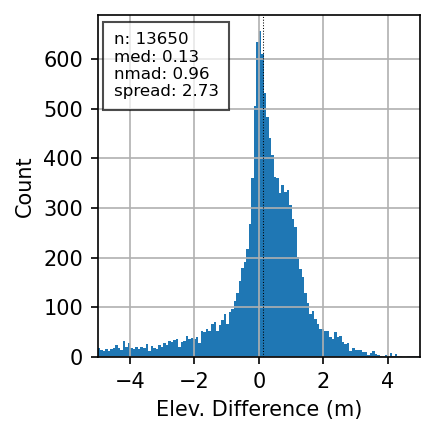

In [572]:
xover_plot2(atl08_crop, atl08_diff_col, asc=False, clim=(-5, 5), title='ICESat-2 ATL08 (all dates) minus ASO Snow-off DTM (2016-09-26)')

count    38249.000000
mean         0.411583
std          1.531958
min        -47.598429
25%         -0.051999
50%          0.324756
75%          0.951258
max         74.854247
Name: h_mean ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64

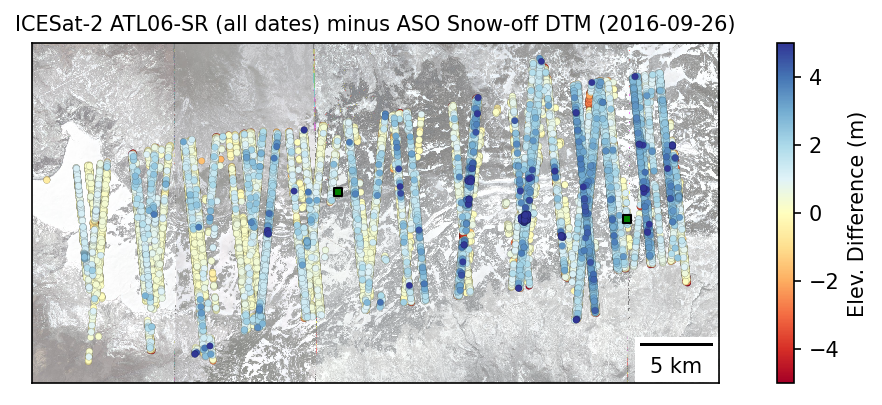

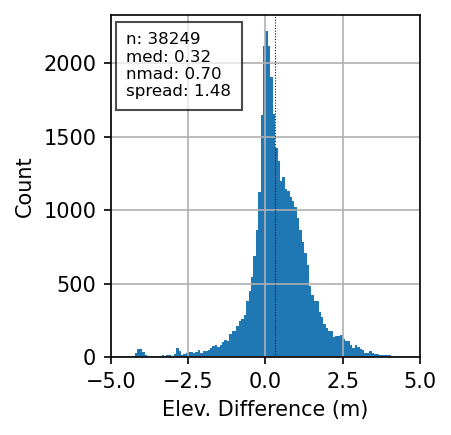

In [573]:
xover_plot2(atl06sr_crop, atl06sr_diff_col, clim=(-5, 5), title='ICESat-2 ATL06-SR (all dates) minus ASO Snow-off DTM (2016-09-26)')
atl06sr_crop[atl06sr_diff_col].describe()

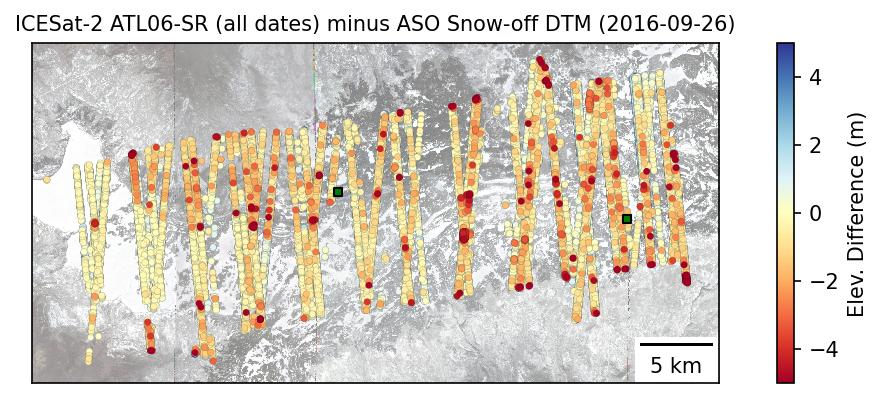

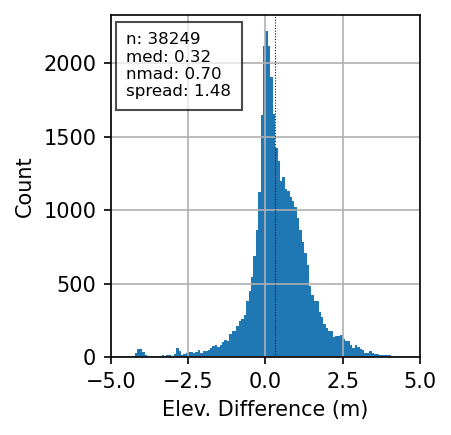

In [574]:
xover_plot2(atl06sr_crop, atl06sr_diff_col, clim=(-5, 5), asc=False, title='ICESat-2 ATL06-SR (all dates) minus ASO Snow-off DTM (2016-09-26)')

In [575]:
atl08_crop_fullpower_idx = atl08_crop['atlas_beam_type'] == 'strong'

In [576]:
#xover_plot2(atl08_crop[atl08_crop_fullpower_idx], atl08_diff_col, clim=(-5, 5), title='ICESat-2 ATL08 (all dates) minus ASO Snow-off DTM (2016-09-26)')
#atl08_crop[atl08_crop_fullpower_idx][atl08_diff_col].describe()

count    46071.000000
mean         0.395543
std          9.614106
min       -193.521240
25%         -0.279541
50%          0.691895
75%          1.646973
max        164.662354
Name: elev_lowestmode ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64

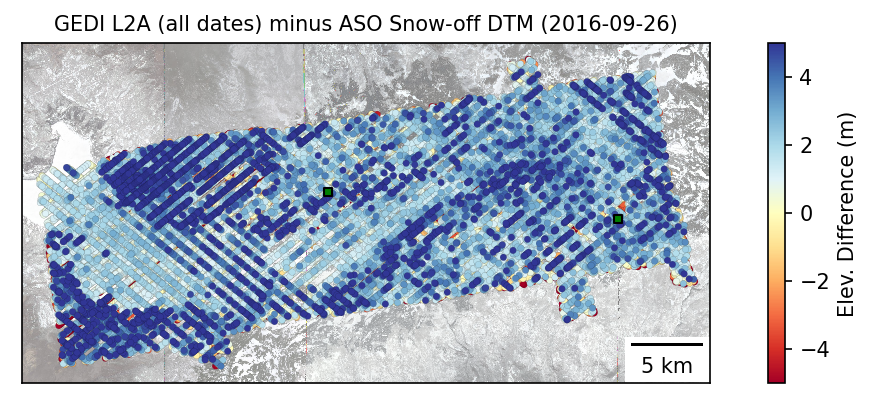

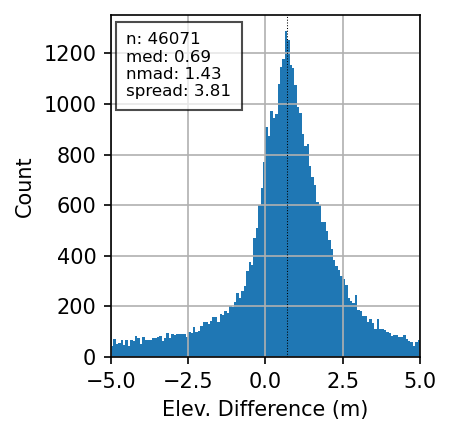

In [577]:
#col = 'elev_lowestmode ASO_3M_PCDTM_USCOGM_20160926_20160926 diff'
xover_plot2(gedi_crop, gedi_diff_col, clim=(-5, 5), title='GEDI L2A (all dates) minus ASO Snow-off DTM (2016-09-26)')
gedi_crop[gedi_diff_col].describe()

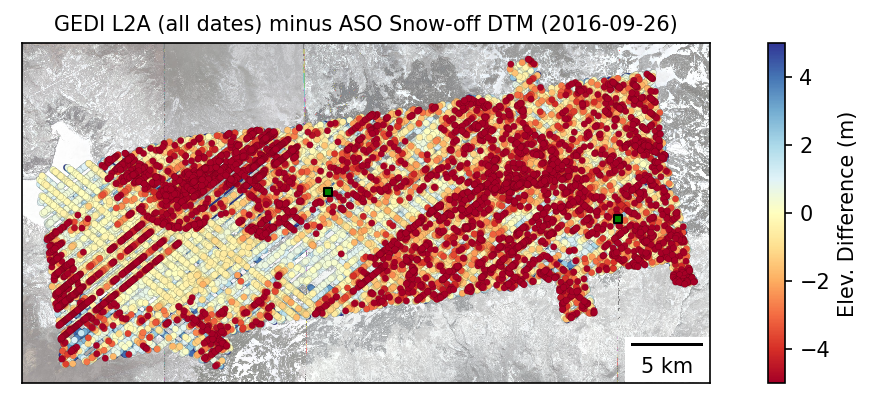

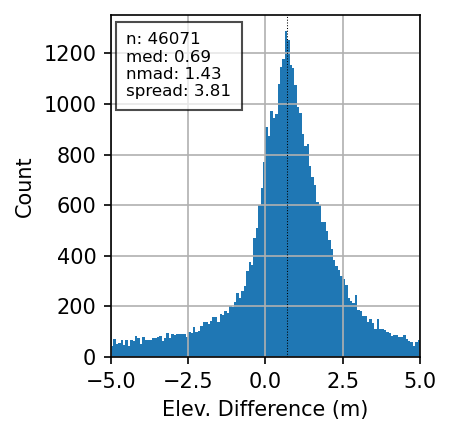

In [578]:
xover_plot2(gedi_crop, gedi_diff_col, asc=False, clim=(-5, 5), title='GEDI L2A (all dates) minus ASO Snow-off DTM (2016-09-26)')

In [579]:
gedi_crop_fullpower_idx = gedi_crop['beam'].isin(gedi_fullpower_beamlist)

In [580]:
#xover_plot2(gedi_crop[gedi_crop_fullpower_idx], gedi_diff_col, clim=(-5, 5), title='GEDI L2A (all dates, full power) minus ASO Snow-off DTM (2016-09-26)')
#gedi_crop[gedi_crop_fullpower_idx][gedi_diff_col].describe()

<AxesSubplot:>

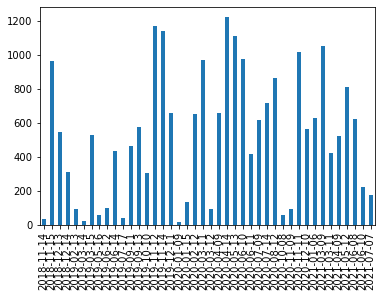

In [235]:
atl08_crop['acqdate'].value_counts().sort_index().plot(kind='bar')

<AxesSubplot:>

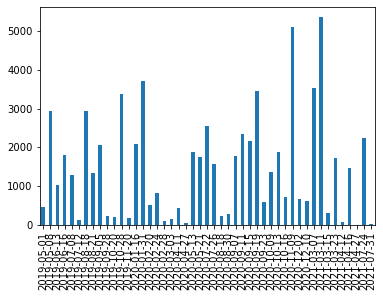

In [236]:
gedi_crop['acqdate'].value_counts().sort_index().plot(kind='bar')

## Filter points for snow-on and snow-off stats

### Initial attempt: within some time threshold of ASO snow-off date and doy

In [235]:
aso.iloc[aso_idx]['acqdate']

Timestamp('2016-09-26 00:00:00')

In [236]:
dt_thresh = pd.Timedelta(days=60)
dt_col = 'ASO_3M_PCDTM_USCOGM_20160926_20160926 dt_diff'
atl08_crop[dt_col] = (pd.to_datetime(atl08_crop['acqdate']) - aso.iloc[aso_idx]['acqdate']).abs()

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [237]:
idx = atl08_crop[dt_col] < dt_thresh
atl08_crop[idx]

,segment_id_beg,segment_id_end,delta_time,latitude,longitude,brightness_flag,layer_flag,msw_flag,night_flag,terrain_flg,...,dowy,geometry,acqdate,platform,ASO_3M_PCDTM_USCOGM_20160926_20160926,h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff,ASO_3M_PCDTM_USCOGM_20160926_20160926_slope,ASO_3M_PCDTM_USCOGM_20160926_20160926_tri,ASO_3M_PCDTM_USCOGM_20160926_20160926_roughness,ASO_3M_PCDTM_USCOGM_20160926_20160926 dt_diff
utc,,,,,,,,,,,,,,,,,,,,,


In [238]:
aso.iloc[aso_idx]['doy']

270

In [248]:
dt_thresh = 30
dt_col = 'ASO_3M_PCDTM_USCOGM_20160926_20160926 doy_diff'
atl08_crop[dt_col] = (atl08_crop['doy'] - aso.iloc[aso_idx]['doy']).abs()

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


<AxesSubplot:>

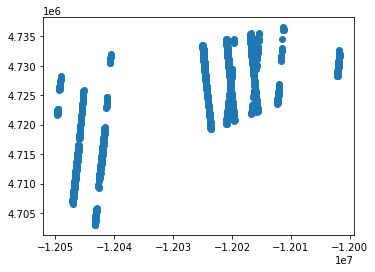

In [249]:
idx = atl08_crop[dt_col] < dt_thresh
atl08_crop[idx].plot()

In [253]:
snowfree_doy_range

(170, 300)

<AxesSubplot:>

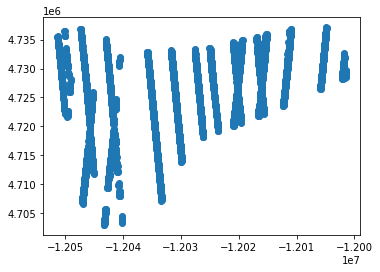

In [503]:
idx = (atl08_crop['doy'] >= snowfree_doy_range[0]) & (atl08_crop['doy'] <= snowfree_doy_range[1])
atl08_crop[idx].plot()

## All snow-off ICESat-2 returns

In [ ]:
xover_plot2(atl08_crop[idx], atl08_diff_col, clim=(-3, 3), title='ICESat-2 ATL08 (snow-off) minus ASO Snow-off DTM (2016-09-26)')
atl08_crop[idx][atl08_diff_col].describe()

## All snow-on ICESat-2 returns

In [ ]:
xover_plot2(atl08_crop[~idx], atl08_diff_col, clim=(-3, 3), title='ICESat-2 ATL08 (snow-on) minus ASO Snow-off DTM (2016-09-26)')
atl08_crop[~idx][atl08_diff_col].describe()

## Use SNOTEL observations to define snow-free days

In [237]:
snotel_depth_thresh = 0.1

In [238]:
clim = (-3, 3)
asc = False

In [239]:
atl08_dates_valid = pd.to_datetime(atl08_crop['acqdate'].unique(), utc=True)
atl08_dates_valid

DatetimeIndex(['2018-10-17 00:00:00+00:00', '2018-11-14 00:00:00+00:00',
               '2018-11-15 00:00:00+00:00', '2018-12-13 00:00:00+00:00',
               '2018-12-14 00:00:00+00:00', '2019-01-11 00:00:00+00:00',
               '2019-02-13 00:00:00+00:00', '2019-03-14 00:00:00+00:00',
               '2019-03-15 00:00:00+00:00', '2019-04-12 00:00:00+00:00',
               '2019-05-15 00:00:00+00:00', '2019-05-16 00:00:00+00:00',
               '2019-06-12 00:00:00+00:00', '2019-06-14 00:00:00+00:00',
               '2019-07-17 00:00:00+00:00', '2019-09-11 00:00:00+00:00',
               '2019-09-13 00:00:00+00:00', '2019-10-10 00:00:00+00:00',
               '2019-11-12 00:00:00+00:00', '2019-11-14 00:00:00+00:00',
               '2019-12-11 00:00:00+00:00', '2020-01-09 00:00:00+00:00',
               '2020-01-15 00:00:00+00:00', '2020-02-12 00:00:00+00:00',
               '2020-03-11 00:00:00+00:00', '2020-03-12 00:00:00+00:00',
               '2020-04-09 00:00:00+00:00', '2020-0

In [240]:
atl08_crop.index.normalize().unique()

DatetimeIndex(['2018-10-17', '2018-11-14', '2018-11-15', '2018-12-13',
               '2018-12-14', '2019-01-11', '2019-02-13', '2019-03-14',
               '2019-03-15', '2019-04-12', '2019-05-15', '2019-05-16',
               '2019-06-12', '2019-06-14', '2019-07-17', '2019-09-11',
               '2019-09-13', '2019-10-10', '2019-11-12', '2019-11-14',
               '2019-12-11', '2020-01-09', '2020-01-15', '2020-02-12',
               '2020-03-11', '2020-03-12', '2020-04-09', '2020-04-14',
               '2020-05-12', '2020-05-13', '2020-06-10', '2020-06-11',
               '2020-07-09', '2020-07-14', '2020-08-11', '2020-08-12',
               '2020-10-08', '2020-11-09', '2020-11-11', '2020-12-10',
               '2021-01-06', '2021-03-09', '2021-03-11', '2021-04-07',
               '2021-04-09', '2021-05-12', '2021-06-08', '2021-06-10',
               '2021-07-07', '2021-07-12'],
              dtype='datetime64[ns]', name='utc', freq=None)

In [241]:
atl06sr_dates_valid = pd.to_datetime(atl06sr_crop['acqdate'].unique(), utc=True)
#atl06sr_dates_valid

### Extract SNOTEL values for these dates


In [242]:
snotel_df.loc[atl08_dates_valid]

,SNOTEL:682_CO_SNTL,SNOTEL:622_CO_SNTL
datetime,,
2018-10-17 00:00:00+00:00,0.3048,0.3302
2018-11-14 00:00:00+00:00,0.3302,0.1524
2018-11-15 00:00:00+00:00,0.3302,0.1524
2018-12-13 00:00:00+00:00,0.8128,0.6096
2018-12-14 00:00:00+00:00,0.7112,0.5842
2019-01-11 00:00:00+00:00,1.1176,0.7366
2019-02-13 00:00:00+00:00,1.7526,1.1684
2019-03-14 00:00:00+00:00,2.8702,2.3622
2019-03-15 00:00:00+00:00,2.8194,2.3114


In [243]:
idx = (snotel_df[sitecode_list].loc[atl08_dates_valid] < snotel_depth_thresh).any(axis=1)
idx = idx[idx]
atl08_crop_snowfree_idx = atl08_crop.index.normalize().isin(idx.index.date)

In [244]:
atl08_crop[~atl08_crop_snowfree_idx]['acqdate'].value_counts()

2020-04-14    2111
2018-11-15    1855
2020-11-11    1767
2020-03-11    1569
2020-02-12    1504
2021-03-09    1498
2021-05-12    1421
2021-01-06    1402
2020-04-09    1401
2019-12-11    1368
2019-03-15    1309
2018-12-14    1294
2021-04-09    1290
2020-12-10    1236
2020-01-15    1164
2018-12-13    1108
2019-06-14     980
2021-03-11     975
2020-03-12     800
2018-11-14     783
2020-11-09     665
2019-05-15     505
2020-01-09     277
2019-02-13     193
2018-10-17     147
2019-03-14     145
2021-04-07     122
2019-06-12     104
2019-05-16      56
2019-04-12       5
2019-01-11       2
Name: acqdate, dtype: int64

count    5925.000000
mean       -1.427608
std         6.119512
min      -286.485352
25%        -1.064209
50%        -0.072021
75%         0.216064
max        35.235352
Name: h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64
count    7725.000000
mean       -0.468197
std         6.767933
min      -295.152832
25%        -0.199463
50%         0.488525
75%         1.041504
max        67.861328
Name: h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64


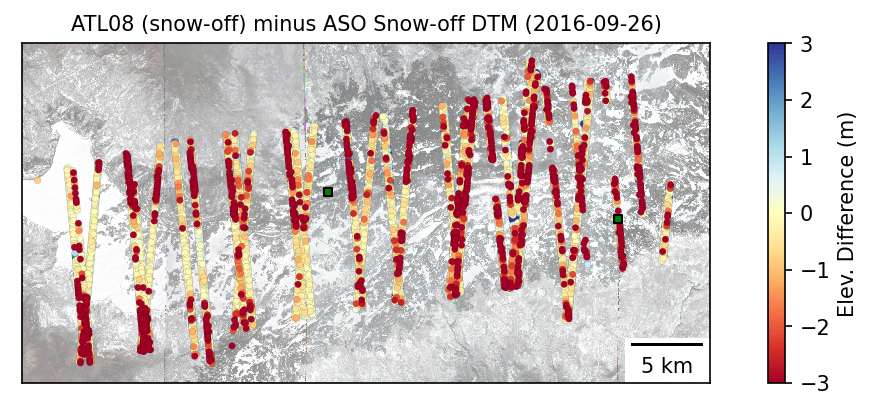

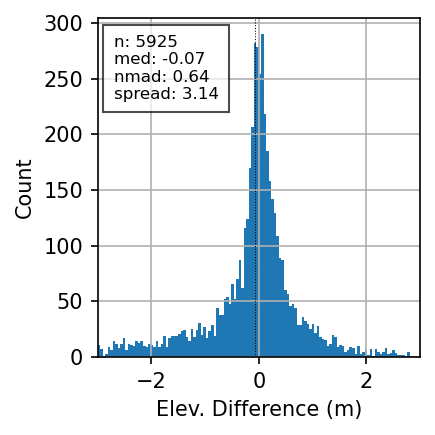

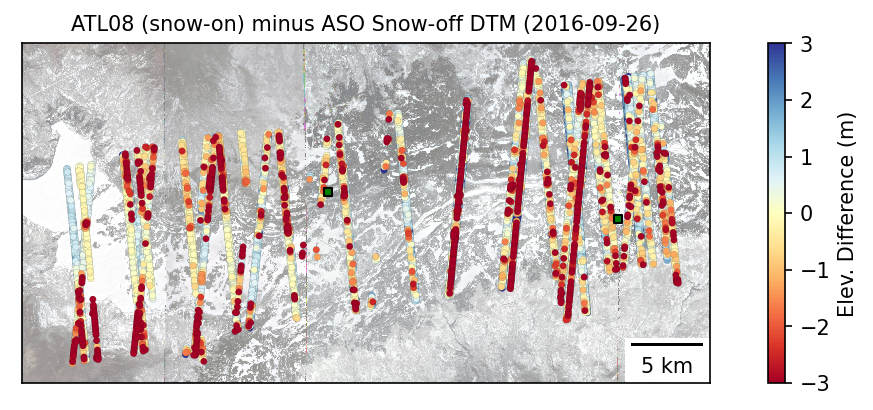

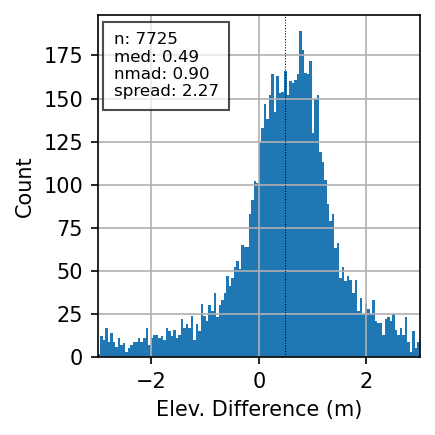

In [245]:
xover_plot2(atl08_crop[atl08_crop_snowfree_idx], atl08_diff_col, asc=asc, clim=clim, title='ATL08 (snow-off) minus ASO Snow-off DTM (2016-09-26)')
print(atl08_crop[atl08_crop_snowfree_idx][atl08_diff_col].describe())
xover_plot2(atl08_crop[~atl08_crop_snowfree_idx], atl08_diff_col, asc=asc, clim=clim, title='ATL08 (snow-on) minus ASO Snow-off DTM (2016-09-26)')
print(atl08_crop[~atl08_crop_snowfree_idx][atl08_diff_col].describe())

In [246]:
#xover_plot2(atl08_crop[atl08_nphoton_idx], atl08_diff_col, asc=asc, clim=clim, title='ATL08 (snow-off) minus ASO Snow-off DTM (2016-09-26)')
#atl08_crop[atl08_nphoton_idx][atl08_diff_col].describe()
#xover_plot2(atl08_crop[atl08_terrain_slope_idx * atl08_nphoton_idx], atl08_diff_col, asc=asc, clim=clim, title='ATL08 (snow-off) minus ASO Snow-off DTM (2016-09-26)')
#atl08_crop[atl08_terrain_slope_idx * atl08_nphoton_idx][atl08_diff_col].describe()

## GEDI snow-on/snow-off

In [247]:
gedi_dates_valid = pd.to_datetime(gedi_crop['acqdate'].unique(), utc=True)
#gedi_dates_valid = pd.to_datetime(gedi_crop[gedi_diff_col].dropna().index.date, utc=True).unique()

In [248]:
idx = (snotel_df[sitecode_list].loc[gedi_dates_valid] < snotel_depth_thresh).any(axis=1)
idx = idx[idx]
gedi_crop_snowfree_idx = gedi_crop.index.normalize().isin(idx.index.date)

In [249]:
gedi_crop[gedi_crop_snowfree_idx]['acqdate'].value_counts()

2020-09-19    6762
2020-09-11    5343
2021-07-24    5042
2019-10-28    4917
2020-05-13    4661
2020-10-13    4480
2020-05-21    4415
2019-08-18    4400
2020-07-22    4387
2020-09-07    4270
2019-07-12    4063
2020-07-26    3768
2020-10-09    3501
2020-10-16    3180
2019-08-21    3114
2019-07-08    3113
2019-09-05    3064
2020-09-15    2589
2020-09-23    2575
2020-08-30    2309
2019-09-28    2255
2019-10-20    2145
2020-08-18    2014
2020-11-05    1442
2020-08-14    1214
2021-07-31     895
2020-08-26     765
2019-09-24     671
2020-05-25     372
2020-09-27     254
2019-11-16     115
2019-10-01      74
2020-08-22      35
2019-09-09      28
Name: acqdate, dtype: int64

count    19019.000000
mean         0.380287
std          3.837110
min        -90.770996
25%         -0.211182
50%          1.037842
75%          1.924561
max         37.099609
Name: elev_lowestmode ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64

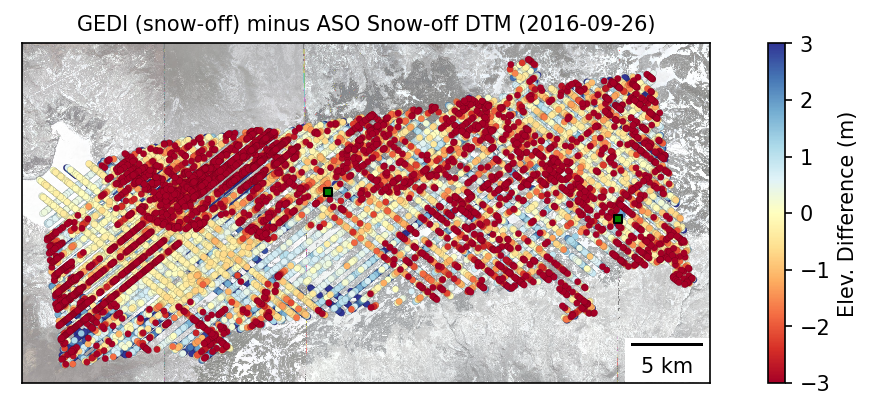

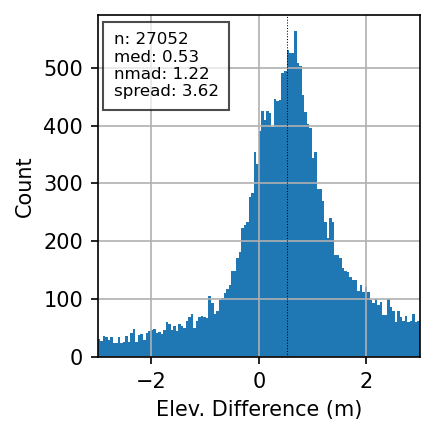

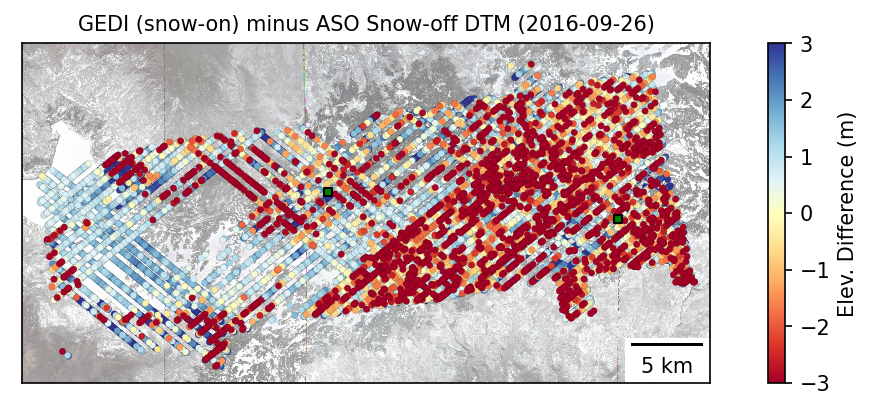

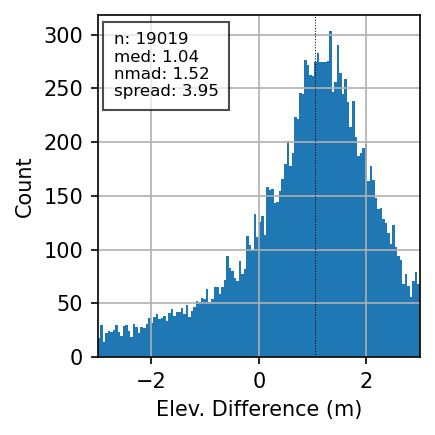

In [250]:
xover_plot2(gedi_crop[gedi_crop_snowfree_idx], gedi_diff_col, asc=asc, clim=clim, title='GEDI (snow-off) minus ASO Snow-off DTM (2016-09-26)')
gedi_crop[gedi_crop_snowfree_idx][gedi_diff_col].describe()
xover_plot2(gedi_crop[~gedi_crop_snowfree_idx], gedi_diff_col, asc=asc, clim=clim, title='GEDI (snow-on) minus ASO Snow-off DTM (2016-09-26)')
gedi_crop[~gedi_crop_snowfree_idx][gedi_diff_col].describe()

## ATL06-SR snow-on/snow-off

In [251]:
atl06sr_dates_valid = pd.to_datetime(atl06sr_crop['acqdate'].unique(), utc=True)
#gedi_dates_valid = pd.to_datetime(gedi_crop[gedi_diff_col].dropna().index.date, utc=True).unique()

In [252]:
idx = (snotel_df[sitecode_list].loc[atl06sr_dates_valid] < snotel_depth_thresh).any(axis=1)
idx = idx[idx]
atl06sr_crop_snowfree_idx = atl06sr_crop.index.normalize().isin(idx.index.date)

In [253]:
atl06sr_crop[atl06sr_crop_snowfree_idx]['acqdate'].value_counts()

2019-11-14    9064
2020-06-10    7267
2019-09-13    4625
2020-07-09    4569
2021-07-07    3874
2019-11-12    3680
2019-07-17    1871
2020-08-12    1718
2021-06-08    1439
2020-10-08    1259
2019-10-10     625
2020-07-14     558
2020-06-11     478
2020-05-13     382
2020-08-11     336
2019-09-11     320
2021-06-10     139
2020-05-12       9
2021-07-12       9
Name: acqdate, dtype: int64

count    13904.000000
mean         0.074817
std          0.947014
min        -22.678756
25%         -0.156125
50%          0.050352
75%          0.322857
max          7.351457
Name: h_mean ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64
count    24345.000000
mean         0.603919
std          1.753100
min        -47.598429
25%          0.108287
50%          0.631037
75%          1.168448
max         74.854247
Name: h_mean ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64


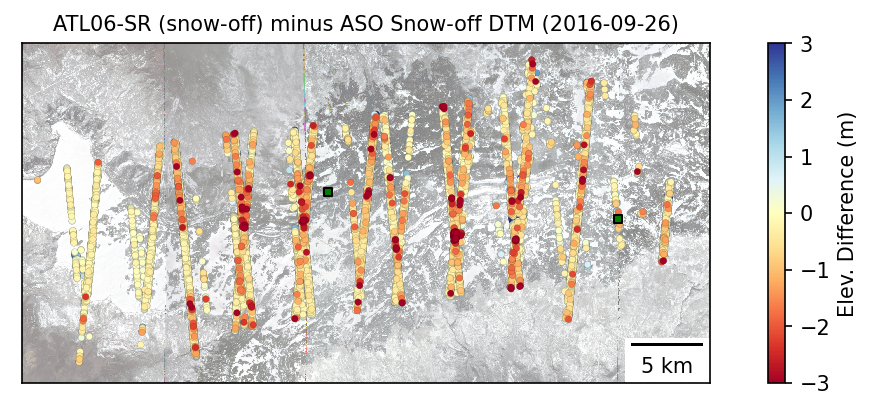

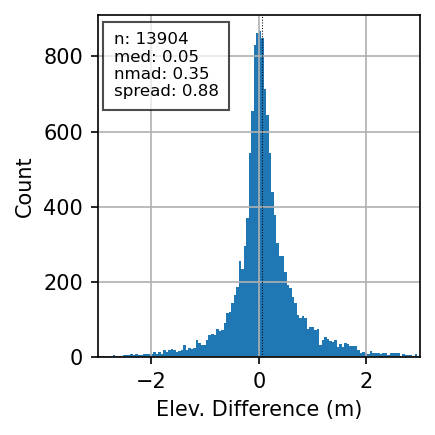

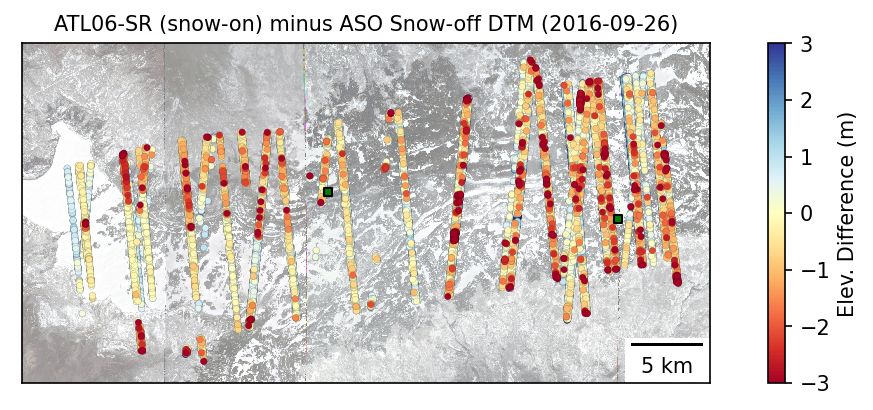

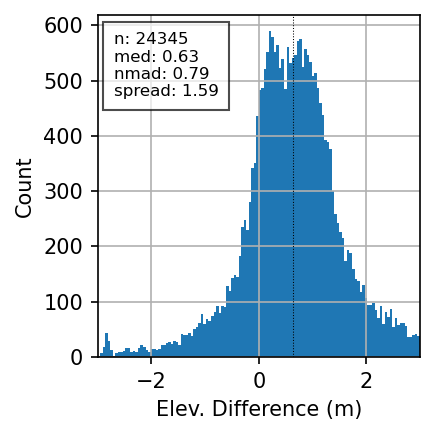

In [254]:
xover_plot2(atl06sr_crop[atl06sr_crop_snowfree_idx], atl06sr_diff_col, asc=asc, clim=clim, title='ATL06-SR (snow-off) minus ASO Snow-off DTM (2016-09-26)')
print(atl06sr_crop[atl06sr_crop_snowfree_idx][atl06sr_diff_col].describe())
xover_plot2(atl06sr_crop[~atl06sr_crop_snowfree_idx], atl06sr_diff_col, asc=asc, clim=clim, title='ATL06-SR (snow-on) minus ASO Snow-off DTM (2016-09-26)')
print(atl06sr_crop[~atl06sr_crop_snowfree_idx][atl06sr_diff_col].describe())

## Plot individual dates over corresponding MODIS images

In [516]:
import matplotlib.gridspec as gridspec
import matplotlib.ticker as ticker

In [548]:
def xover_plot3(df, col, asc=True, clim=(-10,10), title=None, dpi=150, framenum=None, outdir=None):
    #markersize=300/atl08_crop['aso_snowoff_sample_dt_diff']
    idx = df.loc[:,col].notna()
    if idx.any():
        f, axa = plt.subplots(1,2, figsize=(10,3), gridspec_kw={'width_ratios': [3, 1]}, dpi=dpi)
        plot_kw = {'markersize':10, 'edgecolor':'k', 'lw':0.1}
        #plot_kw = {'markersize':10}
        df.loc[idx].sort_values(by=col, ascending=asc).plot(ax=axa[0], column=col, cmap='RdYlBu', vmin=clim[0], vmax=clim[1], \
                                                            legend=True, legend_kwds={"label":'Elev. Difference (m)'}, \
                                                            **plot_kw)
        snotel_site_gdf.plot(ax=axa[0], marker='s', markersize=15, edgecolor='k', color='g')
        aso_gdf.iloc[0:1].plot(ax=axa[0], facecolor='None', edgecolor='k', lw=0.5)
        axa[0].autoscale(False)

        ts = pd.to_datetime(df.loc[idx]['acqdate']).dt.strftime('%Y-%m-%d').iloc[0]
        print(ts)
        basemap = cx.providers.NASAGIBS.ModisTerraTrueColorCR
        #basemap.update({'time':"2019-03-15"})
        basemap.update({'time':ts})
        cx.add_basemap(axa[0], alpha=1.0, attribution=False, crs=df.crs.to_string(), zoom=9, source=basemap)

        axa[0].add_artist(ScaleBar(1, location='lower right'))
        if title:
            axa[0].set_title(title)
        pltlib.hide_ticks(axa[0])
        #plt.tight_layout()

        #f2, ax2 = plt.subplots(figsize=(3,3), dpi=dpi)
        df.loc[idx,col].hist(ax=axa[1], bins=128, range=clim)
        axa[1].set_xlim(*clim)
        axa[1].set_xlabel('Elev. Difference (m)')
        axa[1].set_ylabel('Count')
        axa[1].set_ylim(0,100)
        #y_labels = axa[1].get_yticks()
        #axa[1].yaxis.set_major_formatter(ticker.FormatStrFormatter('%02d'))
        plt.tight_layout()
        if outdir is not None:
            out_fn = os.path.join(outdir, f'{framenum:03d}'+'.jpg')
            plt.savefig(out_fn, bbox_inches='tight', pad_inches=0.1)
    else:
        print(f"No valid points: {title}")

In [513]:
#atl08_crop[col].dropna()
atl08_dates_valid = pd.to_datetime(atl08_crop[atl08_diff_col].dropna().index.date, utc=True).unique()

2018-11-15


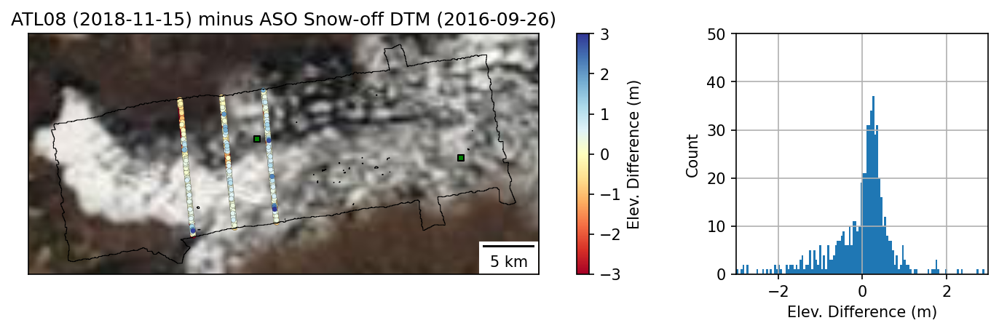

In [528]:
i = atl08_dates_valid.date[2]
xover_plot3(atl08_crop.loc[str(i)], atl08_diff_col, framenum=0, clim=(-3, 3), title=f'ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=150)
#xover_plot3(atl08_crop.loc[str(i)], atl08_diff_col, asc=False, clim=(-3, 3), title=f'ICESat-2 ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=72)

In [ ]:
outdir='gm_gedi_movie'
os.makedirs(outdir)

In [ ]:
n = 0
for i in gedi_dates_valid.date:
    if gedi_crop.loc[str(i)][gedi_diff_col].notna().any():
        xover_plot3(gedi_crop.loc[str(i)], gedi_diff_col, framenum=n, clim=(-3, 3), \
                    title=f'GEDI ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=150, outdir=outdir)
        n += 1

In [ ]:
!ffmpeg -r 3 -i $outdir/%3d.jpg -y -an -vf "crop=trunc(iw/2)*2:trunc(ih/2)*2" -c:v libx264 -pix_fmt yuv420p $outdir'.mp4'

In [ ]:
#!ffmpeg -y -f image2 -r 3 -i $outdir/%3d.jpg -vf "crop=trunc(iw/2)*2:trunc(ih/2)*2" $outdir'.mp4'

2018-11-15
2018-11-15


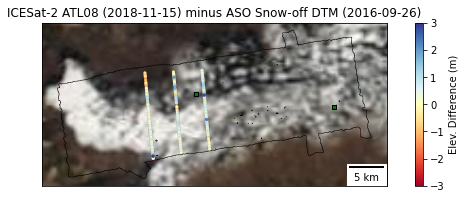

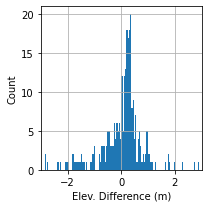

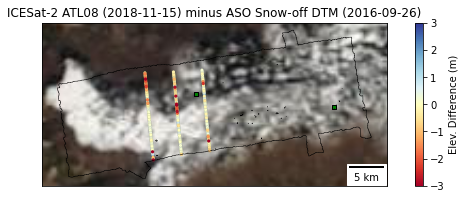

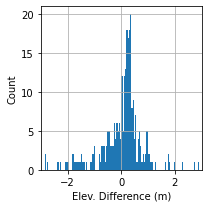

In [535]:
i = atl08_dates_valid.date[0]
xover_plot3(atl08_crop[atl08_crop_fullpower_idx].loc[str(i)], atl08_diff_col, clim=(-3, 3), title=f'ICESat-2 ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=72)
xover_plot3(atl08_crop[atl08_crop_fullpower_idx].loc[str(i)], atl08_diff_col, asc=False, clim=(-3, 3), title=f'ICESat-2 ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=72)

2018-11-15
2018-11-15
2018-12-13
2018-12-13
2018-12-14
2018-12-14
2019-03-15
2019-03-15
2019-06-12
2019-06-12


/tmp/ipykernel_93486/1953649128.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax = plt.subplots(figsize=(10,3), dpi=dpi)


2019-06-14
2019-06-14
2019-09-11
2019-09-11
2019-09-13
2019-09-13
2019-10-10
2019-10-10
2019-11-12
2019-11-12
2019-11-14
2019-11-14
2019-12-11
2019-12-11
2020-02-12
2020-02-12
2020-03-11
2020-03-11
2020-04-09
2020-04-09
2020-04-14
2020-04-14
2020-05-13
2020-05-13
2020-06-10
2020-06-10
2020-06-11
2020-06-11
2020-07-09
2020-07-09
2020-07-14
2020-07-14
2020-08-12
2020-08-12
2020-11-11
2020-11-11
2020-12-10
2020-12-10
2021-01-06
2021-01-06
2021-03-09
2021-03-09
2021-03-11
2021-03-11
2021-04-09
2021-04-09
2021-05-12
2021-05-12
2021-06-08
2021-06-08
2021-06-10
2021-06-10
2021-07-07
2021-07-07


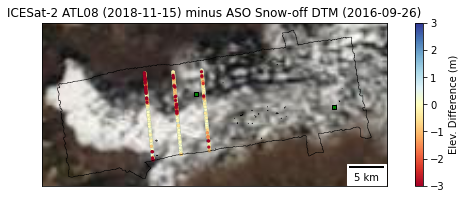

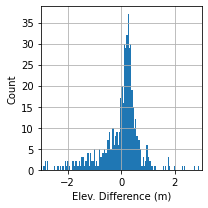

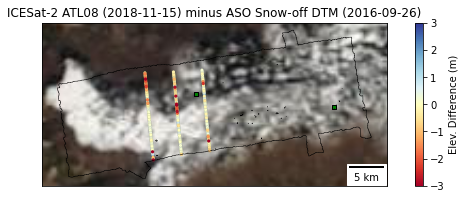

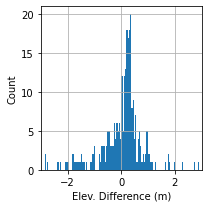

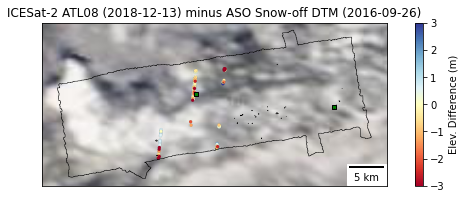

...

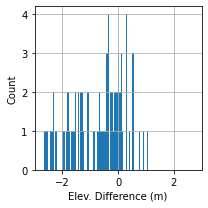

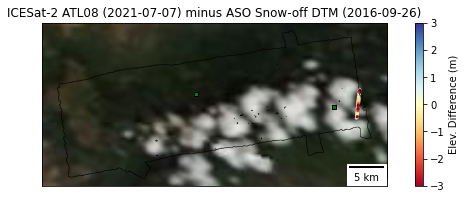

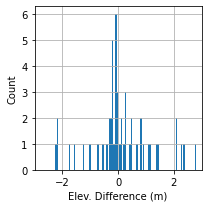

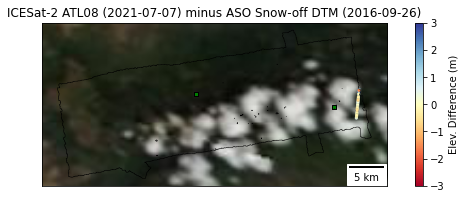

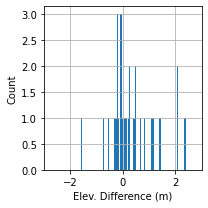

In [536]:
for i in atl08_dates_valid.date:
    xover_plot3(atl08_crop.loc[str(i)], atl08_diff_col, asc=False, clim=(-3, 3), title=f'ICESat-2 ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=72)
    xover_plot3(atl08_crop[atl08_crop_fullpower_idx].loc[str(i)], atl08_diff_col, asc=False, clim=(-3, 3), title=f'ICESat-2 ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=72)

/tmp/ipykernel_93486/603882714.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax = plt.subplots(figsize=(10,3), dpi=dpi)


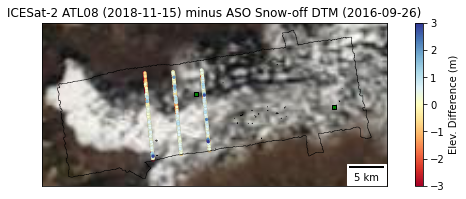

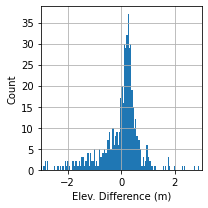

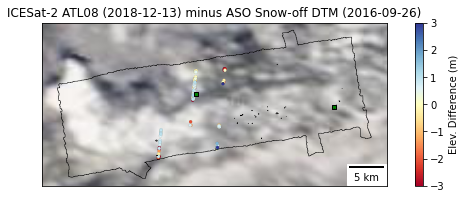

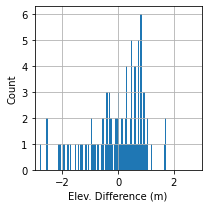

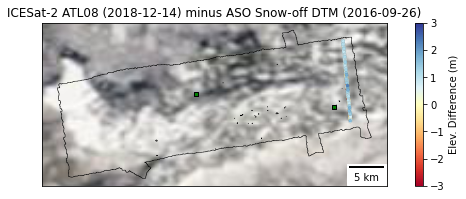

...

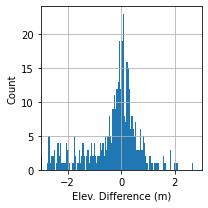

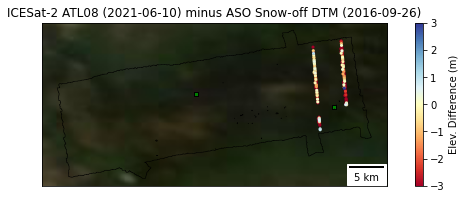

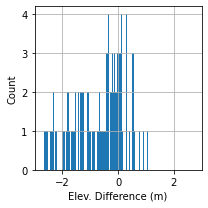

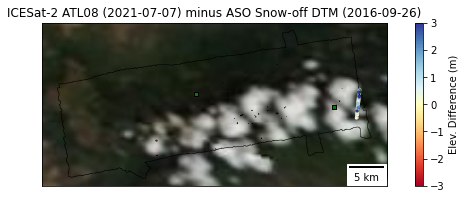

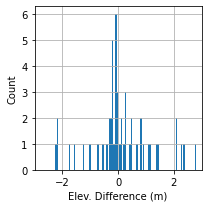

In [289]:
for i in atl08_dates_valid.date:
    xover_plot3(atl08_crop.loc[str(i)], atl08_diff_col, clim=(-3, 3), title=f'ICESat-2 ATL08 ({str(i)}) minus ASO Snow-off DTM (2016-09-26)', dpi=72)

## Clip to radius around SNOTEL locaitons

In [290]:
r = 10000 #m

<AxesSubplot:>

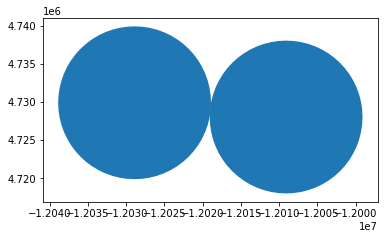

In [291]:
snotel_site_gdf.buffer(r).plot()

## Time series, aggregated by acqdate

In [255]:
dt_min_plot = '2018-09-01'
dt_max_plot = '2021-09-01'

(-20.0, 20.0)

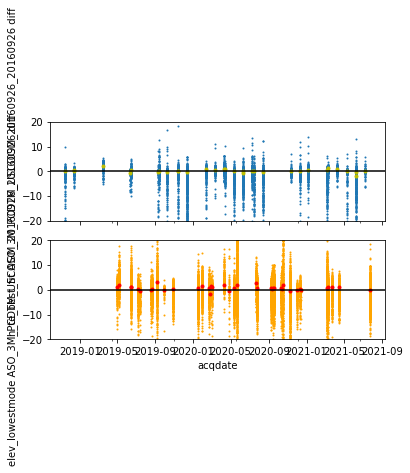

In [256]:
f, axa = plt.subplots(2,1, sharex=True, sharey=True)
pd.DataFrame(atl08_crop.drop(columns='geometry')).plot(ax=axa[0], x='acqdate', y=atl08_diff_col, kind='scatter', s=1)
pd.DataFrame(atl08_crop.drop(columns='geometry')).groupby('acqdate').median()[atl08_diff_col].plot(ax=axa[0], marker='o', markersize=3, lw=0, color='y')
pd.DataFrame(gedi_crop.drop(columns='geometry')).plot(ax=axa[1], x='acqdate', y=gedi_diff_col, kind='scatter', color='orange', s=1)
pd.DataFrame(gedi_crop.drop(columns='geometry')).groupby('acqdate').median()[gedi_diff_col].plot(ax=axa[1], marker='o', markersize=3, lw=0, color='r')
axa[0].axhline(0, color='k')
axa[1].axhline(0, color='k')
axa[0].set_ylim(-20, 20)

In [149]:
def altimetry_ts_plot(df, col, title):
    #f, ax = plt.subplots(figsize=(4,3), dpi=150)
    f, ax = plt.subplots(figsize=(6,4), dpi=150)
    pd.DataFrame(df.drop(columns='geometry')).plot(ax=ax, x='acqdate', y=col, kind='scatter', s=1, color='r', alpha=0.01)
    #mad = pd.DataFrame(df.drop(columns='geometry')).groupby('acqdate').mad()[col]
    label = None
    if 'ATL08' in title:
        label = 'ATL08'
    elif 'GEDI' in title:
        label = 'GEDI'
    elif 'ATL06-SR' in title:
        label = 'ATL06-SR'
    label = ''
    df_med = pd.DataFrame(df.drop(columns='geometry')).groupby('acqdate').median()[col]
    df_med.plot(ax=ax, marker='o', markersize=4, markeredgecolor='k', markeredgewidth=0.5, lw=0, color='r', label=label)
    ax.autoscale(False)
    #snotel_df.plot(ax=ax, color='gray', lw=0.5, label='SNOTEL')
    snotel_df.plot(ax=ax, color='gray', lw=0.5, style=['--','-'])
    ax.axhline(0, color='k', lw=0.5)
    ax.yaxis.set_minor_locator(AutoMinorLocator())
    #ax.xaxis.set_minor_locator(AutoMinorLocator())
    #ax.tick_params(which='minor')
    ax.set_ylim(-8, 8)
    ax.set_ylabel('Elevation difference (m)')
    ax.set_xlim(dt_min_plot, dt_max_plot)
    ax.set_title(title)
    ax.format_xdata = mdates.DateFormatter('%Y-%m-%d')
    f.autofmt_xdate()
    #ax.legend(loc='upper right', fontsize=6)
    ax.legend(loc='upper right')
    ax.grid(axis='y', which='major', alpha=0.5)
    #plt.tight_layout()

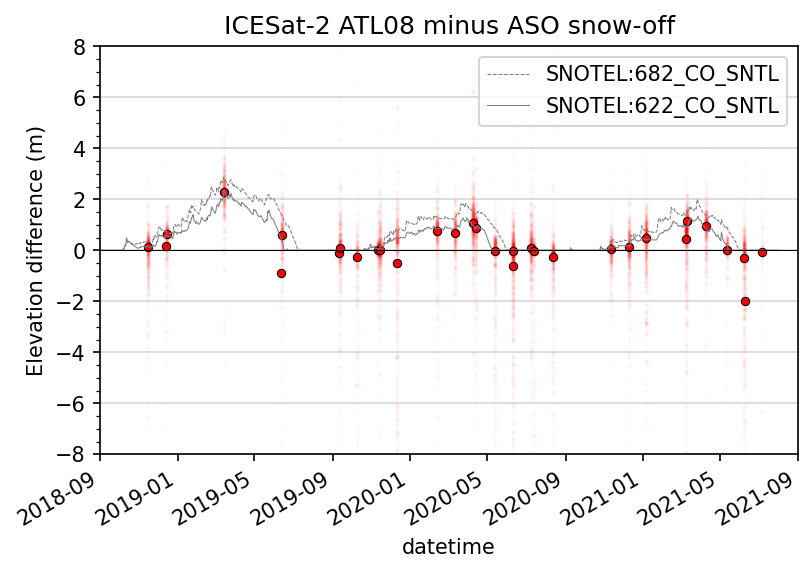

In [899]:
altimetry_ts_plot(atl08_crop, atl08_diff_col, title='ICESat-2 ATL08 minus ASO snow-off')

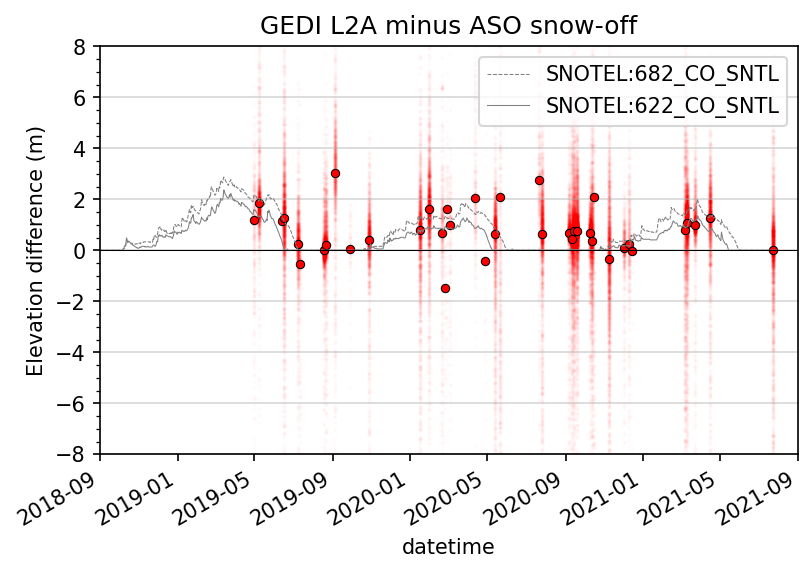

In [900]:
altimetry_ts_plot(gedi_crop, gedi_diff_col, title='GEDI L2A minus ASO snow-off')

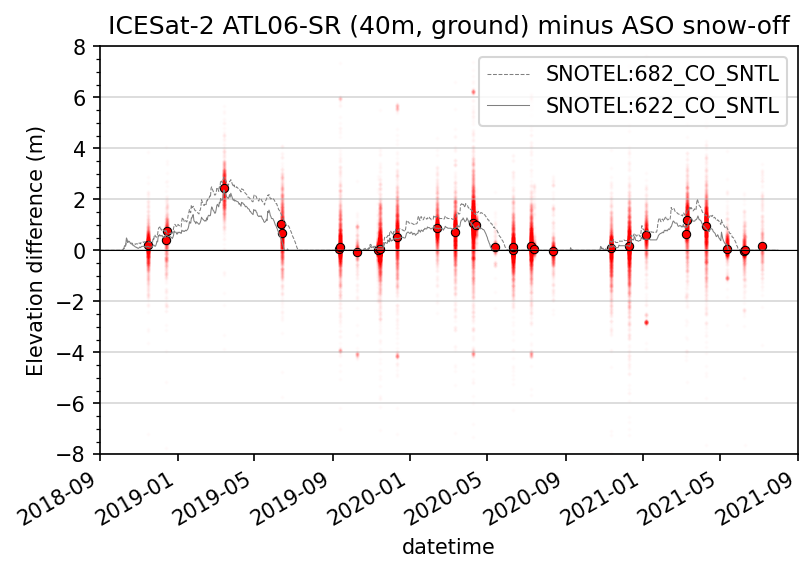

In [901]:
altimetry_ts_plot(atl06sr_crop, atl06sr_diff_col, title='ICESat-2 ATL06-SR (40m, ground) minus ASO snow-off')

# Filter outliers

In [378]:
#from scipy.stats import zscore

In [379]:
atl08_crop['zscore'] = (atl08_crop[atl08_diff_col] - atl08_crop[atl08_diff_col].mean()) / atl08_crop[atl08_diff_col].std()

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [380]:
atl08_crop[atl08_diff_col].describe()

count    12413.000000
mean        -0.841981
std          6.103768
min       -295.152832
25%         -0.513184
50%          0.135498
75%          0.790527
max         67.861328
Name: h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff, dtype: float64

In [381]:
gedi_crop['zscore'] = (gedi_crop[gedi_diff_col] - gedi_crop[gedi_diff_col].mean()) / gedi_crop[gedi_diff_col].std()

(-5.0, 5.0)

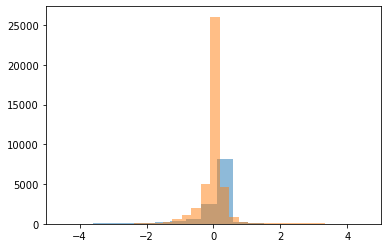

In [382]:
f, ax = plt.subplots()
ax.hist(atl08_crop['zscore'], bins=128, alpha=0.5)
ax.hist(gedi_crop['zscore'], bins=128, alpha=0.5)
ax.set_xlim(-5, 5)

In [383]:
zscore_thresh = 3
absdiff_thresh = 5.0

In [384]:
#idx = (atl08_crop['zscore'].abs() <= zscore_thresh)

In [385]:
#idx = (atl08_crop[col].abs() <= absdiff_thresh)

In [394]:
atl08_idx = (atl08_crop['zscore'].abs() <= zscore_thresh) & (atl08_crop[atl08_diff_col].abs() <= absdiff_thresh)

In [397]:
atl08_idx.value_counts()

True     11355
False    10713
dtype: int64

In [400]:
gedi_col

'elev_lowestmode'

In [395]:
gedi_idx = (gedi_crop['zscore'].abs() <= zscore_thresh) & (gedi_crop[gedi_diff_col].abs() <= absdiff_thresh)

In [398]:
gedi_idx.value_counts()

True     36964
False    32351
dtype: int64

In [860]:
atl08_crop_idx_combined = atl08_terrain_slope_idx * atl08_nphoton_idx

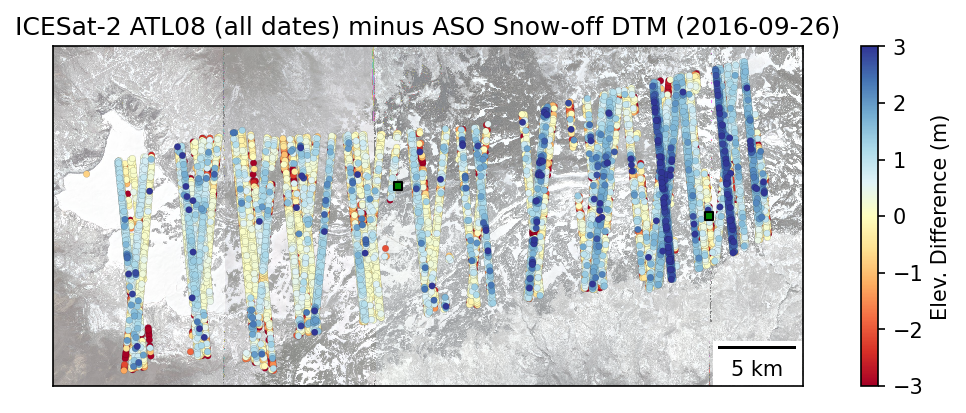

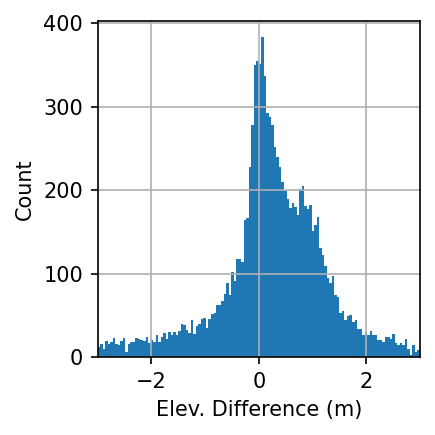

In [572]:
xover_plot2(atl08_crop[atl08_idx], atl08_diff_col, clim=(-3, 3), title='ICESat-2 ATL08 (all dates) minus ASO Snow-off DTM (2016-09-26)')

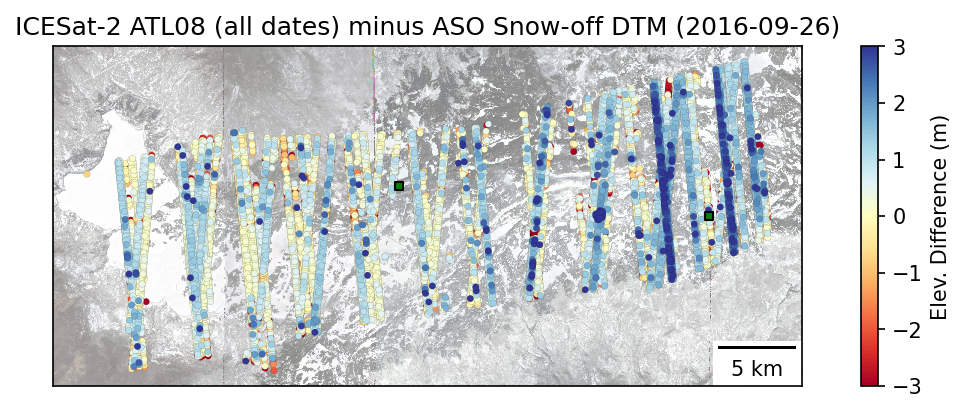

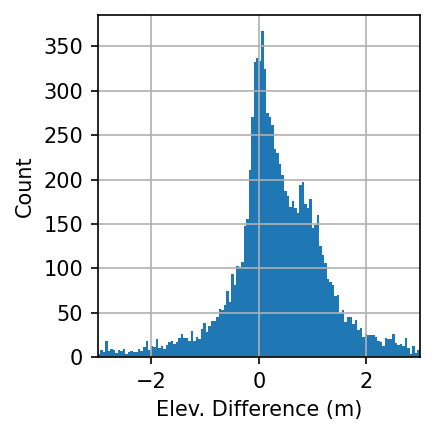

In [861]:
xover_plot2(atl08_crop[atl08_crop_idx_combined], atl08_diff_col, clim=(-3, 3), title='ICESat-2 ATL08 (all dates) minus ASO Snow-off DTM (2016-09-26)')

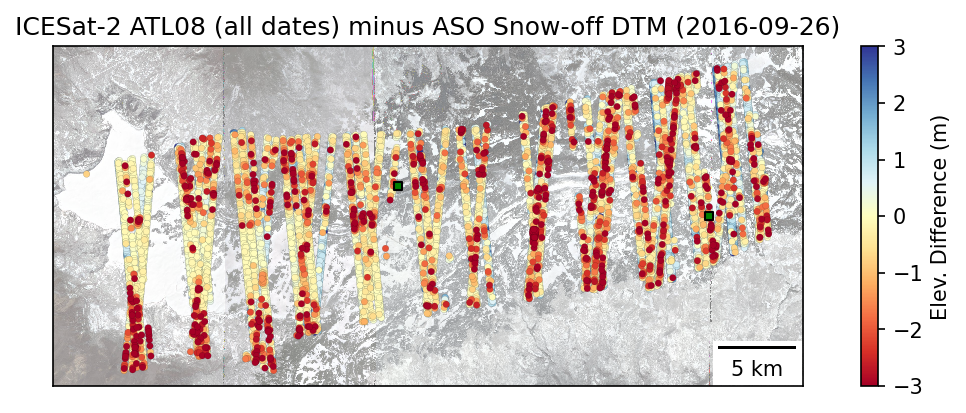

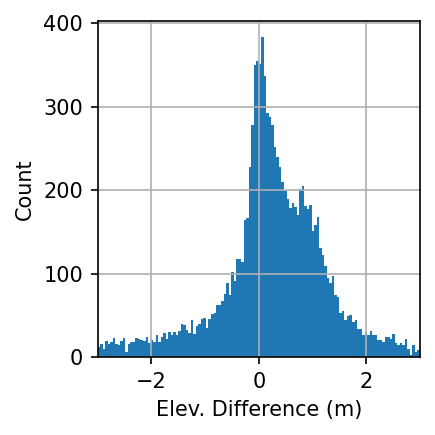

In [574]:
xover_plot2(atl08_crop[atl08_idx], atl08_diff_col, asc=False, clim=(-3, 3), title='ICESat-2 ATL08 (all dates) minus ASO Snow-off DTM (2016-09-26)')

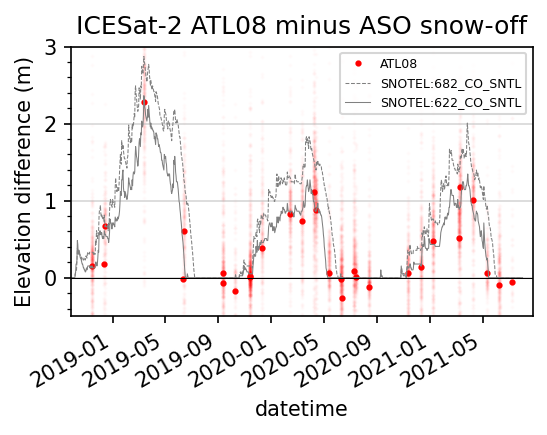

In [426]:
altimetry_ts_plot(atl08_crop[atl08_idx], atl08_diff_col, title='ICESat-2 ATL08 minus ASO snow-off')

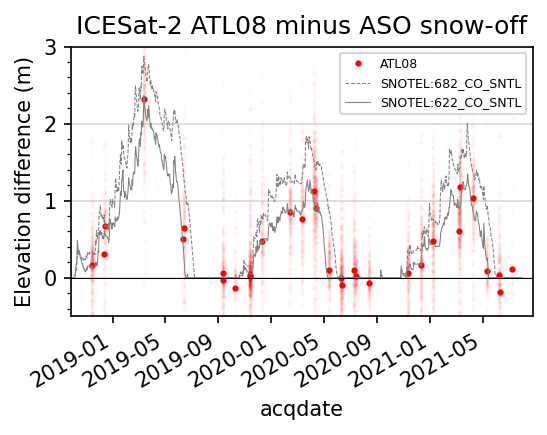

In [862]:
altimetry_ts_plot(atl08_crop[atl08_crop_idx_combined], atl08_diff_col, title='ICESat-2 ATL08 minus ASO snow-off')

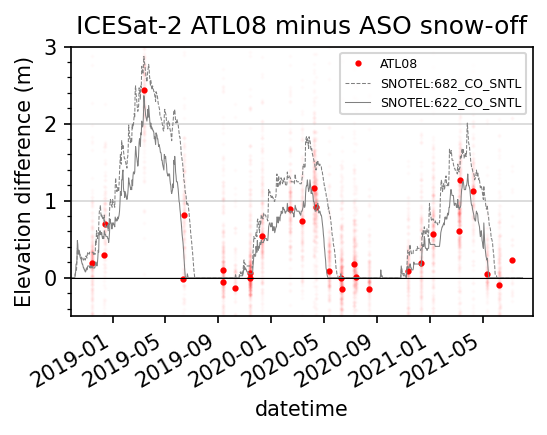

In [430]:
altimetry_ts_plot(atl08_crop[atl08_crop_fullpower_idx*atl08_idx], atl08_diff_col, title='ICESat-2 ATL08 minus ASO snow-off')

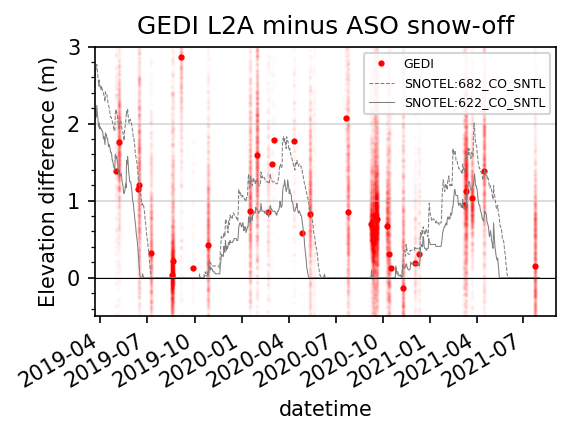

In [427]:
altimetry_ts_plot(gedi_crop[gedi_idx], gedi_diff_col, title='GEDI L2A minus ASO snow-off')

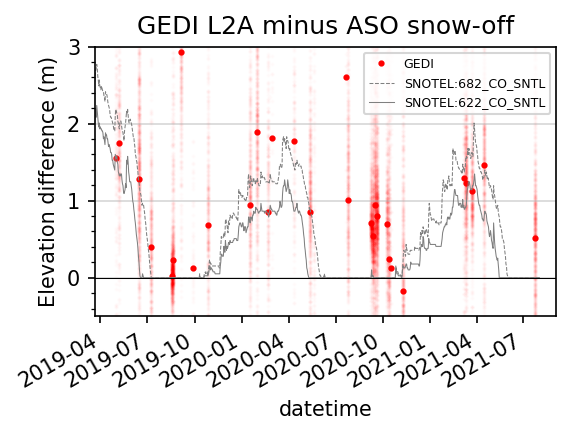

In [429]:
altimetry_ts_plot(gedi_crop[gedi_crop_fullpower_idx*gedi_idx], gedi_diff_col, title='GEDI L2A minus ASO snow-off')

## Stats aggregation

In [ ]:
df = atl06sr_crop
col = atl06sr_diff_col

In [ ]:
snotel_df.index = pd.to_datetime(snotel_df.index.date)
snotel_df['SNOTEL_mean'] = snotel_df.mean(axis=1)

In [461]:
snotel_df

,SNOTEL:682_CO_SNTL,SNOTEL:622_CO_SNTL,SNOTEL_mean
2016-06-01,0.9398,0.3810,0.6604
2016-06-02,0.8890,0.3048,0.5969
2016-06-03,0.8128,0.2286,0.5207
2016-06-04,0.7620,0.1270,0.4445
2016-06-05,0.6604,0.0762,0.3683
...,...,...,...
2021-07-28,0.0000,0.0000,0.0000
2021-07-29,0.0000,0.0000,0.0000
2021-07-30,0.0000,0.0000,0.0000
2021-07-31,0.0000,0.0000,0.0000


In [472]:
def stats_agg(df, col, snotel_col='SNOTEL_mean', title=None):
    stats = df.groupby('acqdate')[col].aggregate(['median', nmad, p16, p84, 'count']).dropna()
    stats.index = pd.to_datetime(stats.index)

    stats_snotel_join = stats.join(snotel_df)
    add_dowy(stats_snotel_join)

    stat_col = 'median'
    out_col = f'{stat_col} - {snotel_col}'
    stats_snotel_join[out_col] = stats_snotel_join[stat_col] - stats_snotel_join[snotel_col]

    #(stats_snotel_join.iloc[:,-3:]**2).mean()**.5
    #stats_snotel_join.iloc[:,-3:].describe()
    #stats_snotel_join.iloc[:,-3:].plot(kind='bar')
    
    SS_tot = ((stats_snotel_join[stat_col] - stats_snotel_join[stat_col].mean())**2).sum()
    SS_res = (stats_snotel_join[out_col]**2).sum()
    R2 = 1 - (SS_res/SS_tot)

    RMSE = (stats_snotel_join[out_col]**2).mean()**.5
    bias = stats_snotel_join[out_col].mean()

    f, ax = plt.subplots()
    stats_snotel_join.plot(ax=ax, kind='scatter', x=snotel_col, y='median', c='dowy', cmap='twilight')
    ax.plot(np.arange(0,4), np.arange(0,4), color='r', lw=0.5)
    ax.set_aspect('equal')
    if title is None:
        title = f'{col}\n daily median vs. daily SNOTEL SD' 
    ax.set_title(title)
    ax.set_ylabel(f'Daily aggregated {stat_col} SD (m)')
    ax.set_xlabel(f'{snotel_col} daily SD (m)')
    df_str = f'n: {stats_snotel_join.shape[0]}\nbias: {bias:+0.2f}\nRMSE: {RMSE:0.2f}\n$R^2$: {R2:0.2f}'
    ax.text(0.05, 0.95, df_str, va='top', color='k', transform=ax.transAxes, fontsize=10, \
                bbox={'facecolor': 'w', 'alpha': 0.5, 'pad': 5})
    
    #return stats_snotel_join

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


Adding Day of Water Year (DOWY)


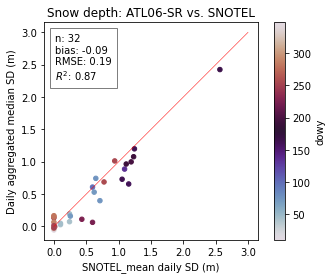

In [473]:
stats_agg(atl06sr_crop, atl06sr_diff_col, title='Snow depth: ATL06-SR vs. SNOTEL')

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


Adding Day of Water Year (DOWY)


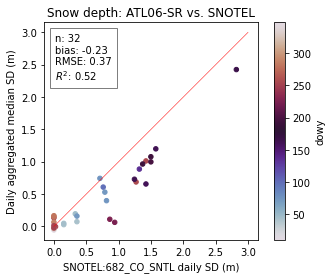

In [474]:
stats_agg(atl06sr_crop, atl06sr_diff_col, 'SNOTEL:682_CO_SNTL', title='Snow depth: ATL06-SR vs. SNOTEL')

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


Adding Day of Water Year (DOWY)


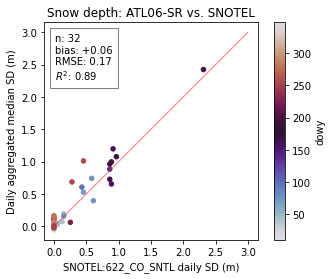

In [475]:
stats_agg(atl06sr_crop, atl06sr_diff_col, 'SNOTEL:622_CO_SNTL', title='Snow depth: ATL06-SR vs. SNOTEL')

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


Adding Day of Water Year (DOWY)


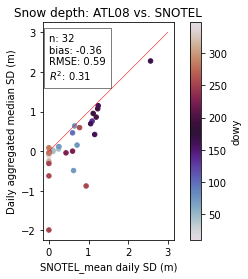

In [476]:
stats_agg(atl08_crop, atl08_diff_col, title='Snow depth: ATL08 vs. SNOTEL')

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


Adding Day of Water Year (DOWY)


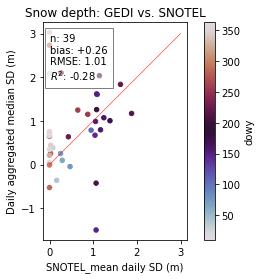

In [477]:
stats_agg(gedi_crop, gedi_diff_col, title='Snow depth: GEDI vs. SNOTEL')

# Old

In [786]:
df2 = pd.DataFrame(atl08_crop.drop(columns='geometry')).groupby('acqdate')[atl08_diff_col].aggregate(['median', nmad, p16, p84, 'count']).dropna()

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


In [750]:
#df2 = pd.DataFrame(atl08_crop.drop(columns='geometry')).groupby('acqdate')[[atl08_diff_col, atl08_slope_col]].aggregate(['mean', 'std', 'median', nmad, p16, p84, 'count']).dropna()

In [787]:
df2 = pd.DataFrame(gedi_crop.drop(columns='geometry')).groupby('acqdate')[gedi_diff_col].aggregate(['median', nmad, p16, p84, 'count']).dropna()

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1374: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(


In [756]:
df2['spread'] = df2['p84'] - df2['p16']

In [757]:
df2

,median,nmad,p16,p84,count,spread
acqdate,,,,,,
2019-05-01,1.382080,1.542507,-0.744121,2.610078,278,3.354199
2019-05-08,1.766846,0.623663,1.157559,2.487148,1225,1.329590
2019-06-13,1.153076,2.348419,-1.949922,2.230186,3,4.180107
2019-06-16,1.209351,1.237734,-0.148350,2.512646,1618,2.660996
2019-07-08,0.324341,0.811884,-0.628037,1.232354,1028,1.860391
2019-07-12,-0.567871,0.813694,-2.865371,0.152383,23,3.017754
2019-08-18,0.030640,0.403408,-0.391846,0.641016,1536,1.032861
2019-08-21,0.217041,0.409743,-0.090029,1.208047,1247,1.298076
2019-09-05,2.865234,1.253660,1.044189,4.009443,902,2.965254


<AxesSubplot:xlabel='count', ylabel='spread'>

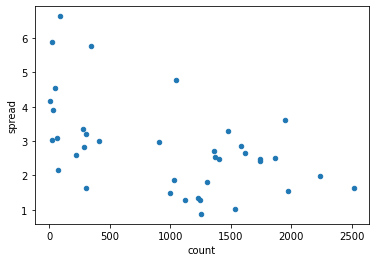

In [758]:
df2.plot.scatter(x='count', y='spread')

In [759]:
errors = pd.DataFrame([df2['median'] - df2['p16'], df2['p84'] - df2['median']]).abs()
errors

acqdate,2019-05-01,2019-05-08,2019-06-13,2019-06-16,2019-07-08,2019-07-12,2019-08-18,2019-08-21,2019-09-05,2019-09-28,...,2020-10-13,2020-10-16,2020-11-09,2020-12-02,2020-12-10,2021-03-07,2021-03-11,2021-03-23,2021-04-16,2021-07-24
0,2.126201,0.609287,3.102998,1.357700,0.952378,2.297500,0.422485,0.307070,1.821045,1.096553,...,1.713379,3.826743,1.855674,0.887036,1.369263,2.722080,1.15606,0.435010,1.510503,1.442285
1,1.227998,0.720303,1.077109,1.303296,0.908013,0.720254,0.610376,0.991006,1.144209,1.071553,...,1.585293,2.806440,1.771143,0.753784,1.452173,2.042402,0.81728,0.860029,1.026812,1.037500


<ErrorbarContainer object of 3 artists>

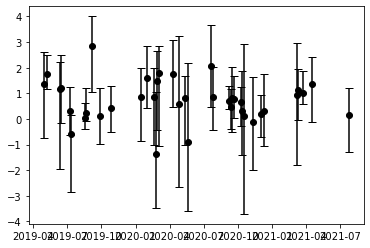

In [760]:
f, ax = plt.subplots()
ax.errorbar(df2.index, y=df2['median'], yerr=errors, fmt='ok', capsize=4)

<AxesSubplot:xlabel='acqdate'>

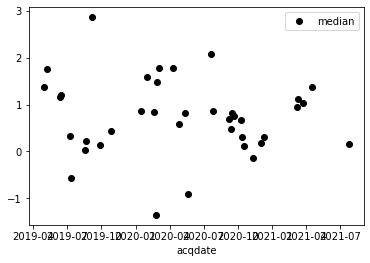

In [761]:
df2.plot(y='median', yerr=df2[['p16', 'p84']], fmt='ok', capsize=3)

<AxesSubplot:xlabel='acqdate'>

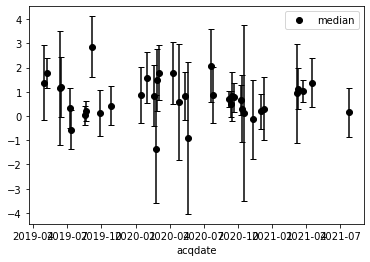

In [762]:
df2.plot(y='median', yerr='nmad', fmt='ok', capsize=3)

In [ ]:
snotel_df.loc[atl08_dates_valid]

## Boxplot

<AxesSubplot:title={'center':'h_te_best_fit ASO_3M_PCDTM_USCOGM_20160926_20160926 diff'}, xlabel='acqdate'>

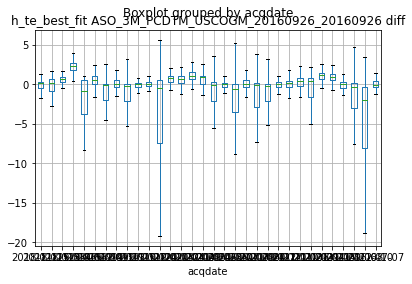

In [886]:
atl08_crop[[atl08_diff_col, 'acqdate']].dropna().boxplot(column=atl08_diff_col, by='acqdate', showfliers=False)

In [433]:
pd.to_datetime(atl08_crop.index.date)

DatetimeIndex(['2018-11-14', '2018-11-14', '2018-11-14', '2018-11-14',
               '2018-11-14', '2018-11-14', '2018-11-14', '2018-11-14',
               '2018-11-14', '2018-11-14',
               ...
               '2021-07-07', '2021-07-07', '2021-07-07', '2021-07-07',
               '2021-07-07', '2021-07-07', '2021-07-07', '2021-07-07',
               '2021-07-07', '2021-07-07'],
              dtype='datetime64[ns]', length=22068, freq=None)

In [432]:
#atl08_crop['acqdate'] = pd.to_datetime(atl08_crop.index.date)

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [435]:
snotel_df.index.rename('acqdate', inplace=True)

In [633]:
atl08_crop.groupby('acqdate').median().index

Index([2018-10-17, 2018-11-14, 2018-11-15, 2018-12-13, 2018-12-14, 2019-01-11,
       2019-02-13, 2019-03-14, 2019-03-15, 2019-04-12, 2019-05-15, 2019-05-16,
       2019-06-12, 2019-06-14, 2019-07-17, 2019-09-11, 2019-09-13, 2019-10-10,
       2019-11-12, 2019-11-14, 2019-12-11, 2020-01-09, 2020-01-15, 2020-02-12,
       2020-03-11, 2020-03-12, 2020-04-09, 2020-04-14, 2020-05-12, 2020-05-13,
       2020-06-10, 2020-06-11, 2020-07-09, 2020-07-14, 2020-08-11, 2020-08-12,
       2020-10-08, 2020-11-09, 2020-11-11, 2020-12-10, 2021-01-06, 2021-03-09,
       2021-03-11, 2021-04-07, 2021-04-09, 2021-05-12, 2021-06-08, 2021-06-10,
       2021-07-07, 2021-07-12],
      dtype='object', name='acqdate')

In [644]:
xpos = atl08_crop.groupby('acqdate').median().index.array
xpos

<PandasArray>
[datetime.date(2018, 10, 17), datetime.date(2018, 11, 14),
 datetime.date(2018, 11, 15), datetime.date(2018, 12, 13),
 datetime.date(2018, 12, 14),  datetime.date(2019, 1, 11),
  datetime.date(2019, 2, 13),  datetime.date(2019, 3, 14),
  datetime.date(2019, 3, 15),  datetime.date(2019, 4, 12),
  datetime.date(2019, 5, 15),  datetime.date(2019, 5, 16),
  datetime.date(2019, 6, 12),  datetime.date(2019, 6, 14),
  datetime.date(2019, 7, 17),  datetime.date(2019, 9, 11),
  datetime.date(2019, 9, 13), datetime.date(2019, 10, 10),
 datetime.date(2019, 11, 12), datetime.date(2019, 11, 14),
 datetime.date(2019, 12, 11),   datetime.date(2020, 1, 9),
  datetime.date(2020, 1, 15),  datetime.date(2020, 2, 12),
  datetime.date(2020, 3, 11),  datetime.date(2020, 3, 12),
   datetime.date(2020, 4, 9),  datetime.date(2020, 4, 14),
  datetime.date(2020, 5, 12),  datetime.date(2020, 5, 13),
  datetime.date(2020, 6, 10),  datetime.date(2020, 6, 11),
   datetime.date(2020, 7, 9),  datetime.da

In [882]:
import seaborn as sns

In [ ]:
#bp_dict = atl08_crop.boxplot(column=atl08_diff_col, by='acqdate', showfliers=False, rot=90, grid=False)

In [879]:
atl08_acqdate_unique = np.sort(atl08_crop['acqdate'].unique().astype("datetime64[D]"))
gedi_acqdate_unique = np.sort(gedi_crop['acqdate'].unique().astype("datetime64[D]"))
atl06sr_acqdate_unique = np.sort(atl06sr_crop['acqdate'].unique().astype("datetime64[D]"))

In [880]:
atl08_acqdate_unique

array(['2018-10-17', '2018-11-14', '2018-11-15', '2018-12-13',
       '2018-12-14', '2019-01-11', '2019-02-13', '2019-03-14',
       '2019-03-15', '2019-04-12', '2019-05-15', '2019-05-16',
       '2019-06-12', '2019-06-14', '2019-07-17', '2019-09-11',
       '2019-09-13', '2019-10-10', '2019-11-12', '2019-11-14',
       '2019-12-11', '2020-01-09', '2020-01-15', '2020-02-12',
       '2020-03-11', '2020-03-12', '2020-04-09', '2020-04-14',
       '2020-05-12', '2020-05-13', '2020-06-10', '2020-06-11',
       '2020-07-09', '2020-07-14', '2020-08-11', '2020-08-12',
       '2020-10-08', '2020-11-09', '2020-11-11', '2020-12-10',
       '2021-01-06', '2021-03-09', '2021-03-11', '2021-04-07',
       '2021-04-09', '2021-05-12', '2021-06-08', '2021-06-10',
       '2021-07-07', '2021-07-12'], dtype='datetime64[D]')

In [ ]:
sns.boxplot(x='acqdate', y=atl08_diff_col, data=atl08_crop, order=atl08_acqdate_unique)

In [ ]:
snotel_df.boxplot(ax=ax, column='SNOTEL:682_CO_SNTL', by='acqdate', showfliers=False, rot=90, grid=False)

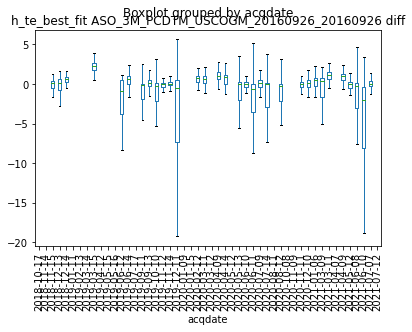

In [860]:
f, ax = plt.subplots()
#snotel_df.plot(ax=ax, color='gray', lw=0.5, label='SNOTEL')
#snotel_df.boxplot(ax=ax, column='SNOTEL:682_CO_SNTL', by='acqdate', showfliers=False, rot=90, grid=False)
bp_dict = atl08_crop.boxplot(ax=ax, column=atl08_diff_col, by='acqdate', showfliers=False, rot=90, grid=False)
#ax.plot(bp_dict)

In [ ]:
f, ax = plt.subplots()
#snotel_df.plot(ax=ax, color='gray', lw=0.5, label='SNOTEL')
atl08_crop.boxplot(ax=ax, column=atl08_diff_col, by='acqdate', showfliers=False, rot=90, grid=False, positions=pos)

In [259]:
import matplotlib.dates as mdates
import matplotlib.cbook as cbook

In [260]:
mpl_epoch = '1970-01-01'

In [261]:
def boxplot_date(df, col, groupby_col='acqdate', clim=(-5, 5)):
    bp_stats = df[[col, groupby_col]].dropna().groupby(groupby_col).apply(cbook.boxplot_stats)
    bp_stats_list = [i[0] for i in bp_stats.values]
    bp_width = df[[col, groupby_col]].dropna().groupby(groupby_col).count().values.ravel()
    bp_width = 20*bp_width/bp_width.max()+5
    pos = (pd.to_datetime(bp_stats.index) - pd.to_datetime(mpl_epoch)).days.values
    
    f, ax = plt.subplots(figsize=(10,5))
    bxp_f = ax.bxp(bp_stats_list, positions=pos, showfliers=False, showcaps=False, whiskerprops={'lw':0.5, 'alpha':0.2}, widths=bp_width)
    
    snotel_df.plot(ax=ax, color='blue', lw=0.5, style=['--','-'])
    
    ax.axhline(0, color='k', lw=0.5)
    ax.set_ylabel('Elevation difference (m)')
    ax.set_ylim(*clim)
    ax.set_xlim([dt_min_plot, dt_max_plot])
    
    years = mdates.YearLocator(month=10)
    #ax.format_xdata = mdates.DateFormatter('%Y-%m-%d')
    years_fmt = mdates.DateFormatter('%Y-%m-%d')
    ax.xaxis.set_major_locator(years)
    ax.xaxis.set_major_formatter(years_fmt)
    months = mdates.MonthLocator()
    ax.xaxis.set_minor_locator(months)

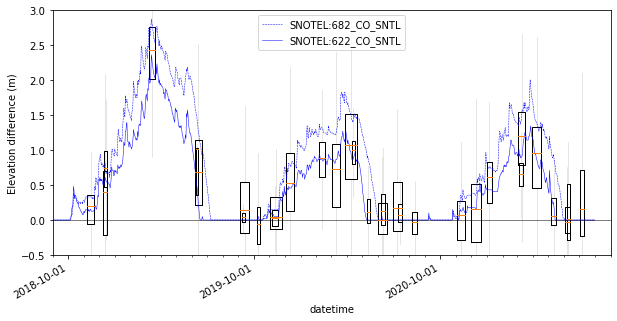

In [270]:
boxplot_date(atl06sr_crop, atl06sr_diff_col, clim=(-0.5, 3.0))

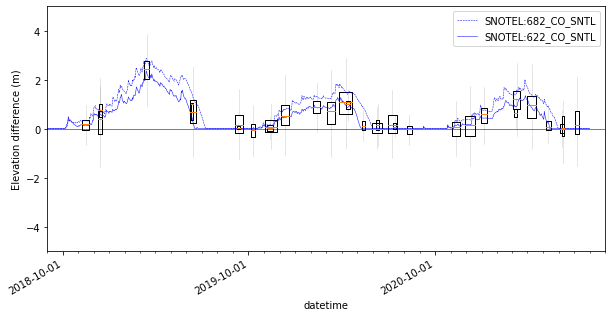

In [262]:
boxplot_date(atl06sr_crop, atl06sr_diff_col)

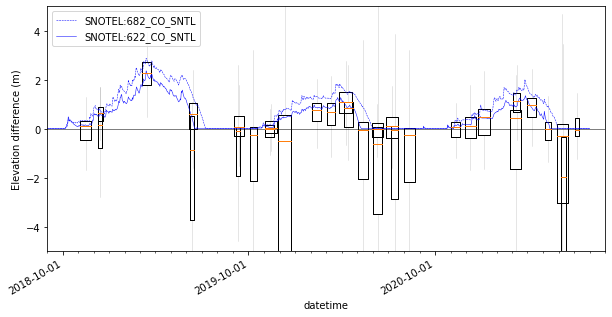

In [267]:
boxplot_date(atl08_crop, atl08_diff_col)

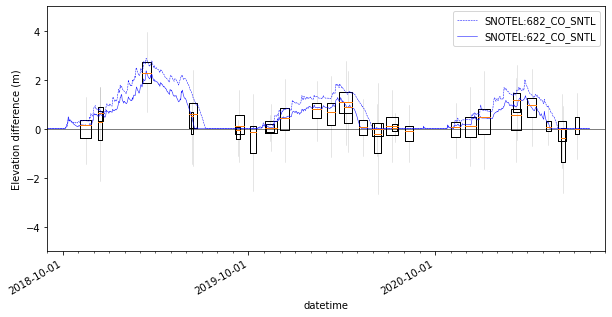

In [266]:
boxplot_date(atl08_crop[atl08_nphoton_idx], atl08_diff_col)

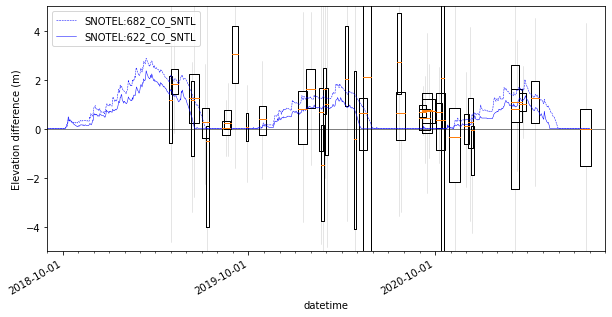

In [268]:
boxplot_date(gedi_crop, gedi_diff_col)

In [316]:
cl_fn = '/nobackup/deshean/gm_classification/27nov2010_tree_map_final_fix_4x.tif'

In [317]:
cl_src = rio.open(cl_fn)

In [318]:
col = sample_raster(atl08_crop, cl_src)

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [319]:
idx = atl08_crop[col] == 1

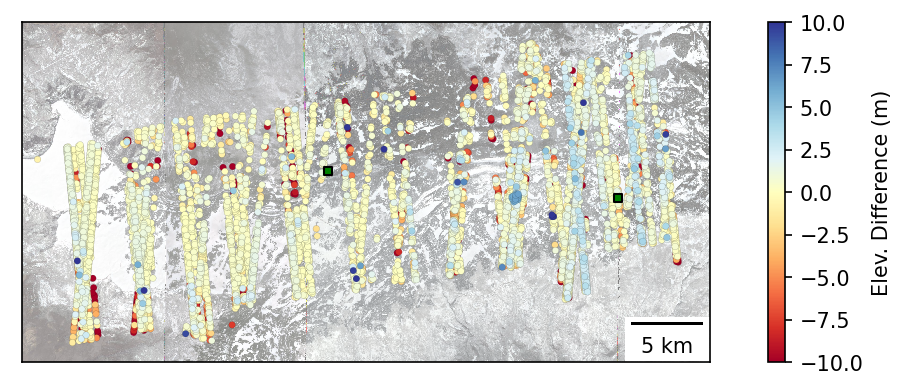

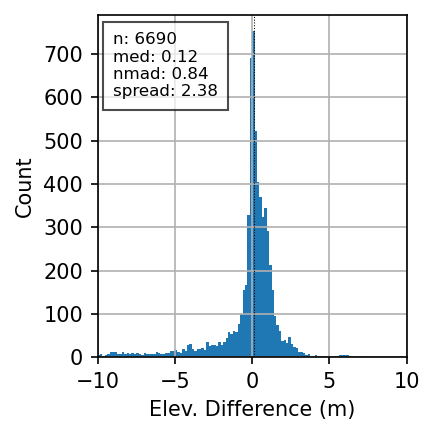

In [320]:
xover_plot2(atl08_crop[~idx], atl08_diff_col)

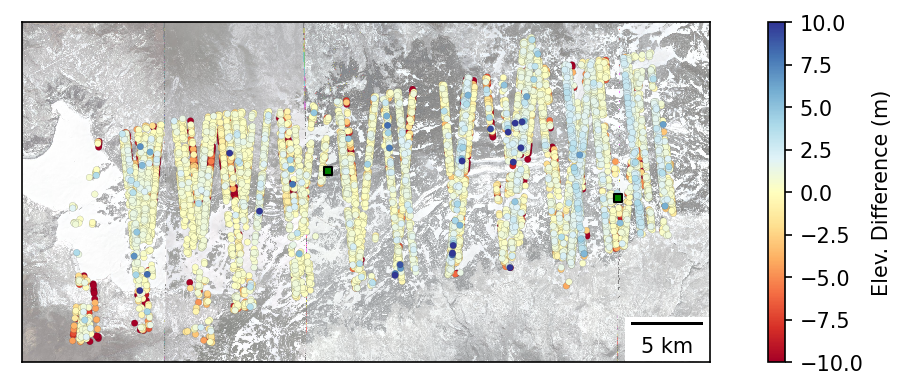

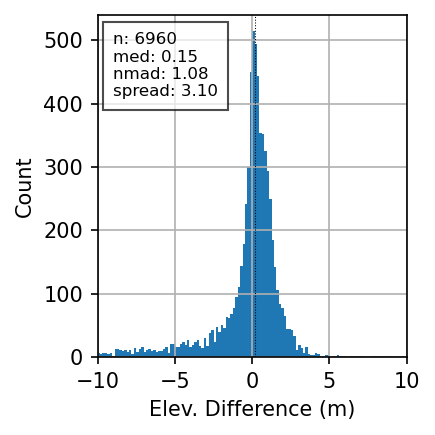

In [321]:
xover_plot2(atl08_crop[idx], atl08_diff_col)

In [322]:
cl_fn = './GM_combine_3trees_3aso_matrix.tif'

In [323]:
cl_src = rio.open(cl_fn)

In [194]:
gdaldem_fn = os.path.splitext(dem_fn)[0]+f'_slope.tif'
gdaldem_src = rio.open(gdaldem_fn)
gdaldem = gdaldem_src.read(1, masked=True)

In [ ]:
f, ax = plt.subplots(figsize=(6,3))
m = ax.imshow(gdaldem, vmin=0, vmax=40)
f.colorbar(m)

In [359]:
slope = rioxarray.open_rasterio(gdaldem_fn, masked=True).squeeze()
clmatrix = rioxarray.open_rasterio(cl_fn, masked=True).squeeze()

In [360]:
clmatrix

<xarray.DataArray (y: 6500, x: 12450)>
[80925000 values with dtype=float32]
Coordinates:
    band         int64 1
  * x            (x) float64 2.183e+05 2.183e+05 ... 2.557e+05 2.557e+05
  * y            (y) float64 4.336e+06 4.336e+06 ... 4.317e+06 4.317e+06
    spatial_ref  int64 0
Attributes:
    LAYER_TYPE:              athematic
    STATISTICS_MAXIMUM:      9
    STATISTICS_MEAN:         7.2166037518148
    STATISTICS_MEDIAN:       0
    STATISTICS_MINIMUM:      1
    STATISTICS_MODE:         0
    STATISTICS_SKIPFACTORX:  1
    STATISTICS_SKIPFACTORY:  1
    STATISTICS_STDDEV:       2.3092850623765
    scale_factor:            1.0
    add_offset:              0.0
    long_name:               Layer_1

In [350]:
#ds.rename({'band':'slope'})

In [324]:
col = sample_raster(atl08_crop, cl_src)

/nobackupp16/swbuild/deshean/miniconda3/envs/shean_py3/lib/python3.9/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [331]:
treeless = [1,2,3]
sparse = [4,5,6]
dense = [7,8,9]

In [337]:
atl08_crop[col].value_counts()

9.0    5002
8.0    1940
6.0    1414
7.0     615
5.0     419
4.0     372
2.0     320
3.0     312
1.0     295
Name: GM_combine_3trees_3aso_matrix, dtype: int64

In [332]:
idx = atl08_crop[col].isin(treeless)

In [333]:
idx.value_counts()

False    48064
True       927
Name: GM_combine_3trees_3aso_matrix, dtype: int64

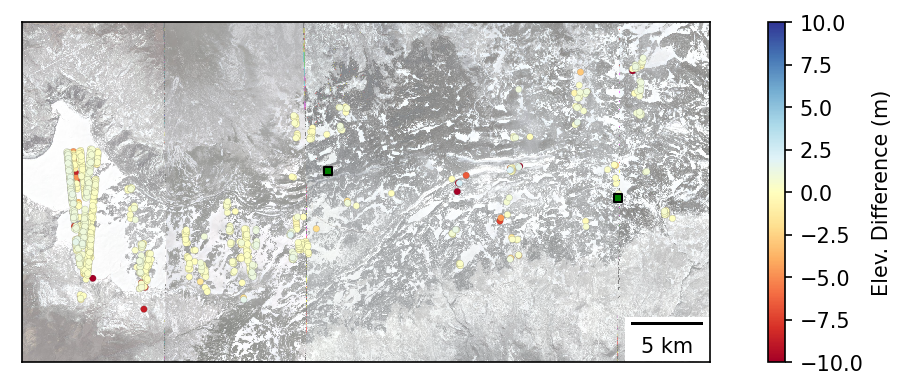

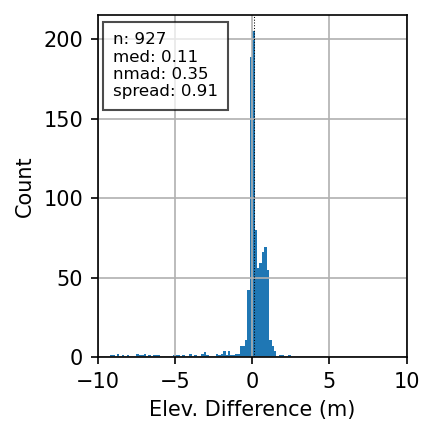

In [334]:
xover_plot2(atl08_crop[idx], atl08_diff_col)

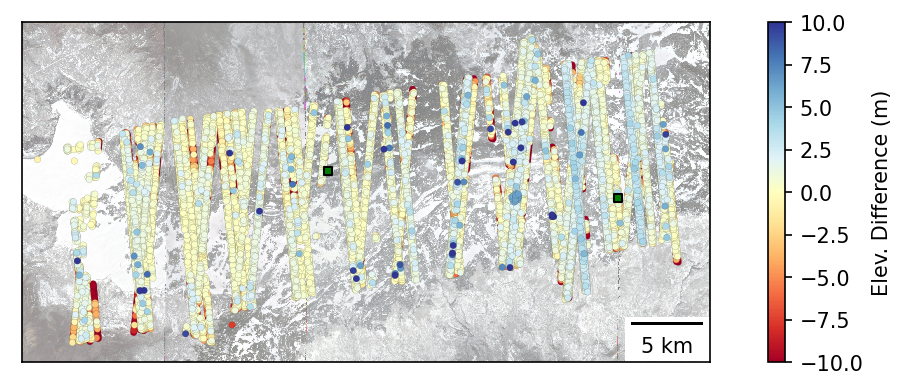

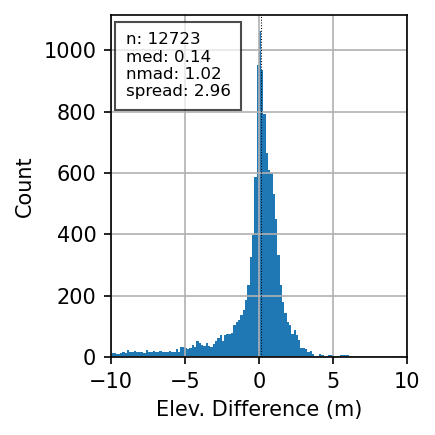

In [335]:
xover_plot2(atl08_crop[~idx], atl08_diff_col)

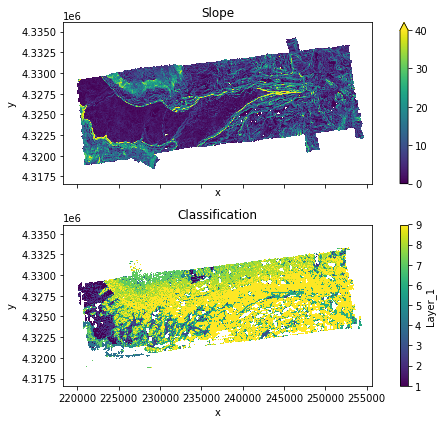

In [364]:
f, axa = plt.subplots(2, 1, figsize=(8,6), sharex=True, sharey=True)
slope.plot.imshow(ax=axa[0], vmin=0, vmax=40)
axa[0].axes.set_aspect('equal')
axa[0].set_title('Slope')
clmatrix.plot.imshow(ax=axa[1], vmin=1, vmax=9)
axa[1].axes.set_aspect('equal')
axa[1].set_title('Classification')
plt.tight_layout()

In [368]:
clmatrix_cp = clmatrix.copy()

In [372]:
clmatrix_cp

<xarray.DataArray (y: 6500, x: 12450)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)
Coordinates:
    band         int64 1
  * x            (x) float64 2.183e+05 2.183e+05 ... 2.557e+05 2.557e+05
  * y            (y) float64 4.336e+06 4.336e+06 ... 4.317e+06 4.317e+06
    spatial_ref  int64 0
Attributes:
    LAYER_TYPE:              athematic
    STATISTICS_MAXIMUM:      9
    STATISTICS_MEAN:         7.2166037518148
    STATISTICS_MEDIAN:       0
    STATISTICS_MINIMUM:      1
    STATISTICS_MODE:         0
    STATISTICS_SKIPFACTORX:  1
    STATISTICS_SKIPFACTORY:  1
    STATISTICS_STDDEV:       2.3092850623765
    scale_factor:            1.0
    add_offset:              0.0
    long_name:               Layer_1

In [370]:
clmatrix.isin(treeless)

<xarray.DataArray (y: 6500, x: 12450)>
array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])
Coordinates:
    band         int64 1
  * x            (x) float64 2.183e+05 2.183e+05 ... 2.557e+05 2.557e+05
  * y            (y) float64 4.336e+06 4.336e+06 ... 4.317e+06 4.317e+06
    spatial_ref  int64 0

In [375]:
clmatrix_cp.sel[clmatrix.isin(treeless)]

TypeError: 'method' object is not subscriptable

In [381]:
clmatrix_cp.where(clmatrix.isin(treeless))

<xarray.DataArray (y: 6500, x: 12450)>
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)
Coordinates:
    band         int64 1
  * x            (x) float64 2.183e+05 2.183e+05 ... 2.557e+05 2.557e+05
  * y            (y) float64 4.336e+06 4.336e+06 ... 4.317e+06 4.317e+06
    spatial_ref  int64 0
Attributes:
    LAYER_TYPE:              athematic
    STATISTICS_MAXIMUM:      9
    STATISTICS_MEAN:         7.2166037518148
    STATISTICS_MEDIAN:       0
    STATISTICS_MINIMUM:      1
    STATISTICS_MODE:         0
    STATISTICS_SKIPFACTORX:  1
    STATISTICS_SKIPFACTORY:  1
    STATISTICS_STDDEV:       2.3092850623765
    scale_factor:            1.0
    add_offset:              0.0
    long_name:               Layer_1